In [37]:
!nvidia-smi

Mon Jul 15 17:00:07 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 546.92                 Driver Version: 546.92       CUDA Version: 12.3     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                     TCC/WDDM  | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA GeForce RTX 4080 ...  WDDM  | 00000000:01:00.0  On |                  N/A |
| N/A   60C    P0              53W / 121W |  11306MiB / 12282MiB |    100%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [38]:
# Import relevant modules

# Import modules for vector calculations
import numpy as np
import scipy as sp
import pandas as pd
import scipy.linalg as la
import scipy.optimize as opt

# Import modules for plotting
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib as mpl
import matplotlib.cm as cm
import matplotlib.colors as colors
import matplotlib.colorbar as colorbar
%matplotlib inline

# Import modules for file handling 
import os
import io
import sys
import warnings
warnings.filterwarnings('ignore')
from glob import glob
from tifffile import imread, imsave
from skimage import io, measure
import time

# Import modules for Deep Learning
import torch as torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import torchvision.transforms as transforms
import torch.utils.data as data
from torch.utils.data import DataLoader
import pytorch_lightning as pl
from pytorch_lightning import Trainer
from torchsummary import summary
from pytorch_lightning.callbacks import ModelCheckpoint, EarlyStopping, LearningRateMonitor
torch.set_float32_matmul_precision("medium|high")

# Import custom modules
from OriginalGAPUNet import UNet
from AttentionUNetArchitectureSaveMe import AttentionUNet
from BinomDataset2 import BinomDataset

In [39]:
def PSNR(original, transformed, maximum):
    mse = np.mean((original-transformed)**2)
    if mse == 0:
        return 100
    max_pixel_value = maximum
    psnr = 20 * np.log10(max_pixel_value/np.sqrt(mse))
    return psnr

In [40]:
def sample_imaging(input_image,
                 model,
                 max_photons = None,
                 max_its = 500000,
                 max_psnr = -15,
                 save_every_n = 5,
                 beta = 0.1
                ):

    start = input_image.clone()
    photons = start
    photnum = 1

    denoised = None
    stack = []
    
    sumDenoised = start
    region = 64
    
    for i in range(max_its):
        #print("index",i)
        # compute the pseudo PSNR
        psnr = np.log10(photons.mean().item() + 1e-50) * 10
        psnr = max(-40, psnr)
        Psnr = torch.FloatTensor([psnr]).to(device)
        Psnr_map = Psnr.unsqueeze(-1).unsqueeze(-1).expand(input_image.shape).type(torch.float32)
        
            
        if (max_photons is not None) and (photons.sum().item() > max_photons):
            break
            
        if psnr > max_psnr:
            break
    
        #print(photons.shape)
        denoised = model(photons, psnr).detach()
        #print(denoised.shape)
        denoised = denoised - denoised.max()
        denoised = torch.exp(denoised)   
        denoised = denoised / (denoised.sum(dim=(-1,-2,-3), keepdim = True))
        

        # here we save an image into our stack
        if (save_every_n is not None) and (i%save_every_n == 0):  

            imgsave = denoised[0,0,:,...].detach().cpu()
            imgsave = imgsave/imgsave.max()
            photsave = photons[0,0,:,...].detach().cpu()
            photsave = photsave / max(photsave.max(),1)      
            combi = torch.cat((photsave,imgsave),1)
            stack.append(combi.numpy())

        # increase photon number
        photnum = max(beta* photons.sum(),1)
        
        # draw new photons
        new_photons = torch.poisson(denoised*(photnum)) 
        
        # add new photons
        photons = photons + new_photons 
        
    
    return denoised[...].detach().cpu().numpy(), photons[...].detach().cpu().numpy(), stack, i

In [41]:
# Using the GPU for computations
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [42]:
Data = np.concatenate((imread(r'trainingDataGT.tif'), imread(r'testDataGT.tif')))

KeyboardInterrupt: 

(2048, 512, 512)


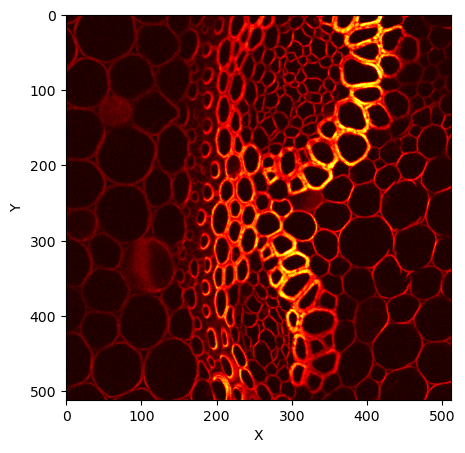

In [ ]:
# Review the Dataset
plt.figure(figsize=(5,5))
plt.imshow(Data[2000], cmap='hot')
print(Data.shape)
plt.xlabel("X")
plt.ylabel("Y")
plt.show()

In [ ]:
def psnrToString(inp):
    if inp < 0:
        return "m"+str(-inp)
    else:
        return str(inp)
    
# We set the pseudo PSNR range used for splitting the images into input and target
minpsnr = -40
maxpsnr = -5

name = psnrToString(minpsnr) + "to" + psnrToString(maxpsnr) + "-256x256"
CHECKPOINT_PATH = "./models/" 

In [ ]:
Train_Psnr_Distribution = torch.randint(torch.tensor([minpsnr]), torch.tensor([maxpsnr]), (round(Data.shape[0]*0.8),))
len(Train_Psnr_Distribution)

1638

In [ ]:
Valid_Psnr_Distribution = torch.randint(torch.tensor([minpsnr]), torch.tensor([maxpsnr]), (round(Data.shape[0]*0.2,),))
len(Valid_Psnr_Distribution)

410

In [ ]:
maxepochs = 20 # Train for longeer if needed

# Create the pytorch dataset
Train_Dataset = BinomDataset(Data[:round(Data.shape[0]*0.8)], 1, 256, minpsnr, maxpsnr, virtSize= 512 *32)
Valid_Dataset = BinomDataset(Data[round(Data.shape[0]*0.8):], 1, 256, minpsnr, maxpsnr)

# Create the Dataloaders for the training and validation sets
Train_Loader = DataLoader(Train_Dataset, batch_size = 32, shuffle = True, drop_last = True, pin_memory=False)
Validation_Loader = DataLoader(Valid_Dataset, batch_size = 32, shuffle = False, drop_last = True, pin_memory=False)

img_input, psnr_map, target_img  = next(iter(Train_Loader))
print("Image Input: ",img_input.shape)
print("Psnr_Map", psnr_map.shape)
print("target_img", target_img.shape)

# Define the callbacks for the model training and validation.
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=10, verbose=True, mode='min')
lr_monitor = LearningRateMonitor(logging_interval='step')
checkpoint_callback = ModelCheckpoint(monitor='val_loss', save_top_k=1, mode='min', verbose=True)


# Create the U-net model
in_channels = 1
intermediary_channels = 2
out_channels = 1
levels = 10
depth = 6
start_filts = 28
up_mode = 'transpose'
embedding_dim = 64

#Model = UNet(channels = in_channels, levels=levels, depth=depth,
                #start_filts=start_filts, up_mode = up_mode).to(device)

Image Input:  torch.Size([32, 1, 256, 256])
Psnr_Map torch.Size([32, 1, 256, 256])
target_img torch.Size([32, 1, 256, 256])


In [ ]:
summary(Model, (1, 256, 256))

NameError: name 'Model' is not defined

In [ ]:
Model.forward(img_input.to(device)).shape

torch.Size([32, 1, 256, 256])

In [ ]:
name = "UNet-256x256"
CHECKPOINT_PATH = "./models/" 
Trainer = pl.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=maxepochs, 
                     callbacks=[ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_loss"),
                                LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=25)])
Trainer.fit(Model, Train_Loader, Validation_Loader)
Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
You are using a CUDA device ('NVIDIA GeForce RTX 4080 Laptop GPU') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type       | Params
------------------------------------------
0 | conv_final | Conv2d     | 29    
1 | down_convs | ModuleList | 24.1 M
2 | up_convs   | ModuleList | 9.4 M 
------------------------------------------
33.4 M    Trainable params
0         Non-trainable params
33.4 M    Total params
133.774   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=20` reached.


In [ ]:
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

In [ ]:
Trainer.test(model, Train_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    -0.3162134289741516    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.3162134289741516}]

In [ ]:
Trainer.test(model, Validation_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.21423715353012085    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.21423715353012085}]

332 0 44.3373404001294 272.0 17.0


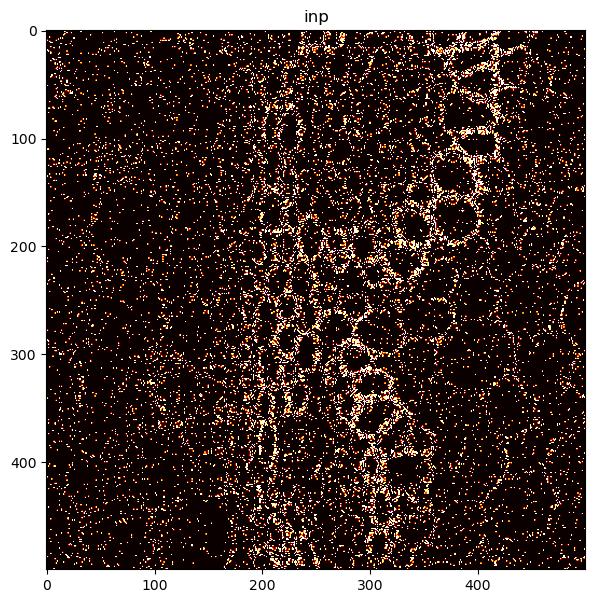

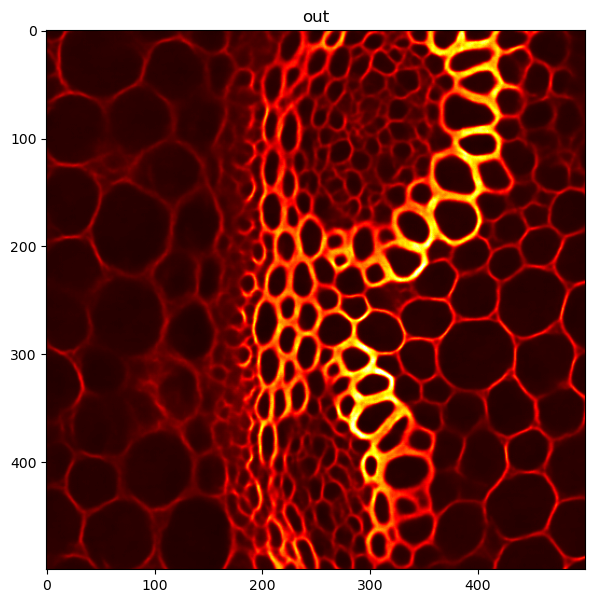

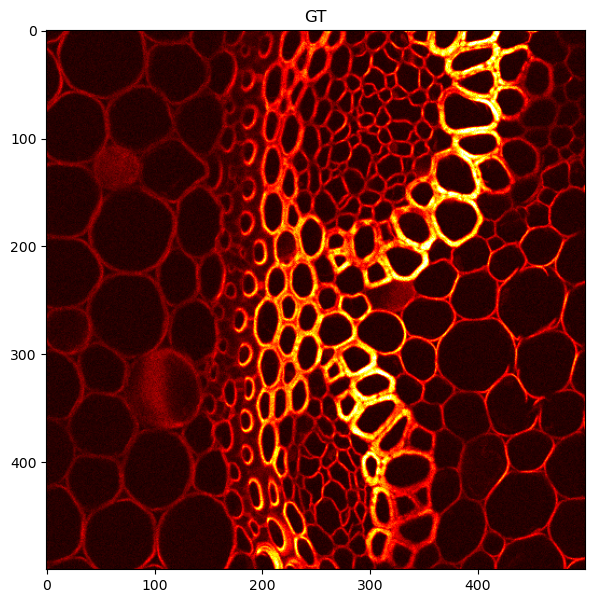

In [ ]:
dataTest = imread(r'testData.tif')[:1]     # to speed things up, we are only doing the first image
dataTestGT = imread(r'testDataGT.tif')[:1]
outputs = []
for inp, gt in zip(dataTest, dataTestGT):  
    inpT = torch.from_numpy(inp.astype(np.float32)).to(device)
    Psnr = np.log10(inpT.mean().item()+ 1e-50) *10
    Psnr = max(-40,Psnr)
    Psnr = torch.FloatTensor([Psnr]).to(device)
    Psnr_map = Psnr.unsqueeze(-1).expand(inpT.shape).type(torch.float32)
    model = model.to(device)
    # We have to apply softmax over pixels
    out = torch.exp(model(inpT[None,None,...]).detach().cpu())
    out = inp.sum() * out / out.sum()
    outputs.append(out.numpy()[0,0])
    
    print(gt.max(), gt.min(), gt.std(), np.percentile(gt,99.9), np.percentile(gt,50))
    
    inp = inp/inp.mean()
    out = out/out.mean()
    gt = gt/gt.mean()
    vmax = np.percentile(gt,99.9)
    
    plt.figure(figsize=(7,7))
    plt.imshow(inp[:500,:500],vmin = 0, vmax = vmax, cmap = "hot")
    plt.title('inp')
    plt.show()
    
    plt.figure(figsize=(7,7))
    plt.imshow(out[0,0][:500,:500],vmin = 0,vmax = vmax, cmap = "hot")
    plt.title('out')
    plt.show()
    
    plt.figure(figsize=(7,7))
    plt.imshow(gt[:500,:500],vmin = 0,vmax = vmax, cmap = "hot")
    plt.title('GT')

In [ ]:
def PSNR(original, transformed, maximum):
    mse = np.mean((original-transformed)**2)
    if mse == 0:
        return 100
    max_pixel_value = maximum
    psnr = 20 * np.log10(max_pixel_value/np.sqrt(mse))
    return psnr

In [ ]:
out[0,0][:500,:500].shape

torch.Size([500, 500])

In [ ]:
gt[:500,:500].shape

(500, 500)

In [ ]:
out[0,0][:500,:500].max()

tensor(8.9312)

In [ ]:
PSNR(out[0,0][:500,:500].detach().cpu().numpy(), gt[:500,:500], out[0,0][:500,:500].max().detach().cpu().numpy())

23.937405751611575

168


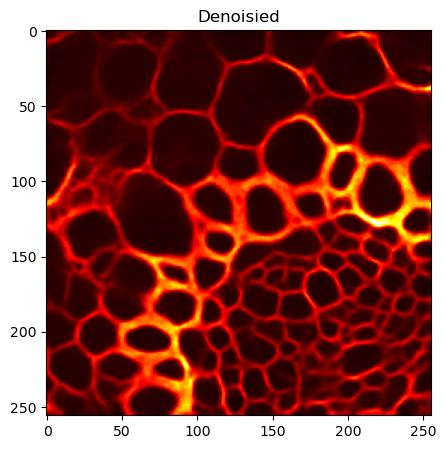

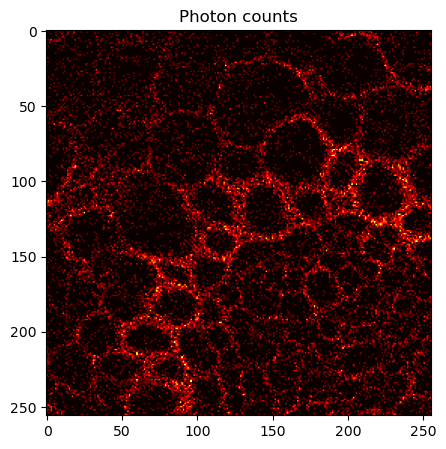

_______________________________________ 168
time (s): 1.185359239578247 time per image (s) 1.185359239578247


In [ ]:
import matplotlib.image as mpimg
import time
import numpy as np
from Inference import sample_image

# We are starting with an image containing zeros,
# i.e., sampling from scratch

# we just have 1 channel
channels = 1
# we can sample multiple images at the same time in a batch
batch_size = 1
# for best results this should correspond to training pach size
pixels_x = 256
pixels_y = 256

inp_img =  torch.zeros(batch_size ,channels, pixels_y, pixels_x).to(device)


for i in range(1):
    

    startTime = time.time()
    
    # sampling the image(s)
    #print(inp_img.shape)
    denoised, photons, stack, iterations = sample_image(inp_img,
                                                        model, 
                                                        beta = 0.05,
                                                        save_every_n = 10,
                                                        max_psnr = -5)

    
    # In case we do multiple images in a batch, we show all of them.
    for j in range(denoised.shape[0]):
            print(iterations)

            #print(denoised.shape)
            plt.figure(figsize = (5,5))
            plt.imshow(denoised[j,0], cmap='hot', vmin = 0,
                       vmax = np.percentile(denoised[j],99.99))
            plt.title('Denoisied')
            plt.show()
            
            plt.figure(figsize = (5,5))
            plt.imshow(photons[j,0], cmap='hot', vmin = 0,
                       vmax = np.percentile(photons[j],99.99))
            plt.title('Photon counts')
            plt.show()
            
            
    
    print('_______________________________________', iterations)
    
    endTime = time.time()
    elapsedTime = endTime - startTime
    print('time (s):', elapsedTime, 'time per image (s)', elapsedTime/denoised.shape[0])

0


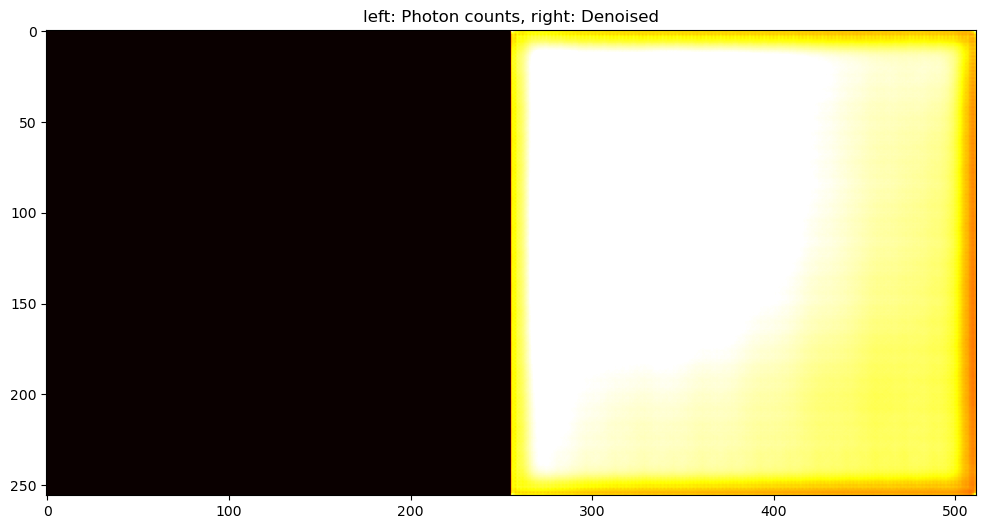

1


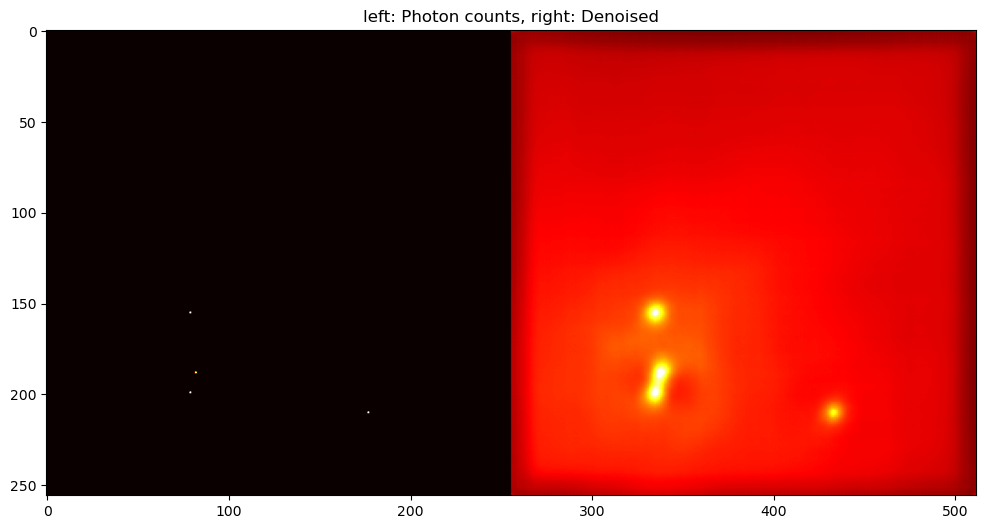

2


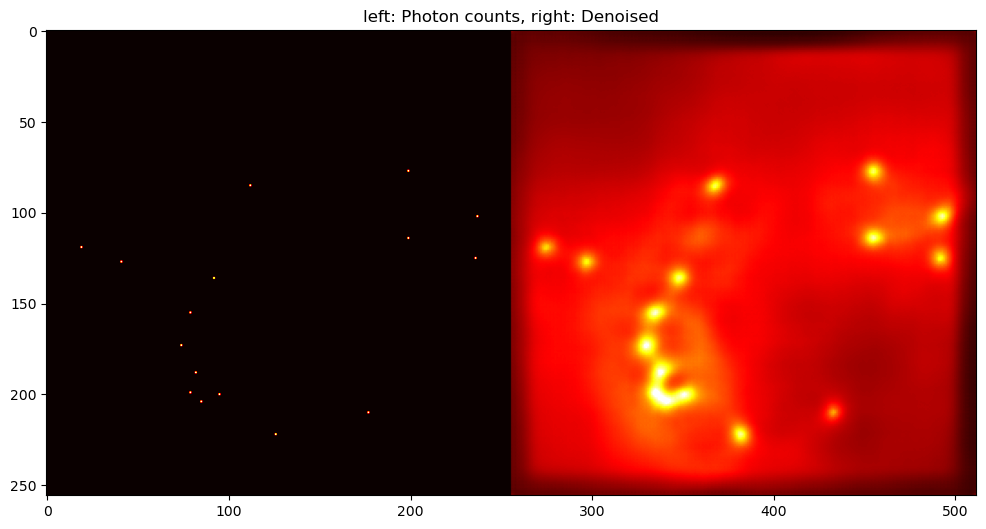

3


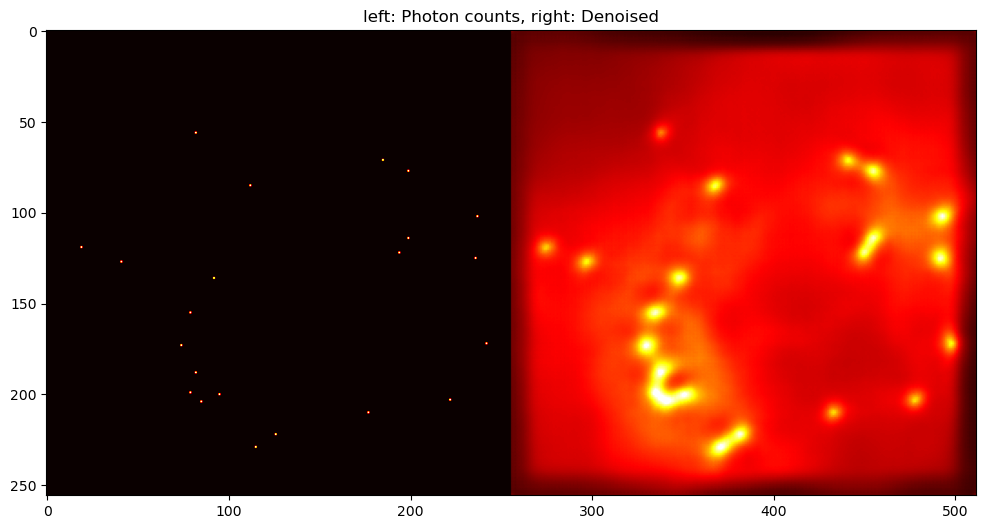

4


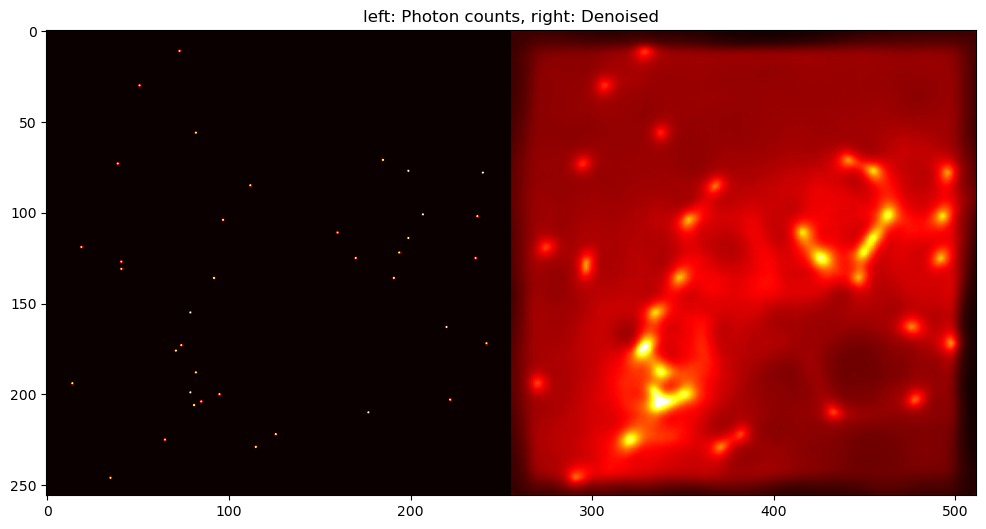

5


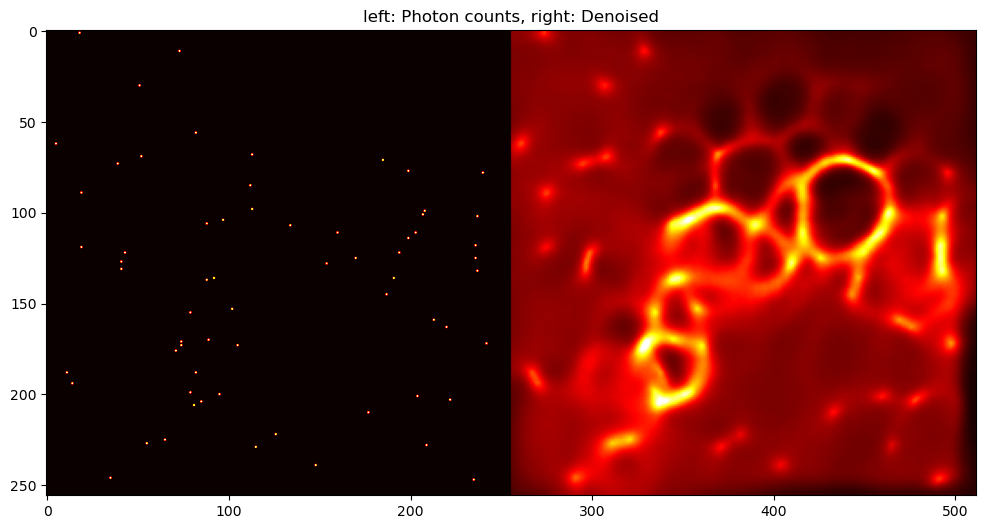

6


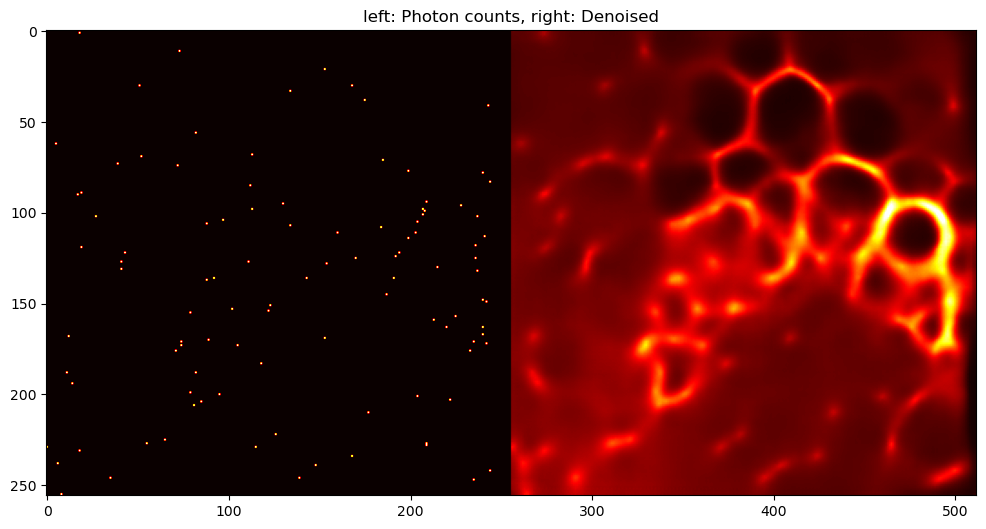

7


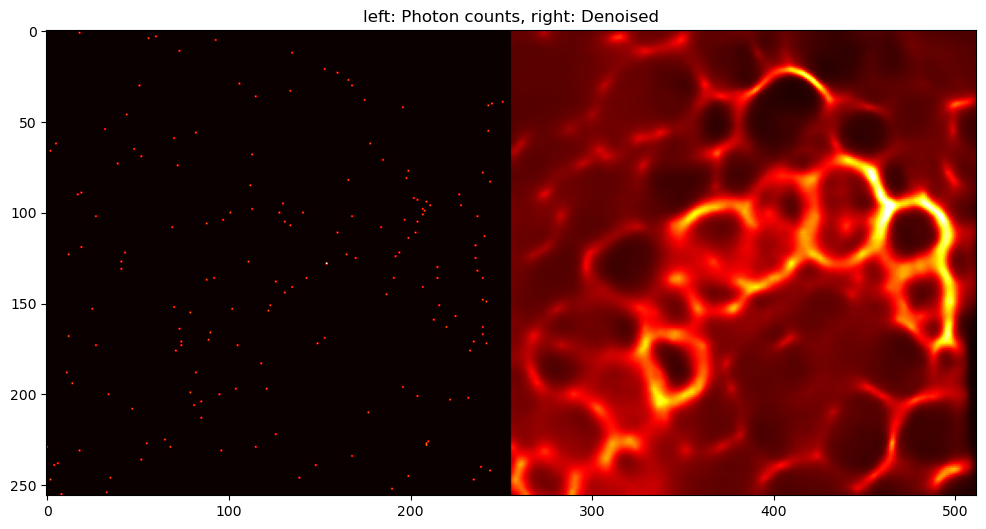

8


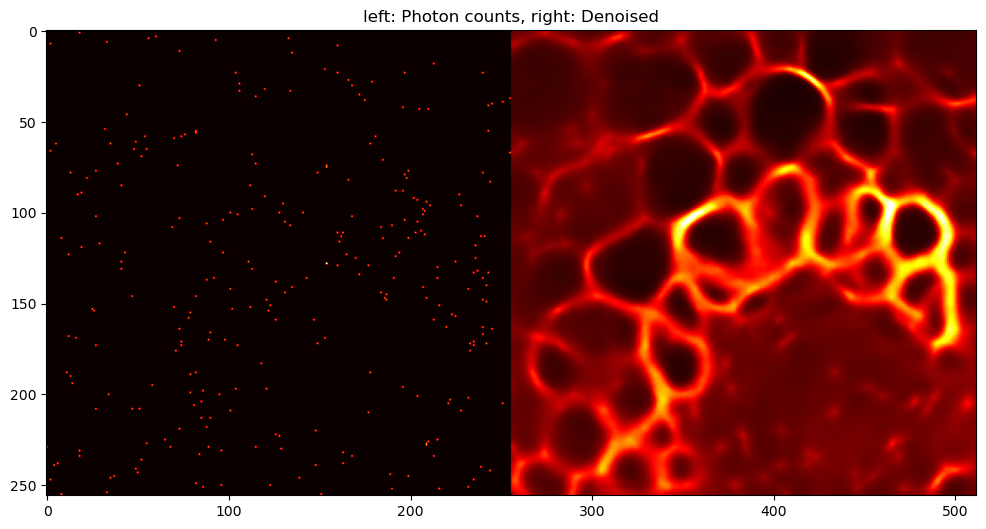

9


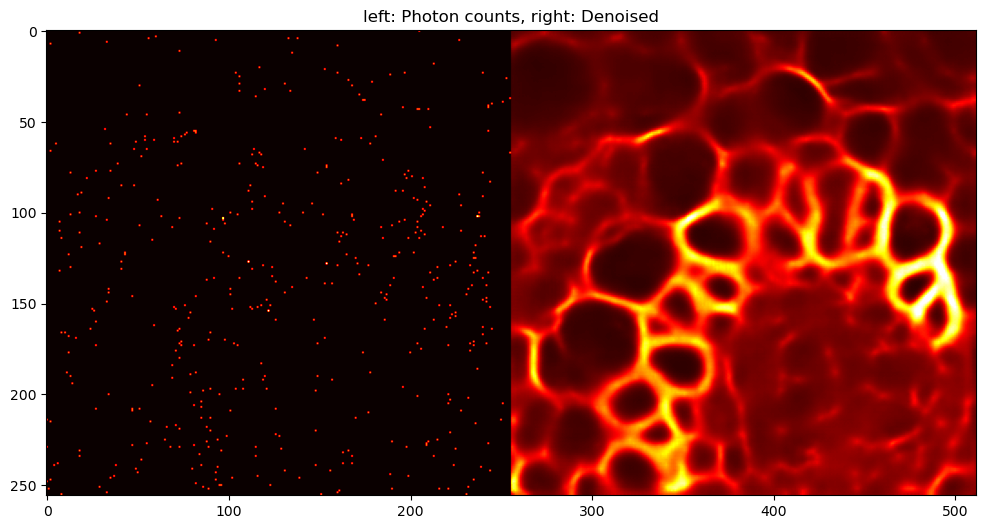

10


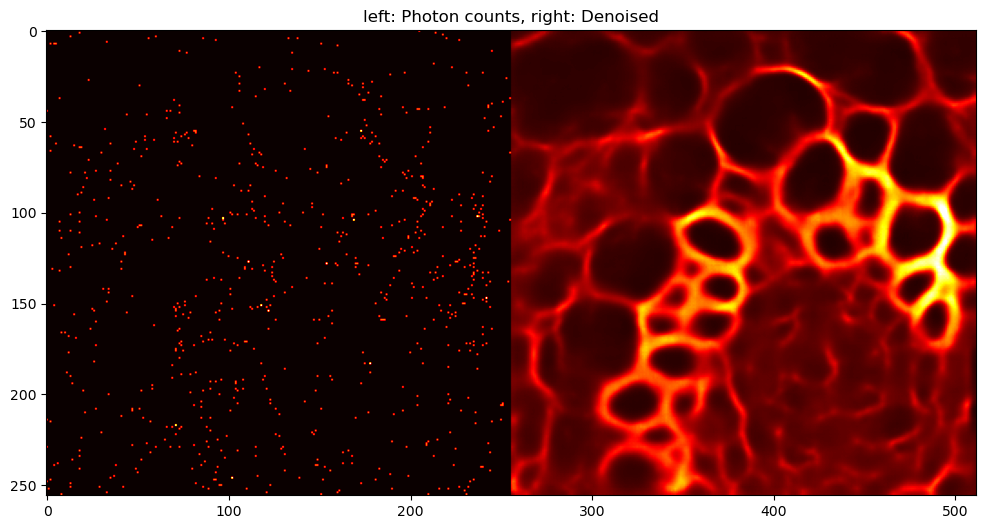

11


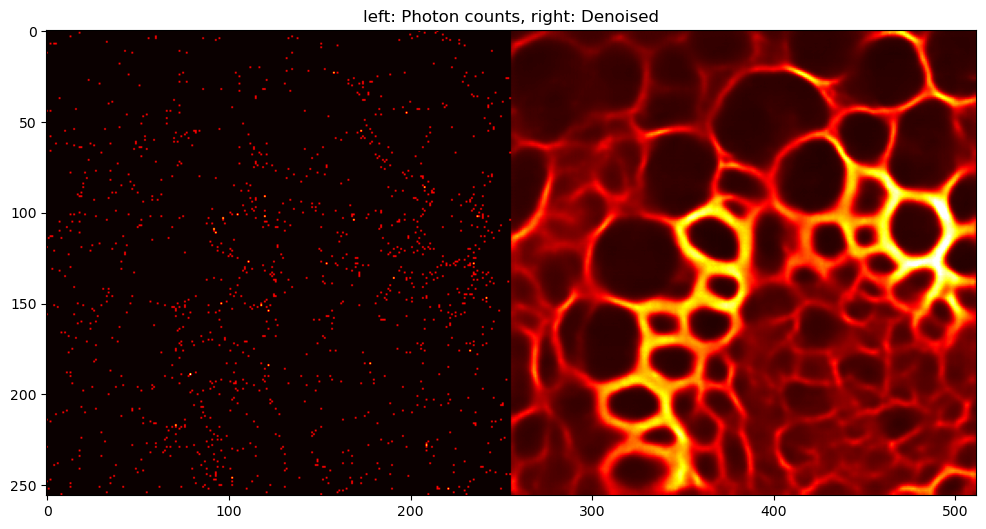

12


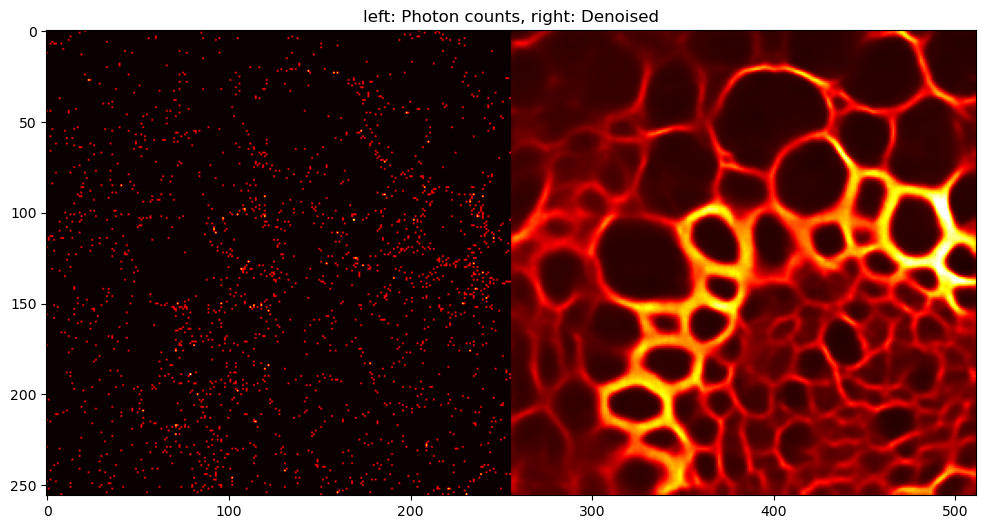

13


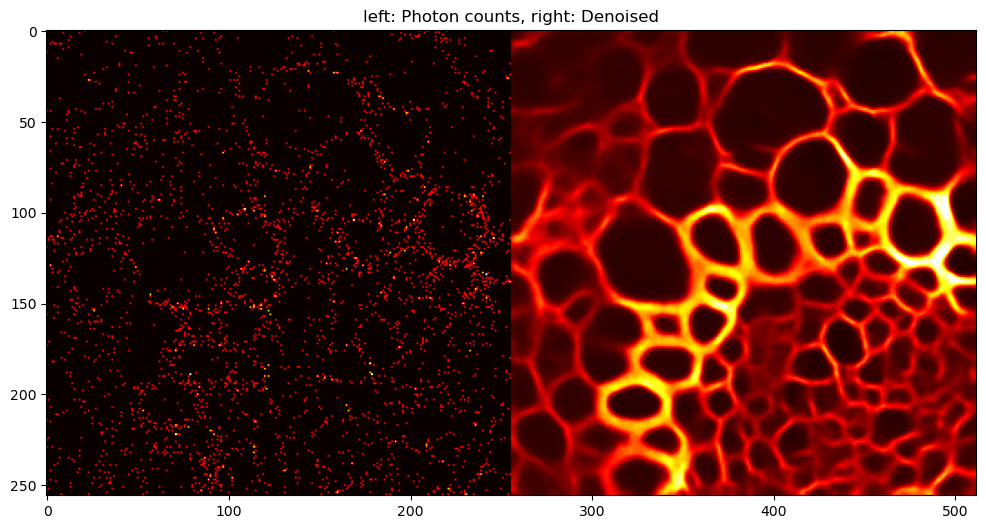

14


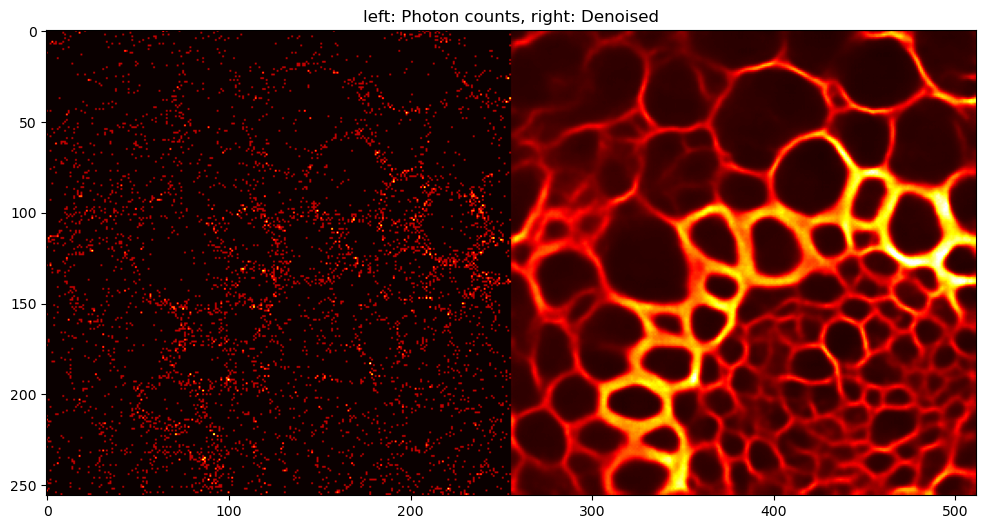

15


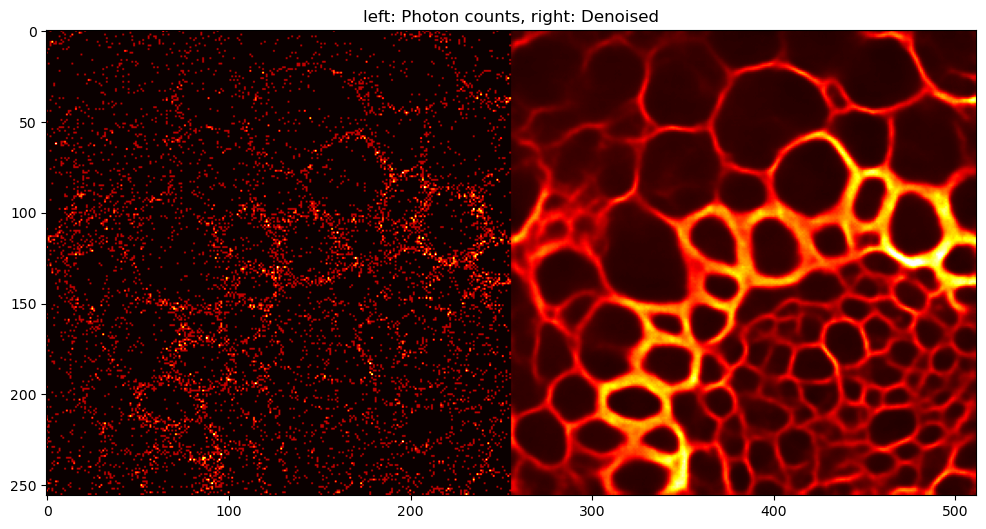

16


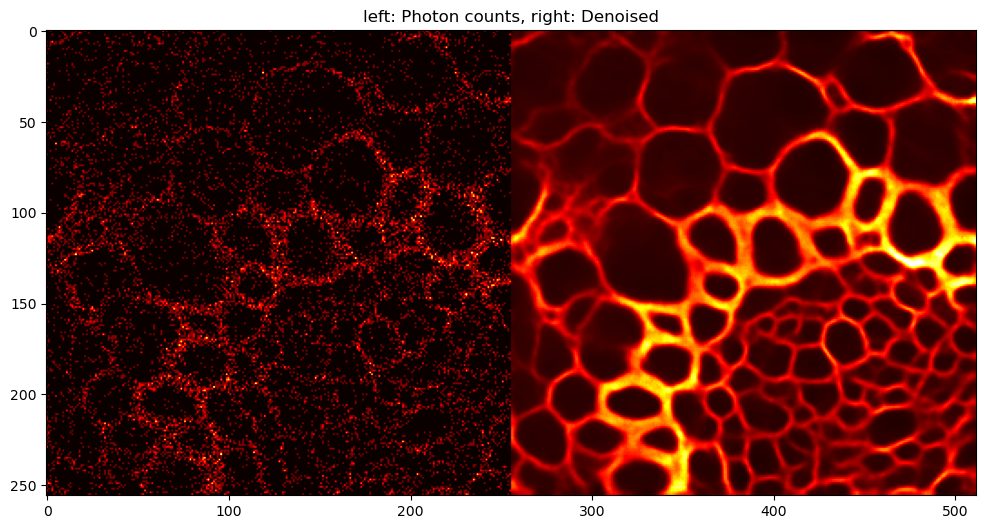

In [ ]:
stack[0].shape
for i in range(len(stack)):
    im = stack[i]
    print(i)
    plt.figure(figsize = (12,12))
    plt.imshow(im,cmap ='hot', vmax = 0.9)
    plt.title('left: Photon counts, right: Denoised')
    plt.show()

In [ ]:
# Define the Attention Unet Model

# Define the Hyperparameters of the Model:
channels = 28
initial_channels = 4
levels = 10
depth = 6
n_heads = 8
dim_k = 64
reduction_factor = 4
num_groups = 4
dropout_rate = 0.40
time_channels = 64
bottleneck_factor = 2
units = 32
bottleneck_units = 64
conv_type = "Residual_Block"
attn_type_list = [None, None, None, None, None, None, None]
merge_type = "add"
middle_attn_type = None
upsample_type = True
maxpsnr = -5.0
transpose = True
minpsnr = -40.0
num_timesteps = 1024
psnr_enabled = False
n_groups = 4

# Define the Attention Network:
AttnUNet = AttentionUNet(
        initial_channels = initial_channels,
        channels = channels,
        levels=levels,
        depth=depth,
        n_heads = n_heads,
        dim_k = dim_k,
        dropout_rate = dropout_rate,
        time_channels = time_channels,
        bottleneck_factor = bottleneck_factor,
        units = units,
        bottleneck_units= bottleneck_units,
        conv_type = conv_type,
        attn_type_list = attn_type_list,
        merge_type = merge_type,
        maxpsnr = maxpsnr,
        minpsnr = minpsnr,
        num_timesteps = num_timesteps,
        reduction_factor = reduction_factor,
        num_groups = num_groups,
        middle_attn_type = middle_attn_type,
        upsample_type = upsample_type,
        psnr_enabled = psnr_enabled,
        n_groups=n_groups
        )

In [ ]:
AttnUNet = AttnUNet.to(device)
AttnUNet

AttentionUNet(
  (Image_Projection): LazyConv2d(0, 4, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (Temporal_Embedding): Temporal_Embedder(
    (Linear_1): Linear(in_features=4, out_features=16, bias=True)
    (Linear_2): Linear(in_features=16, out_features=16, bias=True)
  )
  (input_norm): GroupNorm(4, 4, eps=1e-05, affine=True)
  (input_Swish): SiLU()
  (Final_Upsample): Up_Block(
    (Conv_Block): Residual_Block(
      (time_embedding): Linear(in_features=16, out_features=4, bias=True)
      (conv1): Conv2d(4, 4, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (conv2): Conv2d(4, 4, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (conv3): Conv2d(4, 4, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (GroupNorm_1): GroupNorm(4, 4, eps=1e-05, affine=True)
      (GroupNorm_2): GroupNorm(4, 4, eps=1e-05, affine=True)
      (dropout): Dropout(p=0.4, inplace=False)
    )
    (Upsample): ConvTranspose2d(28, 4, kernel_size=(2, 2), stride

In [ ]:
AttnUNet.forward(img_input.to(device), psnr_map.to(device).min()).shape

torch.Size([32, 1, 256, 256])

In [ ]:
name = "AttentionUNet-256x256"
CHECKPOINT_PATH = "./models/" 
Trainer = pl.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=maxepochs, 
                     callbacks=[ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_loss"),
                                LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience = 5)])
Trainer.fit(AttnUNet, Train_Loader, Validation_Loader)
Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name               | Type              | Params
----------------------------------------------------------
0  | Image_Projection   | Conv2d            | 364   
1  | Temporal_Embedding | Temporal_Embedder | 352   
2  | input_norm         | GroupNorm         | 8     
3  | input_Swish        | SiLU              | 0     
4  | Final_Upsample     | Up_Block          | 840   
5  | DownBlocks         | ModuleList        | 15.0 M
6  | MiddleBlocks       | ModuleList        | 30.5 M
7  | UpBlocks           | ModuleList        | 7.2 M 
8  | output_norm        | GroupNorm         | 56    
9  | output_Swish       | SiLU              | 0     
10 | Output_Layer       | Conv2d            | 29    
----------------------------------------------------------
52.8 M    Trainable params
0         Non-trainable 

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=20` reached.


In [ ]:
model = AttentionUNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

In [ ]:
Trainer.test(model, Train_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    -0.2923789620399475    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.2923789620399475}]

In [ ]:
Trainer.test(model, Validation_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    -0.2014710009098053    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.2014710009098053}]

332 0 44.3373404001294 272.0 17.0


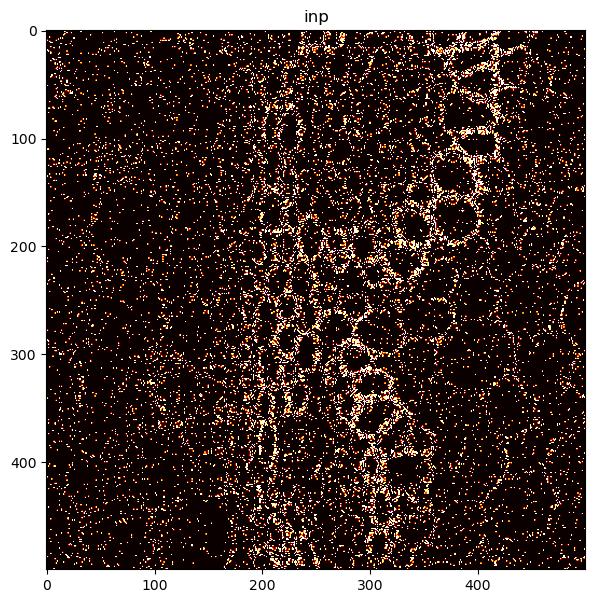

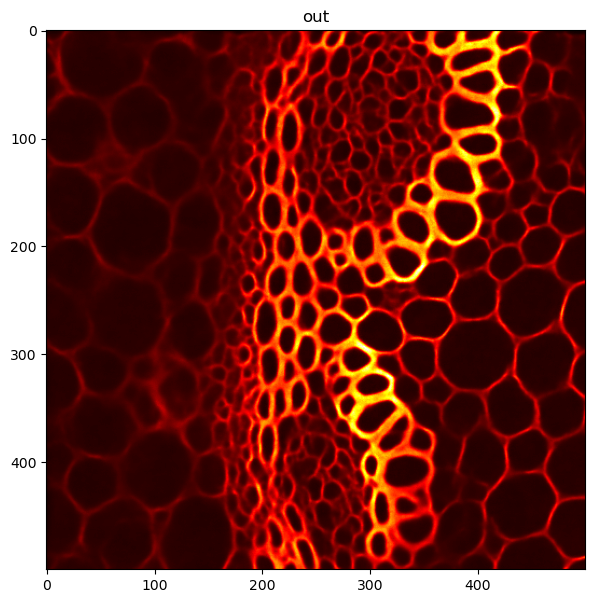

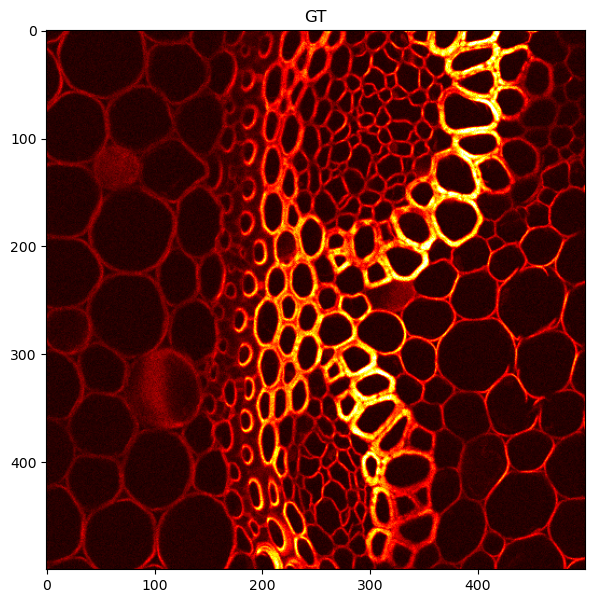

In [ ]:
outputs = []
for inp, gt in zip(dataTest, dataTestGT):  
    inpT = torch.from_numpy(inp.astype(np.float32)).to(device)
    Psnr = np.log10(inpT.mean().item()+ 1e-50) *10
    Psnr = max(-40,Psnr)
    Psnr = torch.FloatTensor([Psnr]).to(device)
    Psnr_map = Psnr.unsqueeze(-1).expand(inpT.shape).type(torch.float32)
    model = model.to(device)
    # We have to apply softmax over pixels
    out = torch.exp(model(inpT[None,None,...], Psnr_map[None, None, ...].min()).detach().cpu())
    out = inp.sum() * out / out.sum()
    outputs.append(out.numpy()[0,0])
    
    print(gt.max(), gt.min(), gt.std(), np.percentile(gt,99.9), np.percentile(gt,50))
    
    inp = inp/inp.mean()
    out = out/out.mean()
    gt = gt/gt.mean()
    vmax = np.percentile(gt,99.9)
    
    plt.figure(figsize=(7,7))
    plt.imshow(inp[:500,:500],vmin = 0, vmax = vmax, cmap = "hot")
    plt.title('inp')
    plt.show()
    
    plt.figure(figsize=(7,7))
    plt.imshow(out[0,0][:500,:500],vmin = 0,vmax = vmax, cmap = "hot")
    plt.title('out')
    plt.show()
    
    plt.figure(figsize=(7,7))
    plt.imshow(gt[:500,:500],vmin = 0,vmax = vmax, cmap = "hot")
    plt.title('GT')

In [ ]:
PSNR(out[0,0][:500,:500].detach().cpu().numpy(), gt[:500,:500], out[0,0][:500,:500].max().detach().cpu().numpy())

22.758204679516666

161


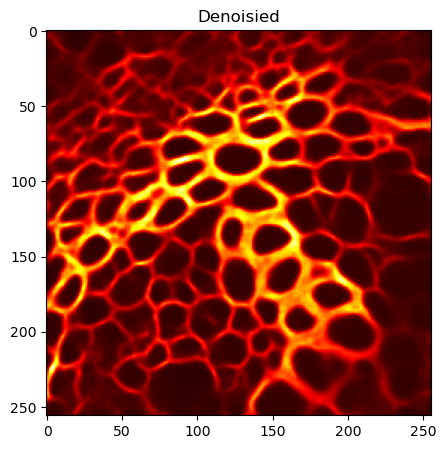

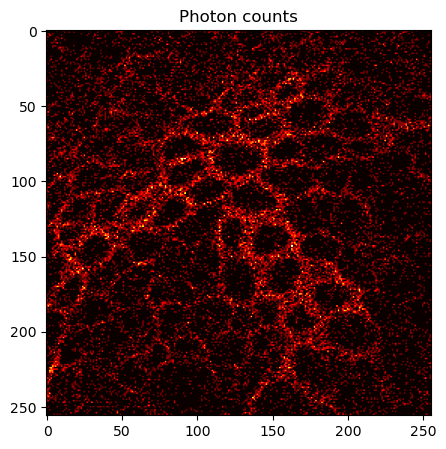

_______________________________________ 161
time (s): 1.5611774921417236 time per image (s) 1.5611774921417236


In [ ]:
import matplotlib.image as mpimg
import time
import numpy as np
from Inference import sample_image

# We are starting with an image containing zeros,
# i.e., sampling from scratch

# we just have 1 channel
channels = 1
# we can sample multiple images at the same time in a batch
batch_size = 1
# for best results this should correspond to training pach size
pixels_x = 256
pixels_y = 256

inp_img =  torch.zeros(batch_size ,channels, pixels_y, pixels_x).to(device)


for i in range(1):
    

    startTime = time.time()
    
    # sampling the image(s)
    #print(inp_img.shape)
    denoised, photons, stack, iterations = sample_imaging(inp_img,
                                                        model, 
                                                        beta = 0.05,
                                                        save_every_n = 10,
                                                        max_psnr = -5)

    
    # In case we do multiple images in a batch, we show all of them.
    for j in range(denoised.shape[0]):
            print(iterations)

            #print(denoised.shape)
            plt.figure(figsize = (5,5))
            plt.imshow(denoised[j,0], cmap='hot', vmin = 0,
                       vmax = np.percentile(denoised[j],99.99))
            plt.title('Denoisied')
            plt.show()
            
            plt.figure(figsize = (5,5))
            plt.imshow(photons[j,0], cmap='hot', vmin = 0,
                       vmax = np.percentile(photons[j],99.99))
            plt.title('Photon counts')
            plt.show()
            
            
    
    print('_______________________________________', iterations)
    
    endTime = time.time()
    elapsedTime = endTime - startTime
    print('time (s):', elapsedTime, 'time per image (s)', elapsedTime/denoised.shape[0])

0


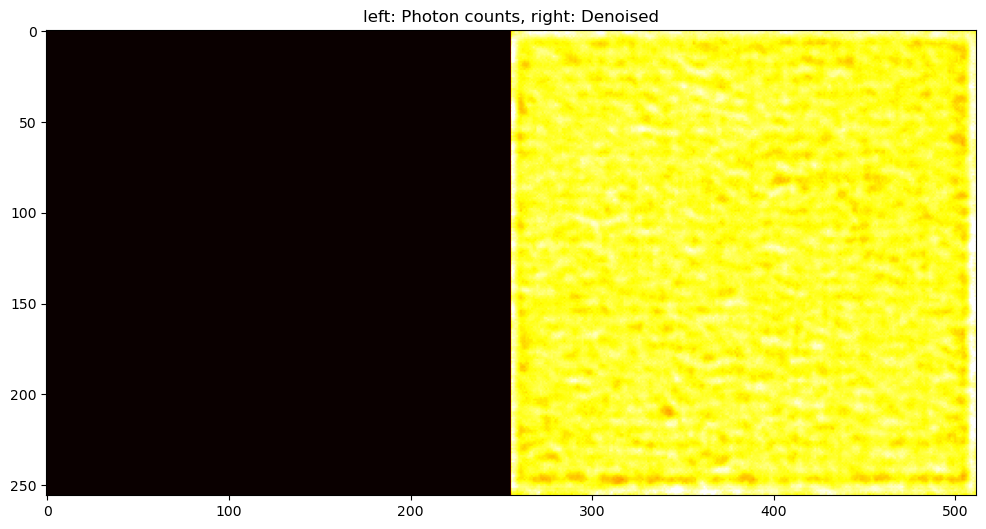

1


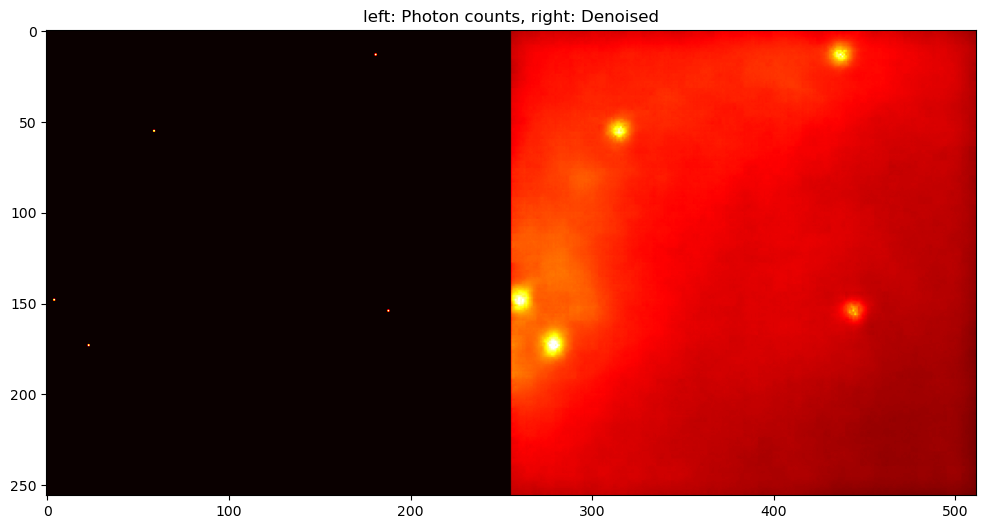

2


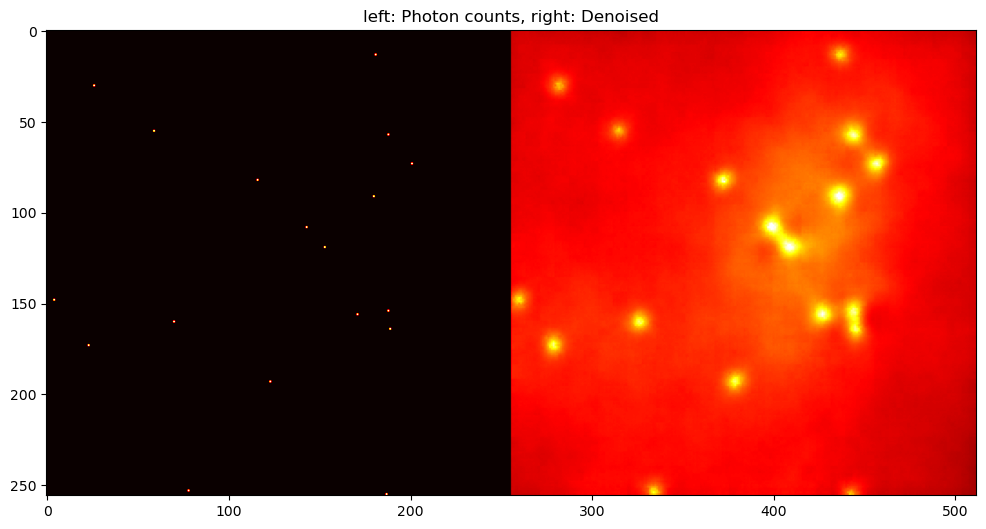

3


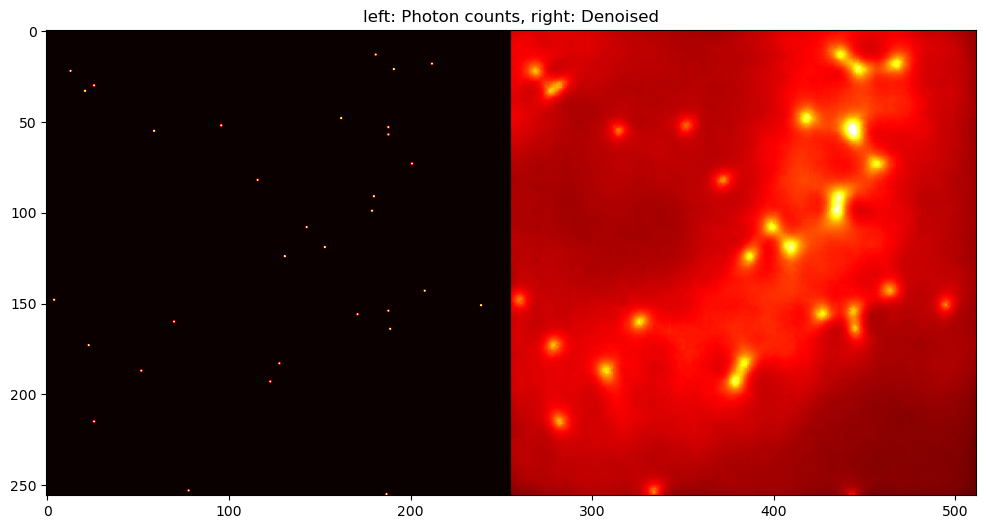

4


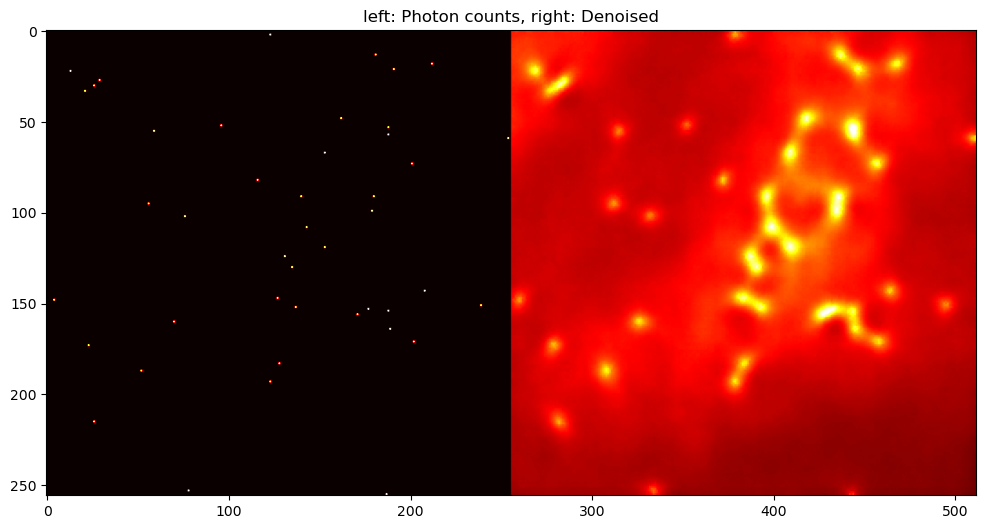

5


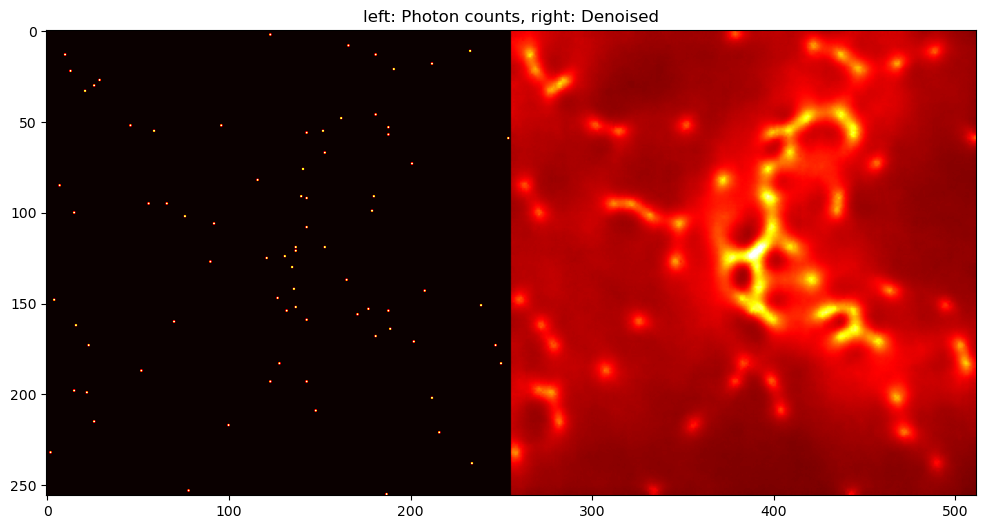

6


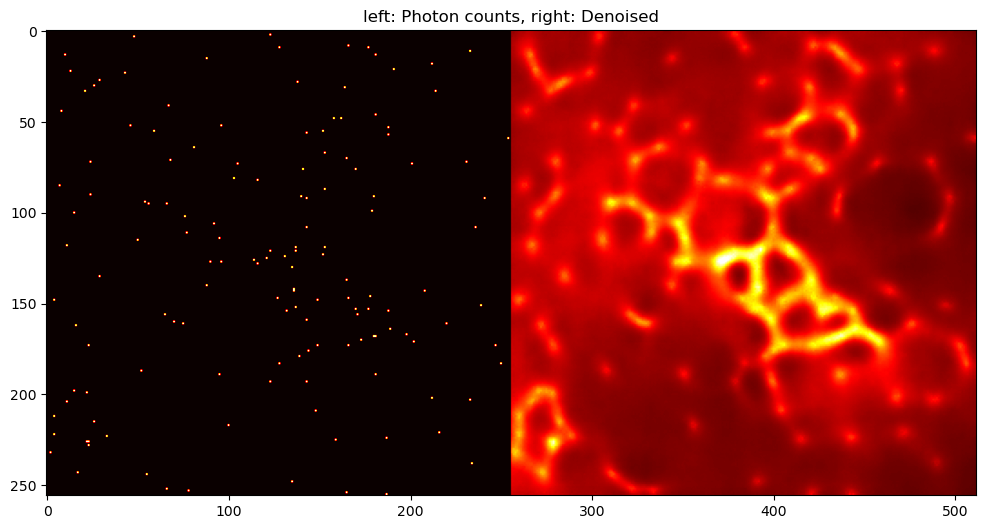

7


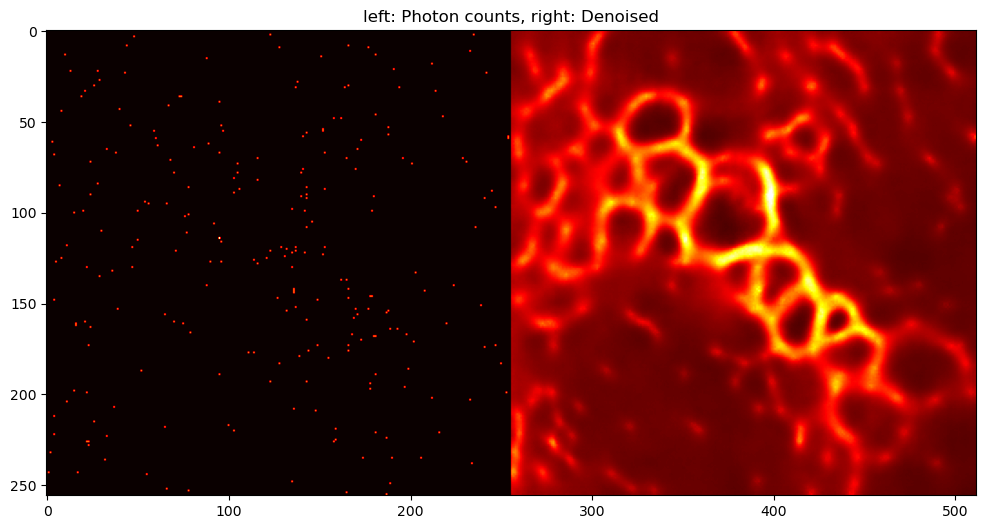

8


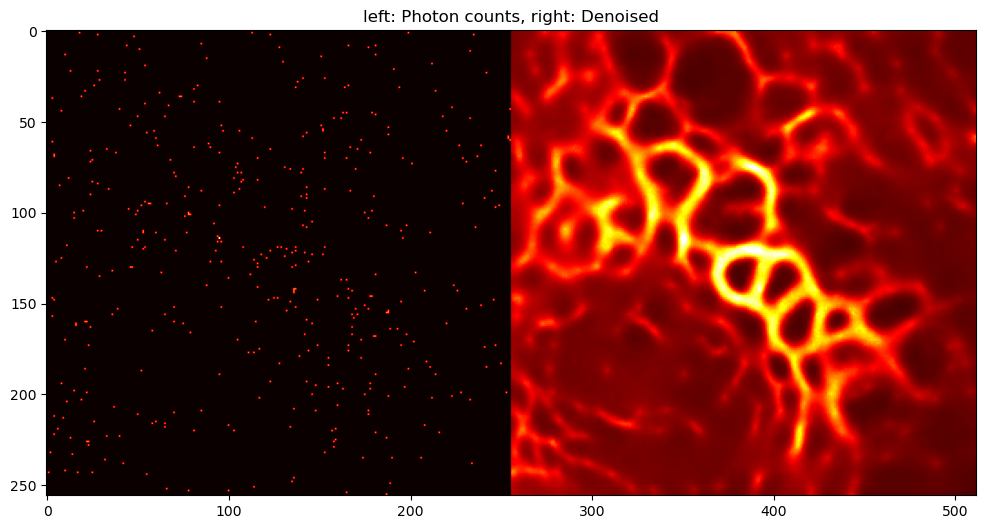

9


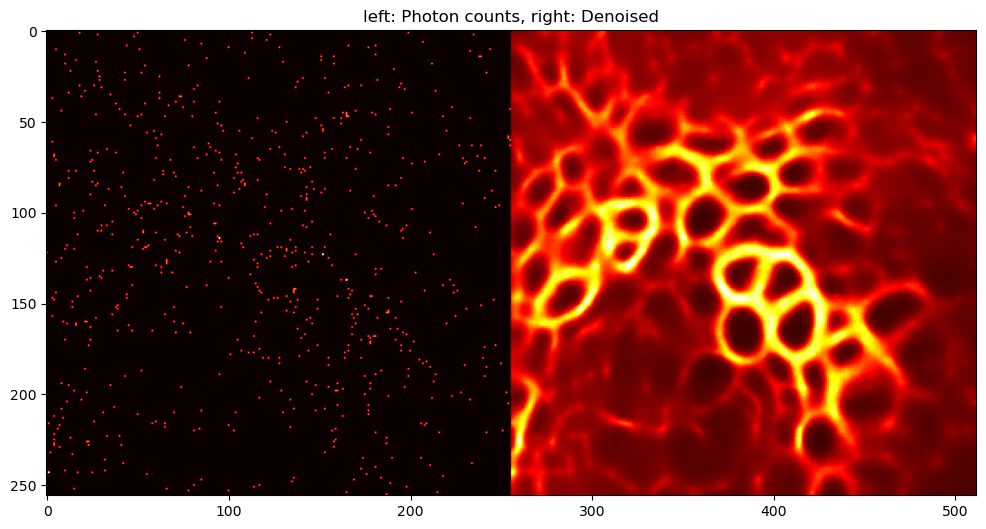

10


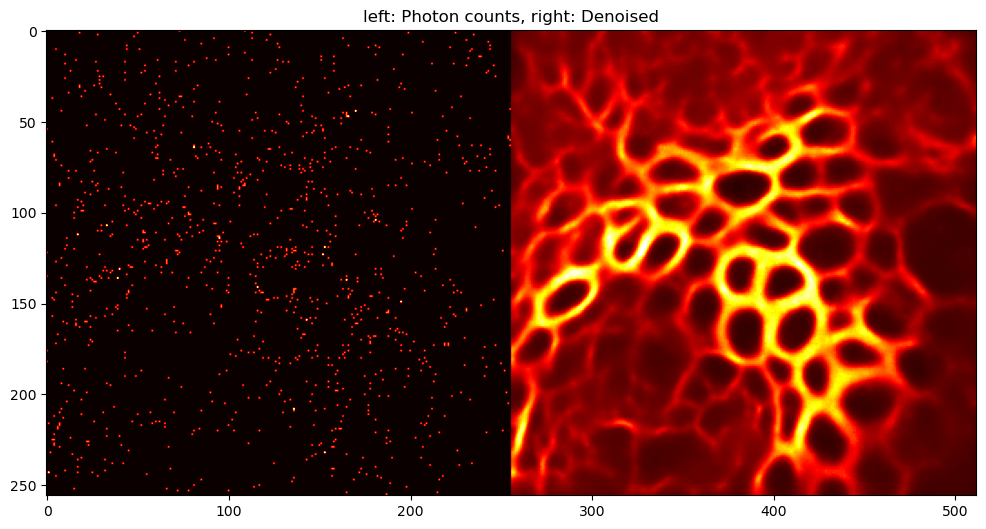

11


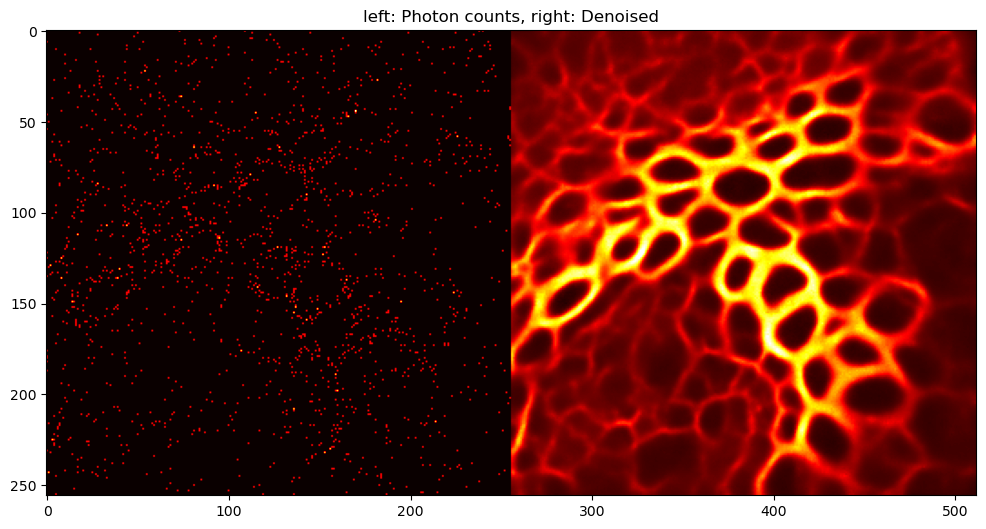

12


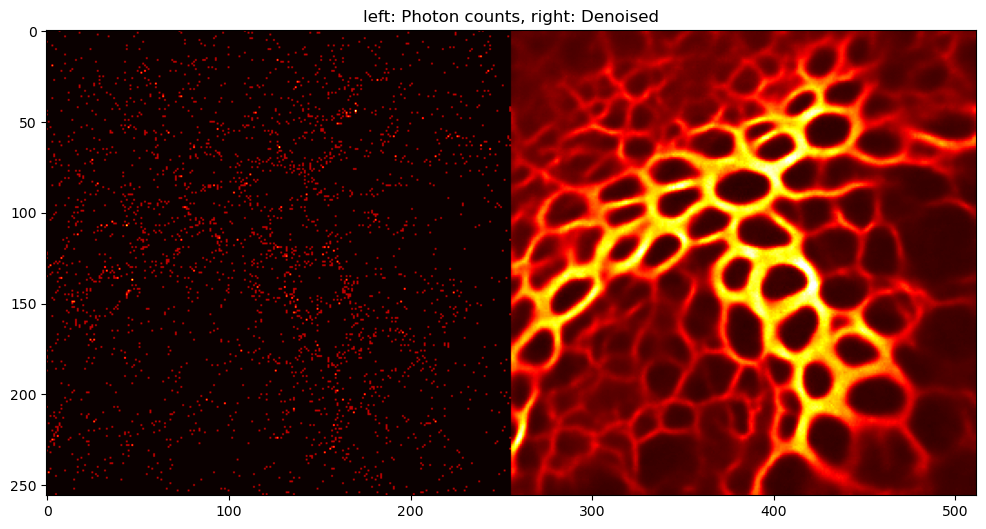

13


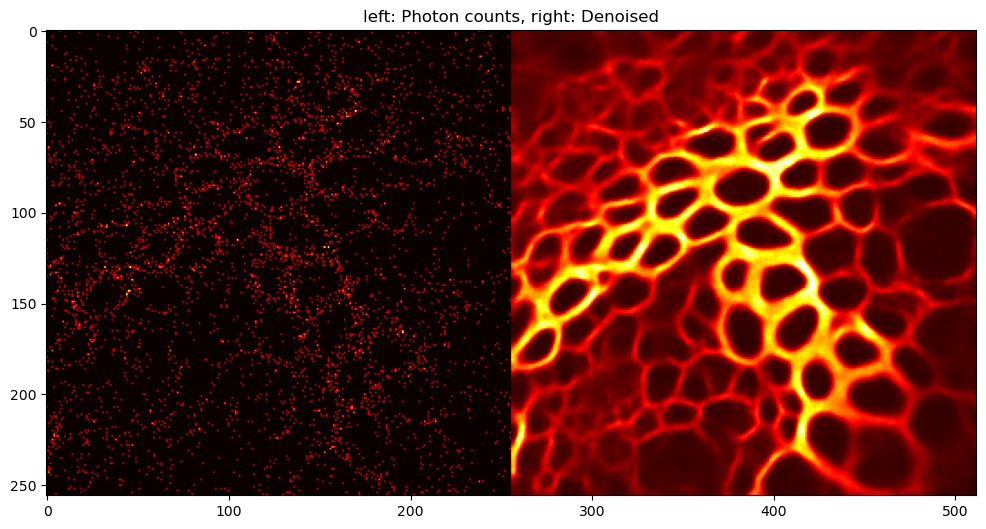

14


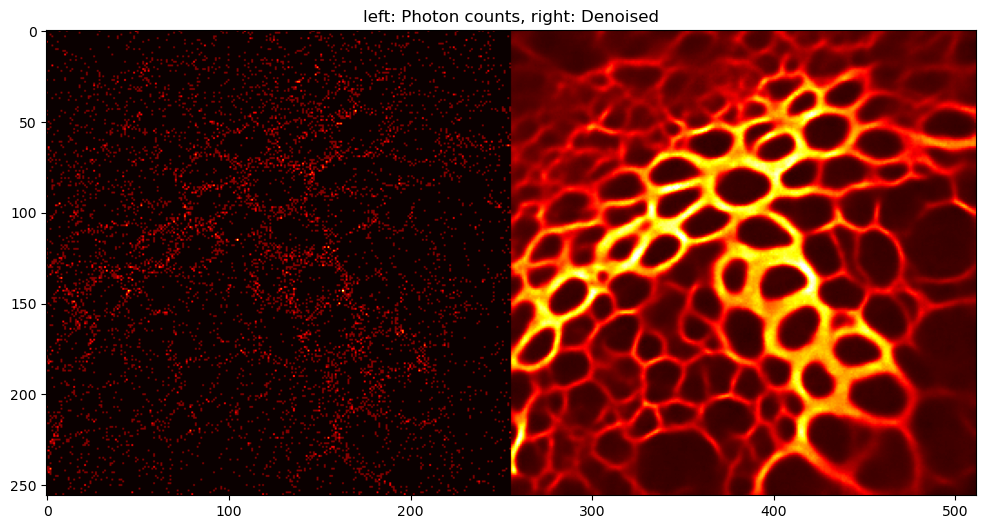

15


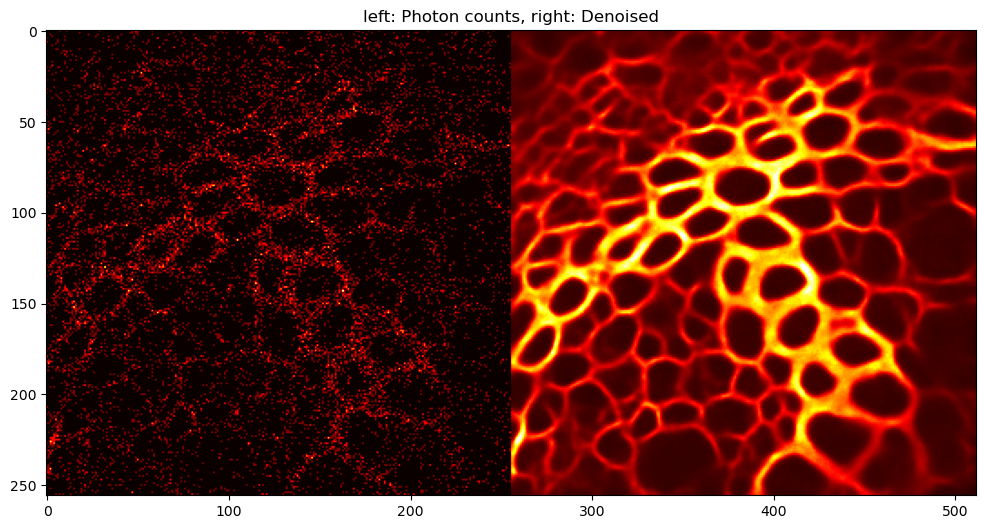

16


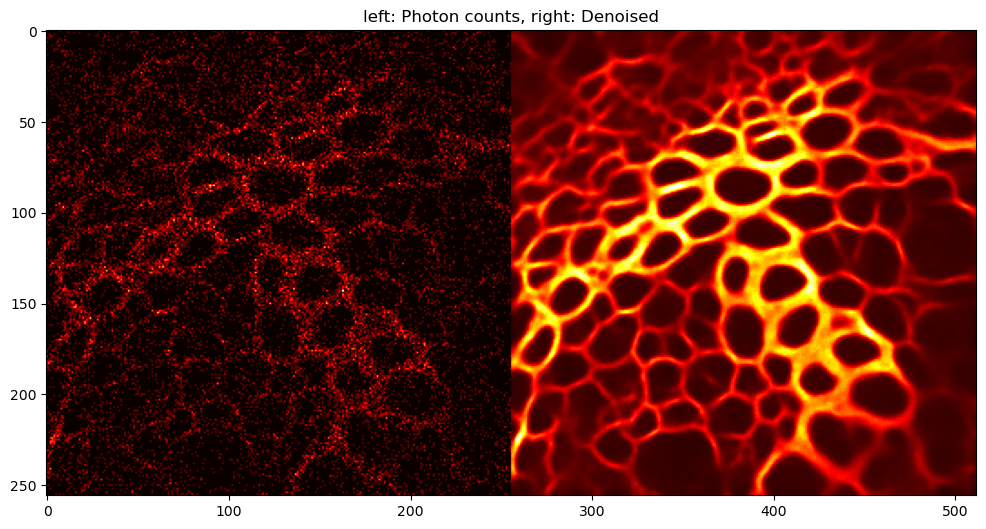

In [ ]:
stack[0].shape
for i in range(len(stack)):
    im = stack[i]
    print(i)
    plt.figure(figsize = (12,12))
    plt.imshow(im,cmap ='hot', vmax = 0.9)
    plt.title('left: Photon counts, right: Denoised')
    plt.show()

In [ ]:
# Define the Attention Unet Model

# Define the Hyperparameters of the Model:
channels = 28
initial_channels = 4
levels = 10
depth = 6
n_heads = 8
dim_k = 64
reduction_factor = 4
num_groups = 4
dropout_rate = 0.40
time_channels = 64
bottleneck_factor = 2
units = 32
bottleneck_units = 64
conv_type = "Residual_Block"
attn_type_list = [None, None, None, None, None, None, None]
merge_type = "add"
middle_attn_type = None
upsample_type = True
maxpsnr = -5.0
transpose = True
minpsnr = -40.0
num_timesteps = 1024
psnr_enabled = True
n_groups = 4

# Define the Attention Network:
AttnUNet = AttentionUNet(
        initial_channels = initial_channels,
        channels = channels,
        levels=levels,
        depth=depth,
        n_heads = n_heads,
        dim_k = dim_k,
        dropout_rate = dropout_rate,
        time_channels = time_channels,
        bottleneck_factor = bottleneck_factor,
        units = units,
        bottleneck_units= bottleneck_units,
        conv_type = conv_type,
        attn_type_list = attn_type_list,
        merge_type = merge_type,
        maxpsnr = maxpsnr,
        minpsnr = minpsnr,
        num_timesteps = num_timesteps,
        reduction_factor = reduction_factor,
        num_groups = num_groups,
        middle_attn_type = middle_attn_type,
        upsample_type = upsample_type,
        psnr_enabled = psnr_enabled,
        n_groups=n_groups
        )

In [ ]:
AttnUNet = AttnUNet.to(device)
AttnUNet

AttentionUNet(
  (Image_Projection): LazyConv2d(0, 4, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (Temporal_Embedding): Temporal_Embedder(
    (Linear_1): Linear(in_features=4, out_features=16, bias=True)
    (Linear_2): Linear(in_features=16, out_features=16, bias=True)
  )
  (input_norm): GroupNorm(4, 4, eps=1e-05, affine=True)
  (input_Swish): SiLU()
  (Final_Upsample): Up_Block(
    (Conv_Block): Residual_Block(
      (time_embedding): Linear(in_features=16, out_features=4, bias=True)
      (conv1): Conv2d(4, 4, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (conv2): Conv2d(4, 4, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (conv3): Conv2d(4, 4, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (GroupNorm_1): GroupNorm(4, 4, eps=1e-05, affine=True)
      (GroupNorm_2): GroupNorm(4, 4, eps=1e-05, affine=True)
      (dropout): Dropout(p=0.4, inplace=False)
    )
    (Upsample): ConvTranspose2d(28, 4, kernel_size=(2, 2), stride

In [ ]:
AttnUNet.forward(img_input.to(device), psnr_map.to(device).min()).shape

torch.Size([32, 1, 256, 256])

In [ ]:
name = "AttentionUNet-256x256_PSNRTrue"
CHECKPOINT_PATH = "./models/" 
Trainer = pl.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=maxepochs, 
                     callbacks=[ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_loss"),
                                LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience = 5)])
Trainer.fit(AttnUNet, Train_Loader, Validation_Loader)
Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
You are using a CUDA device ('NVIDIA GeForce RTX 4080 Laptop GPU') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name               | Type              | Params
----------------------------------------------------------
0  | Image_Projection   | Conv2d            | 364   
1  | Temporal_Embedding | Temporal_Embedder | 352   
2  | input_norm         | GroupNorm         | 8     
3  | input_Swish        | SiLU              | 0     
4  | Final_Upsample     | Up_Block          | 840   
5  | DownBlocks         | ModuleList        | 15.0 M


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

In [ ]:
name = "AttentionUNet-256x256_PSNRTrue"
CHECKPOINT_PATH = "./models/" 
model = AttentionUNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

In [ ]:
Trainer.test(model, Train_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.28960031270980835    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.28960031270980835}]

In [ ]:
Trainer.test(model, Validation_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.21740315854549408    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.21740315854549408}]

332 0 44.3373404001294 272.0 17.0


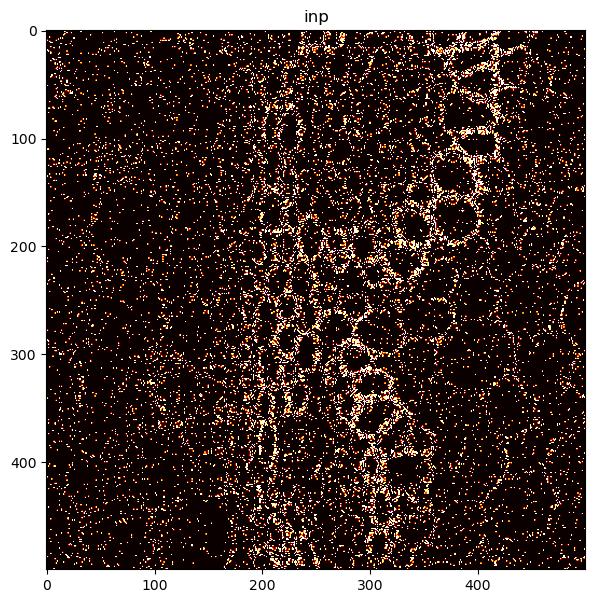

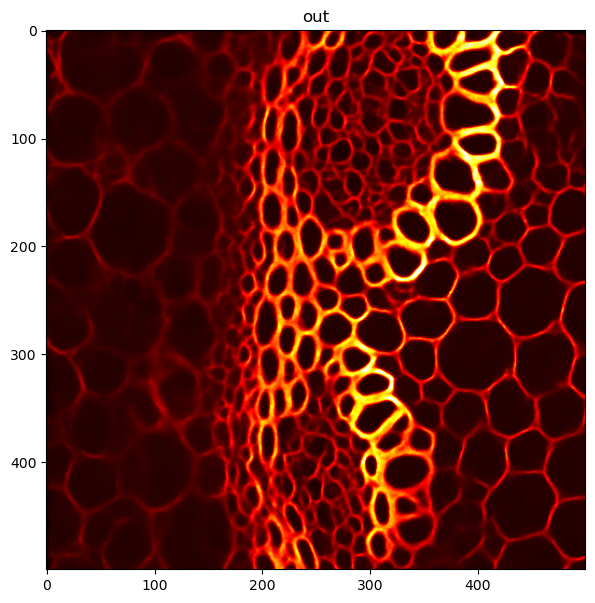

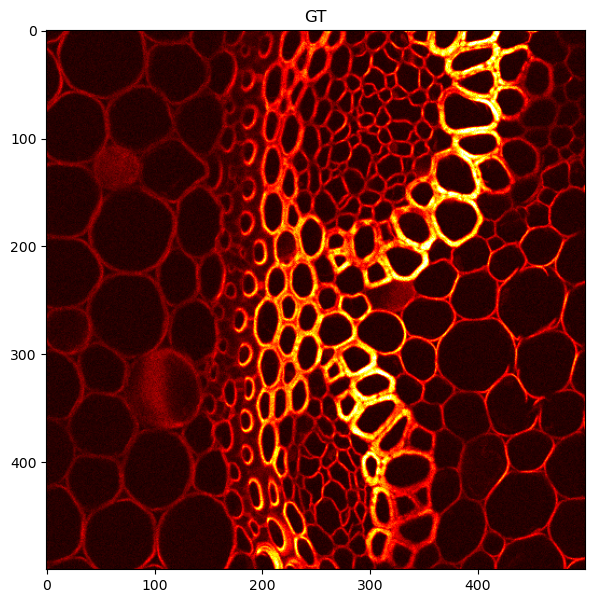

In [ ]:
outputs = []
dataTest = imread(r'testData.tif')[:1]     # to speed things up, we are only doing the first image
dataTestGT = imread(r'testDataGT.tif')[:1]
outputs = []
for inp, gt in zip(dataTest, dataTestGT):  
    inpT = torch.from_numpy(inp.astype(np.float32)).to(device)
    Psnr = np.log10(inpT.mean().item()+ 1e-50) *10
    Psnr = max(-40,Psnr)
    Psnr = torch.FloatTensor([Psnr]).to(device)
    Psnr_map = Psnr.unsqueeze(-1).expand(inpT.shape).type(torch.float32)
    model = model.to(device)
    # We have to apply softmax over pixels
    out = torch.exp(model(inpT[None,None,...], Psnr_map[None, None, ...].min()).detach().cpu())
    out = inp.sum() * out / out.sum()
    outputs.append(out.numpy()[0,0])
    
    print(gt.max(), gt.min(), gt.std(), np.percentile(gt,99.9), np.percentile(gt,50))
    
    inp = inp/inp.mean()
    out = out/out.mean()
    gt = gt/gt.mean()
    vmax = np.percentile(gt,99.9)
    
    plt.figure(figsize=(7,7))
    plt.imshow(inp[:500,:500],vmin = 0, vmax = vmax, cmap = "hot")
    plt.title('inp')
    plt.show()
    
    plt.figure(figsize=(7,7))
    plt.imshow(out[0,0][:500,:500],vmin = 0,vmax = vmax, cmap = "hot")
    plt.title('out')
    plt.show()
    
    plt.figure(figsize=(7,7))
    plt.imshow(gt[:500,:500],vmin = 0,vmax = vmax, cmap = "hot")
    plt.title('GT')

In [ ]:
PSNR(out[0,0][:500,:500].detach().cpu().numpy(), gt[:500,:500], out[0,0][:500,:500].max().detach().cpu().numpy())

24.002907105510623

160


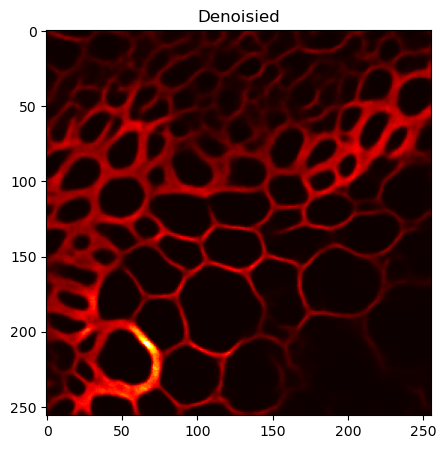

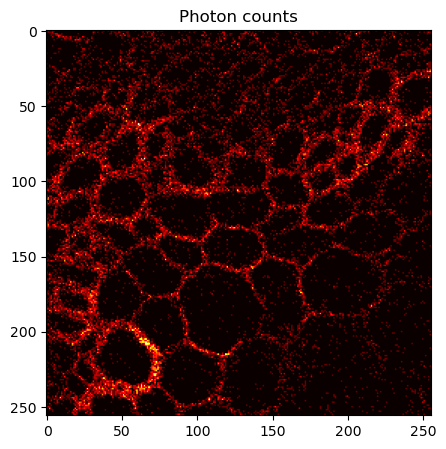

_______________________________________ 160
time (s): 1.9358243942260742 time per image (s) 1.9358243942260742


In [ ]:
import matplotlib.image as mpimg
import time
import numpy as np
from Inference import sample_image

# We are starting with an image containing zeros,
# i.e., sampling from scratch

# we just have 1 channel
channels = 1
# we can sample multiple images at the same time in a batch
batch_size = 1
# for best results this should correspond to training pach size
pixels_x = 256
pixels_y = 256

inp_img =  torch.zeros(batch_size ,channels, pixels_y, pixels_x).to(device)


for i in range(1):
    

    startTime = time.time()
    
    # sampling the image(s)
    #print(inp_img.shape)
    denoised, photons, stack, iterations = sample_imaging(inp_img,
                                                        model, 
                                                        beta = 0.05,
                                                        save_every_n = 10,
                                                        max_psnr = -5)

    
    # In case we do multiple images in a batch, we show all of them.
    for j in range(denoised.shape[0]):
            print(iterations)

            #print(denoised.shape)
            plt.figure(figsize = (5,5))
            plt.imshow(denoised[j,0], cmap='hot', vmin = 0,
                       vmax = np.percentile(denoised[j],99.99))
            plt.title('Denoisied')
            plt.show()
            
            plt.figure(figsize = (5,5))
            plt.imshow(photons[j,0], cmap='hot', vmin = 0,
                       vmax = np.percentile(photons[j],99.99))
            plt.title('Photon counts')
            plt.show()
            
            
    
    print('_______________________________________', iterations)
    
    endTime = time.time()
    elapsedTime = endTime - startTime
    print('time (s):', elapsedTime, 'time per image (s)', elapsedTime/denoised.shape[0])

0


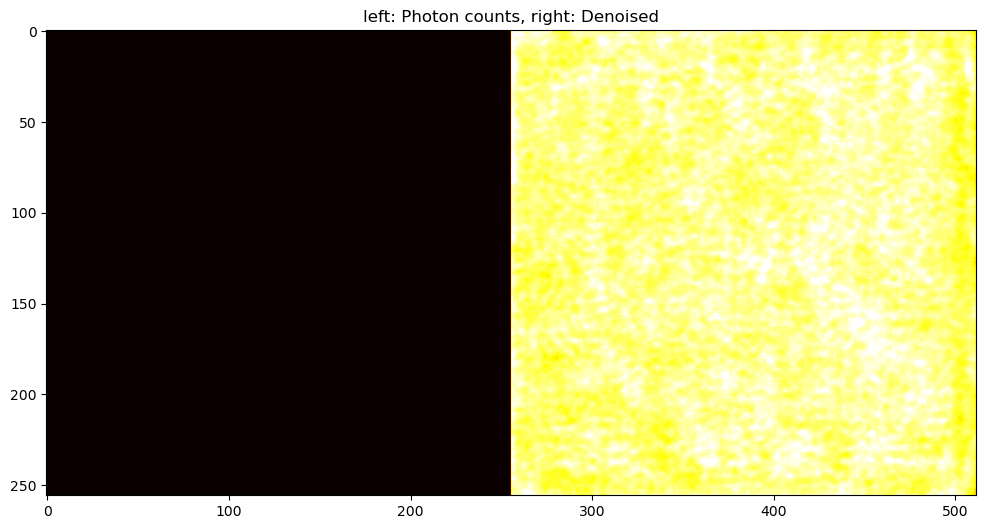

1


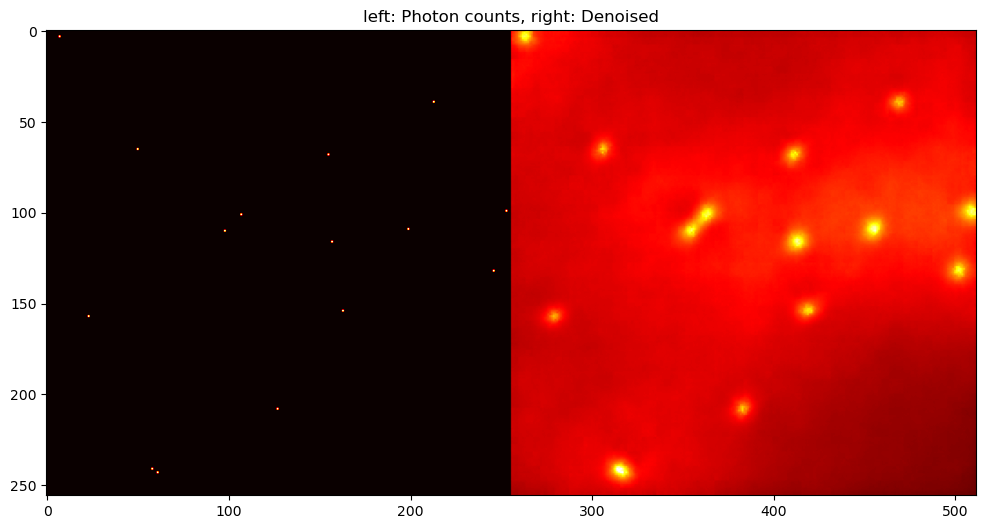

2


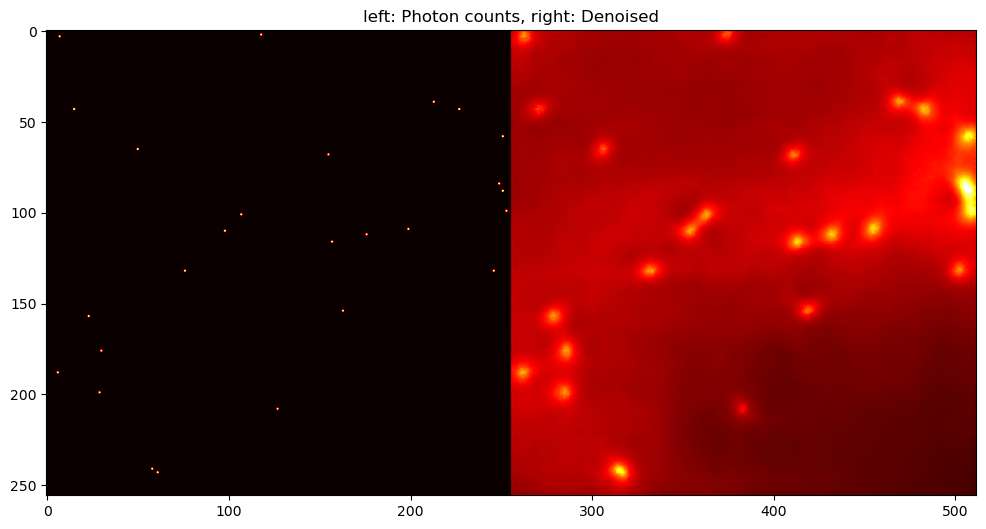

3


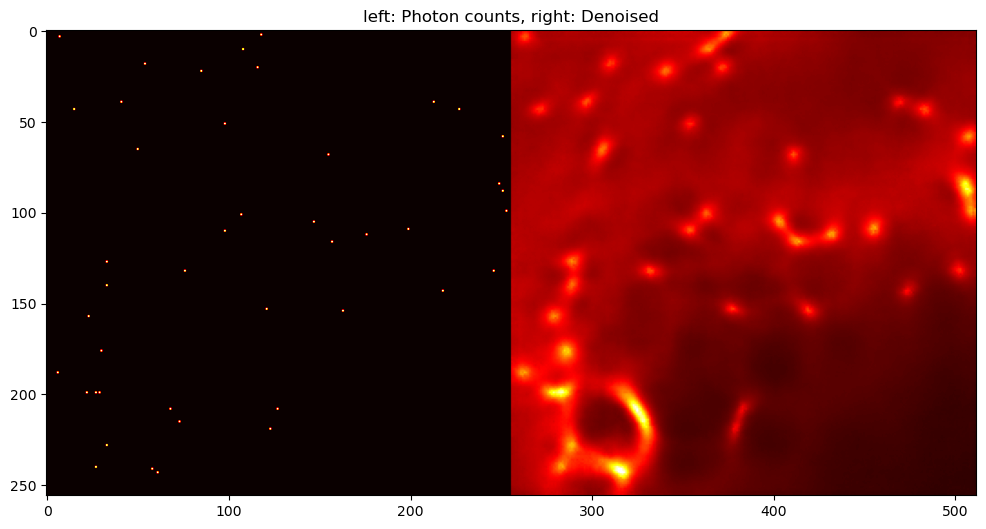

4


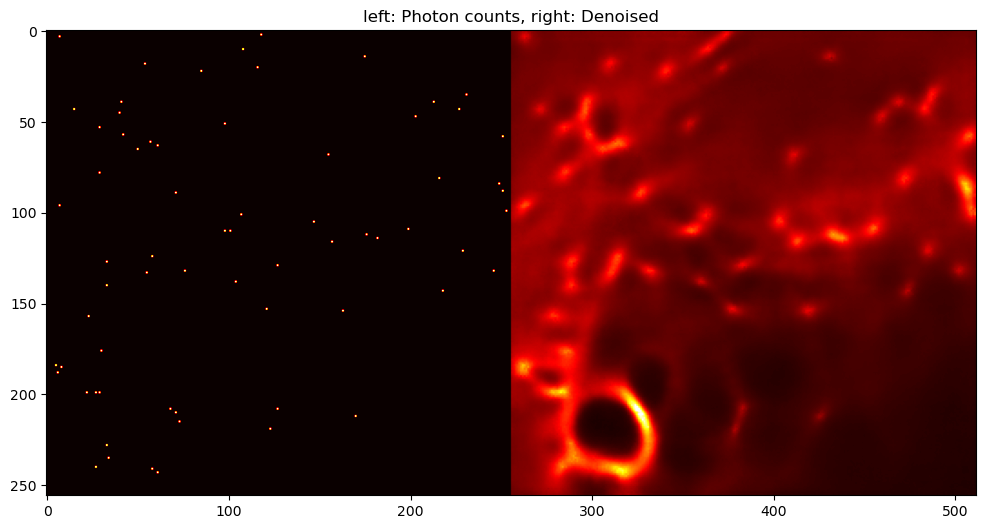

5


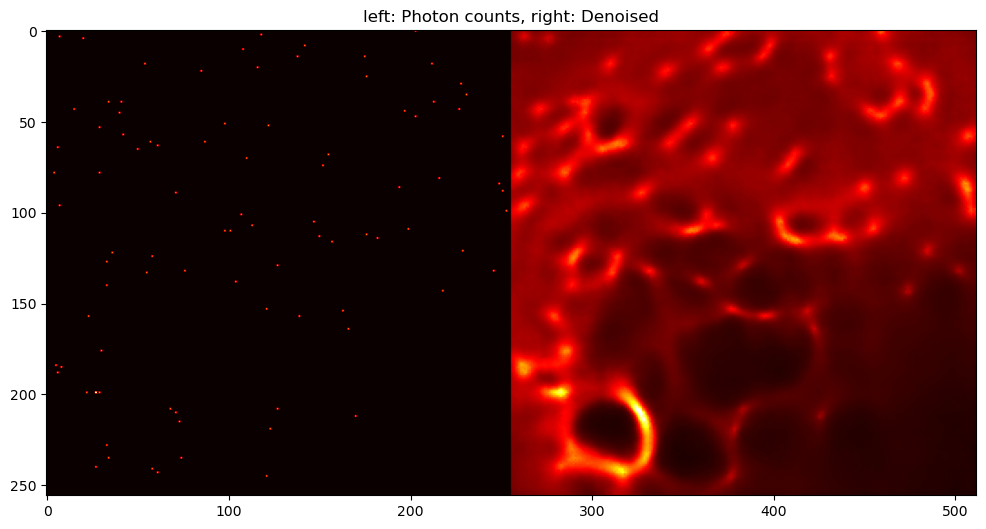

6


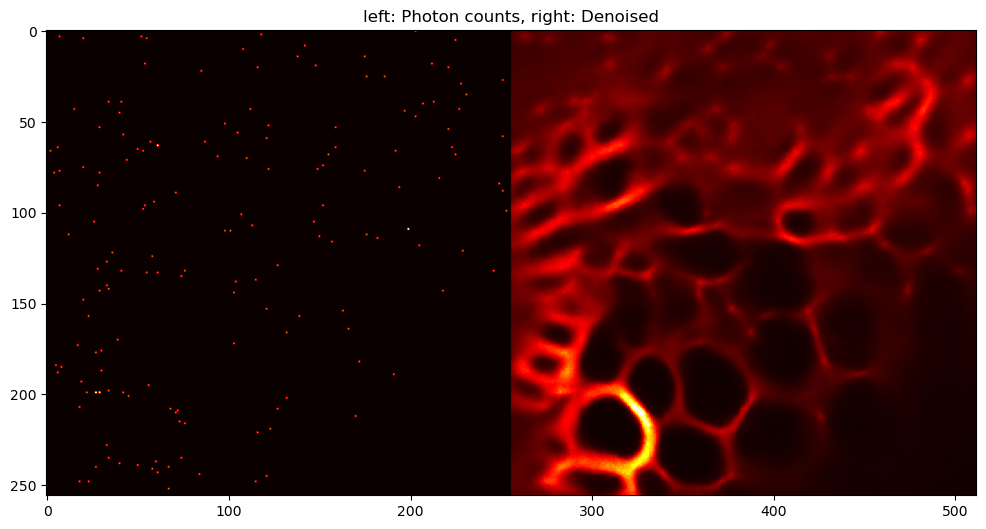

7


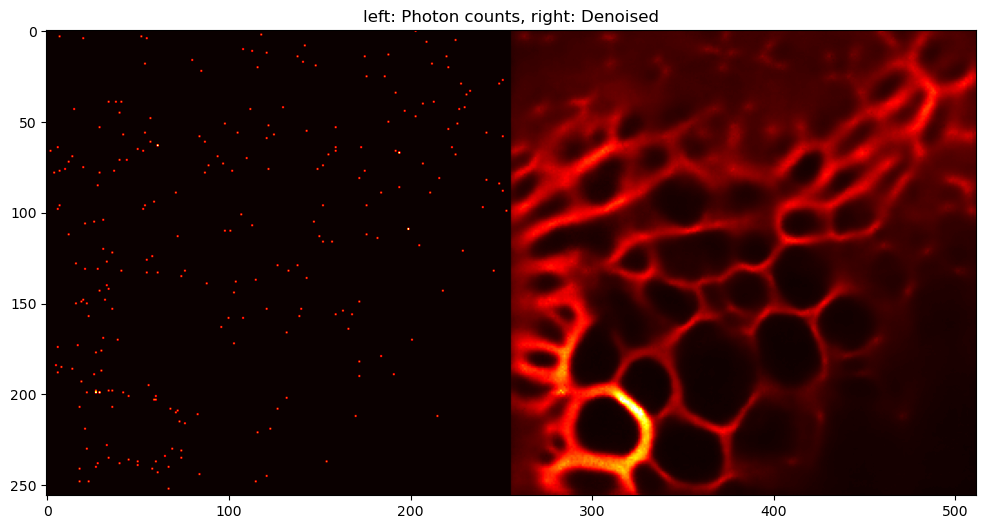

8


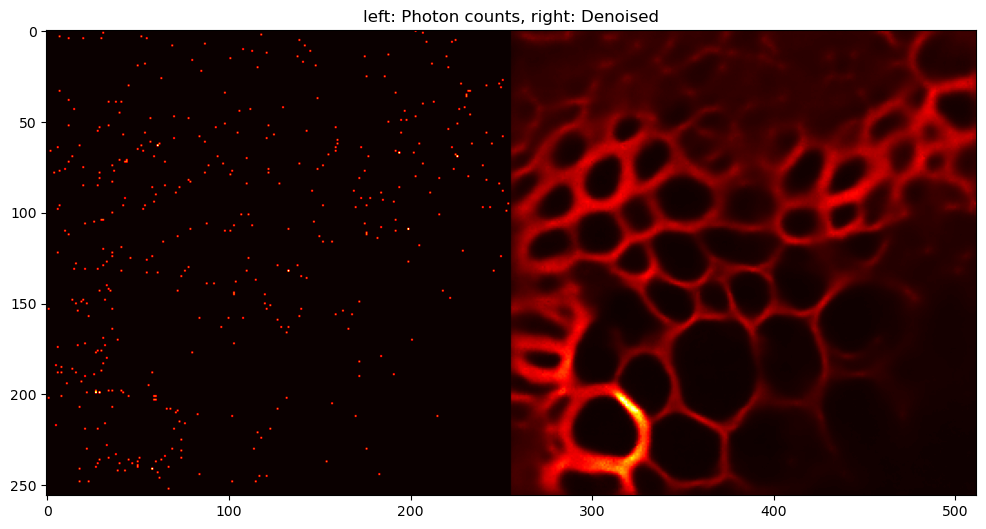

9


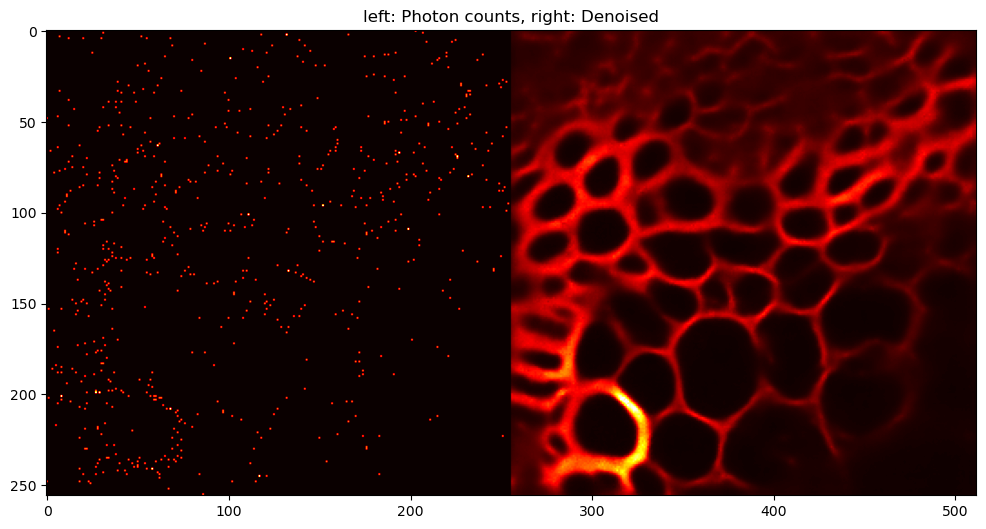

10


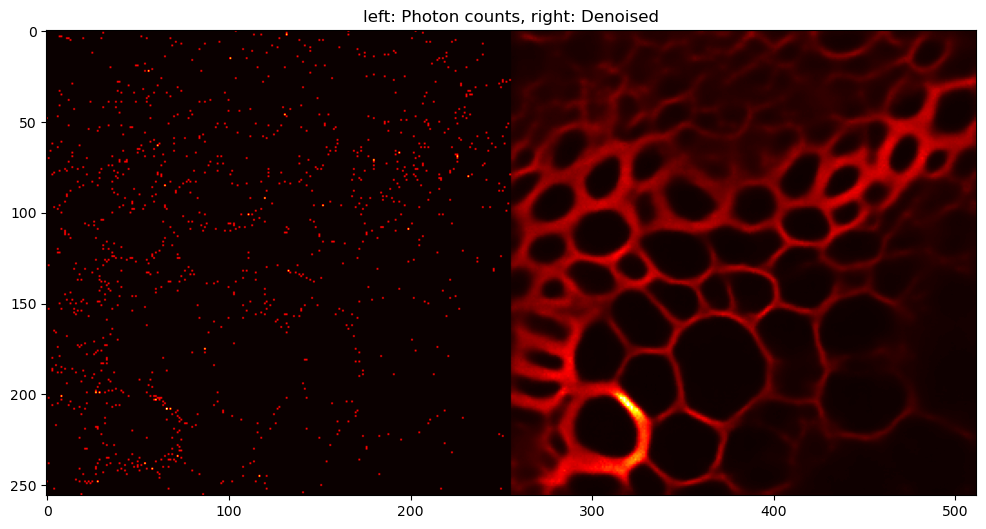

11


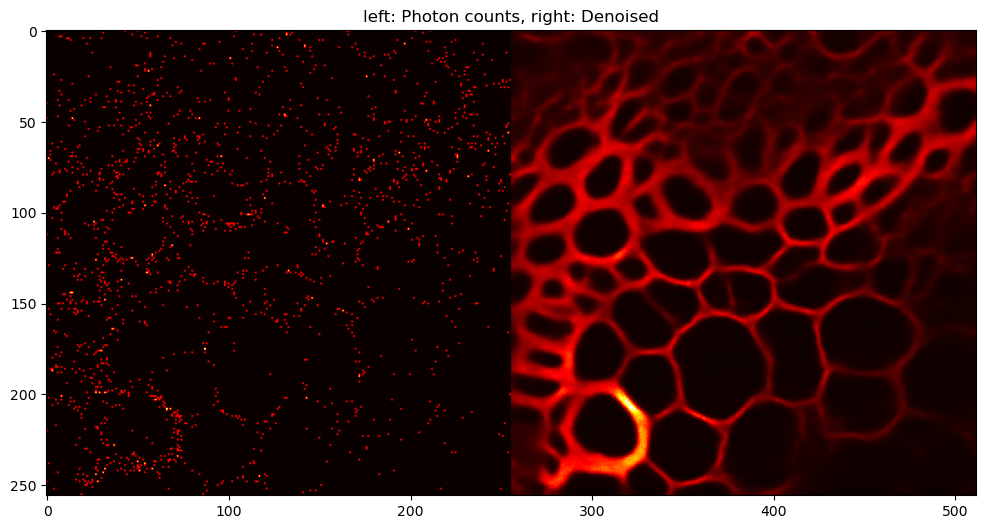

12


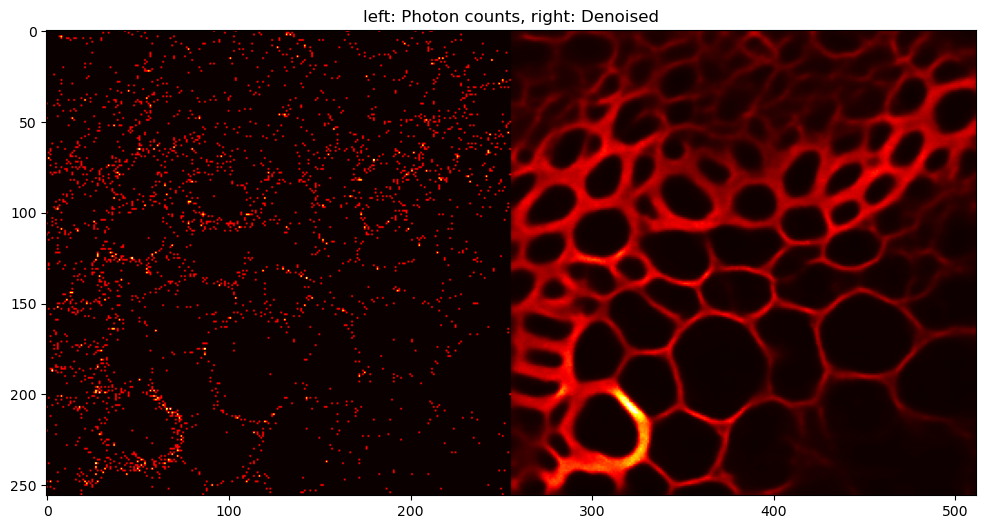

13


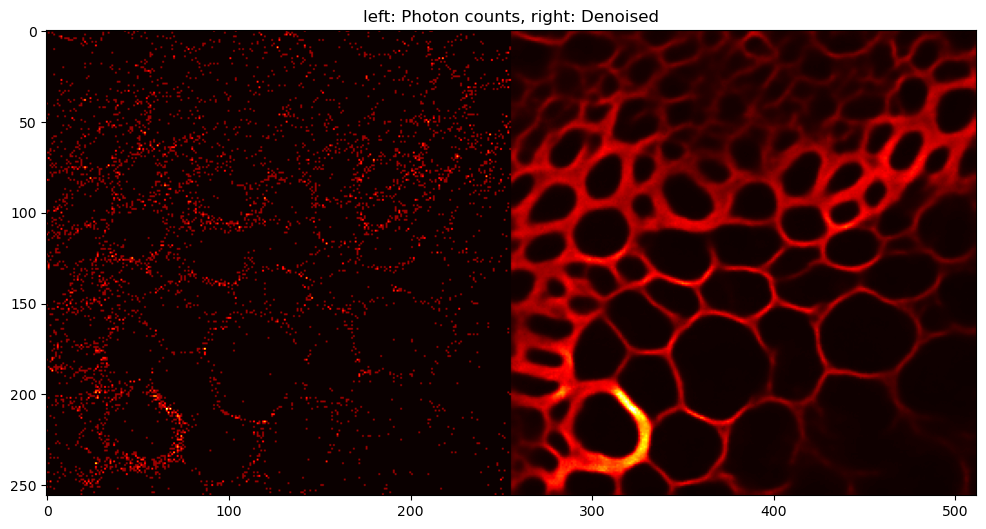

14


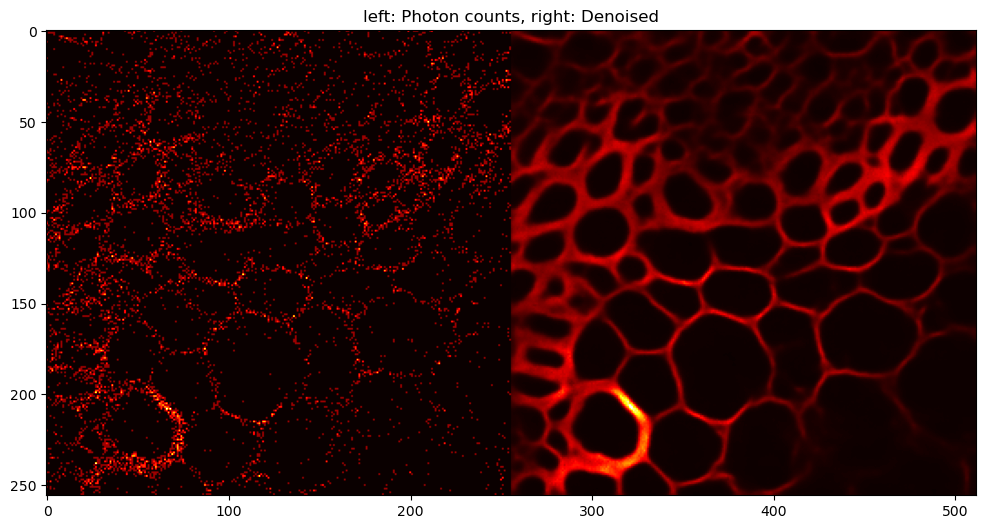

15


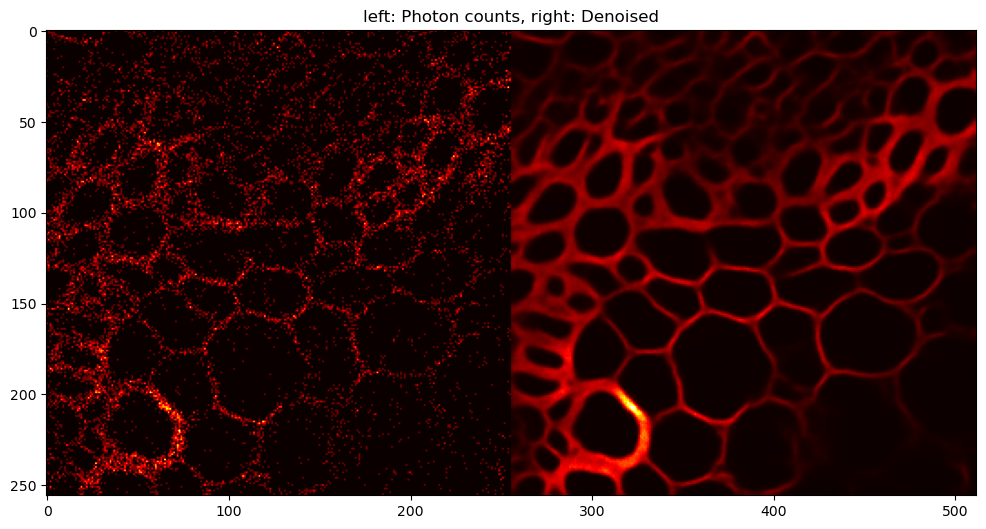

In [ ]:
stack[0].shape
for i in range(len(stack)):
    im = stack[i]
    print(i)
    plt.figure(figsize = (12,12))
    plt.imshow(im,cmap ='hot', vmax = 0.9)
    plt.title('left: Photon counts, right: Denoised')
    plt.show()

In [ ]:
# Define the Attention Unet Model

# Define the Hyperparameters of the Model:
channels = 28
initial_channels = 4
levels = 10
depth = 6
n_heads = 8
dim_k = 64
reduction_factor = 4
num_groups = 4
dropout_rate = 0.40
time_channels = 64
bottleneck_factor = 2
units = 32
bottleneck_units = 64
conv_type = "Residual_Block"
attn_type_list = [None, None, None, None, None, "Attention", "Attention"]
merge_type = "add"
middle_attn_type = "Attention"
upsample_type = True
maxpsnr = -5.0
transpose = True
minpsnr = -40.0
num_timesteps = 1024
psnr_enabled = True
num_layers = 4
patch_size = 8
n_groups = 4

# Define the Attention Network:
AttnUNet = AttentionUNet(
        initial_channels = initial_channels,
        channels = channels,
        levels=levels,
        depth=depth,
        n_heads = n_heads,
        dim_k = dim_k,
        dropout_rate = dropout_rate,
        time_channels = time_channels,
        bottleneck_factor = bottleneck_factor,
        units = units,
        bottleneck_units= bottleneck_units,
        conv_type = conv_type,
        attn_type_list = attn_type_list,
        merge_type = merge_type,
        maxpsnr = maxpsnr,
        minpsnr = minpsnr,
        num_timesteps = num_timesteps,
        reduction_factor = reduction_factor,
        num_groups = num_groups,
        middle_attn_type = middle_attn_type,
        upsample_type = upsample_type,
        psnr_enabled = psnr_enabled,
        n_groups =n_groups,
        num_layers = num_layers,
        patch_size = patch_size
        )

In [ ]:
AttnUNet = AttnUNet.to(device)
AttnUNet

AttentionUNet(
  (Image_Projection): LazyConv2d(0, 4, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (Temporal_Embedding): Temporal_Embedder(
    (Linear_1): Linear(in_features=4, out_features=16, bias=True)
    (Linear_2): Linear(in_features=16, out_features=16, bias=True)
  )
  (input_norm): GroupNorm(4, 4, eps=1e-05, affine=True)
  (input_Swish): SiLU()
  (Final_Upsample): Up_Block(
    (Conv_Block): Residual_Block(
      (time_embedding): Linear(in_features=16, out_features=4, bias=True)
      (conv1): Conv2d(4, 4, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (conv2): Conv2d(4, 4, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (conv3): Conv2d(4, 4, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (GroupNorm_1): GroupNorm(4, 4, eps=1e-05, affine=True)
      (GroupNorm_2): GroupNorm(4, 4, eps=1e-05, affine=True)
      (dropout): Dropout(p=0.4, inplace=False)
    )
    (Upsample): ConvTranspose2d(28, 4, kernel_size=(2, 2), stride

In [ ]:
AttnUNet.forward(img_input.to(device), psnr_map.to(device).min()).shape

torch.Size([32, 1, 256, 256])

In [ ]:
name = "AttentionUNet-256x256AttentionTrue"
CHECKPOINT_PATH = "./models/" 
Trainer = pl.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=maxepochs, 
                     callbacks=[ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_loss"),
                                LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience = 15)])
Trainer.fit(AttnUNet, Train_Loader, Validation_Loader)
Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name               | Type              | Params
----------------------------------------------------------
0  | Image_Projection   | Conv2d            | 364   
1  | Temporal_Embedding | Temporal_Embedder | 352   
2  | input_norm         | GroupNorm         | 8     
3  | input_Swish        | SiLU              | 0     
4  | Final_Upsample     | Up_Block          | 840   
5  | DownBlocks         | ModuleList        | 16.9 M
6  | MiddleBlocks       | ModuleList        | 32.4 M
7  | UpBlocks           | ModuleList        | 7.2 M 
8  | output_norm        | GroupNorm         | 56    
9  | output_Swish       | SiLU              | 0     
10 | Output_Layer       | Conv2d            | 29    
----------------------------------------------------------
56.5 M    Trainable params
0         Non-trainable 

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=20` reached.


In [ ]:
model = AttentionUNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

In [ ]:
Trainer.test(model, Train_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    -0.2775289714336395    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.2775289714336395}]

In [ ]:
Trainer.test(model, Validation_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.17640352249145508    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.17640352249145508}]

332 0 44.3373404001294 272.0 17.0


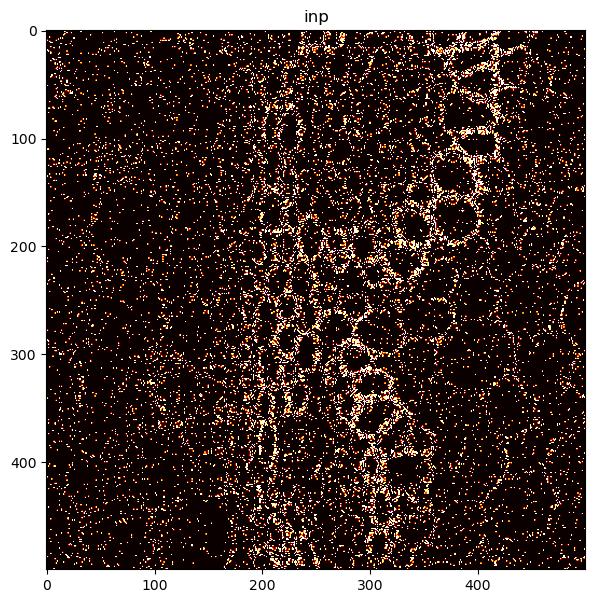

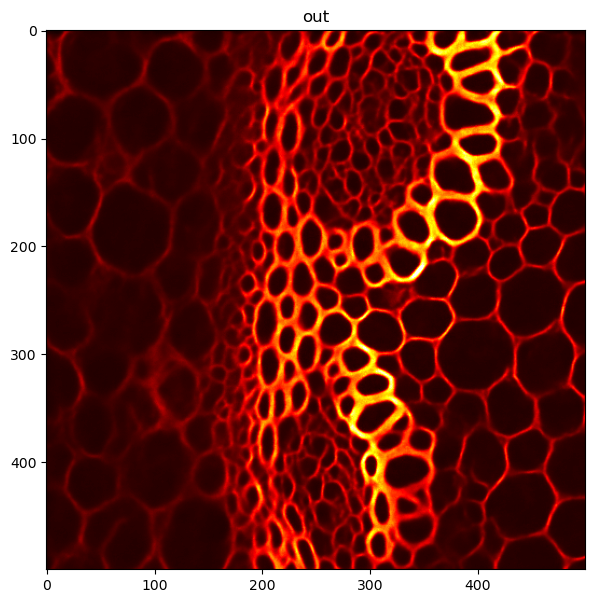

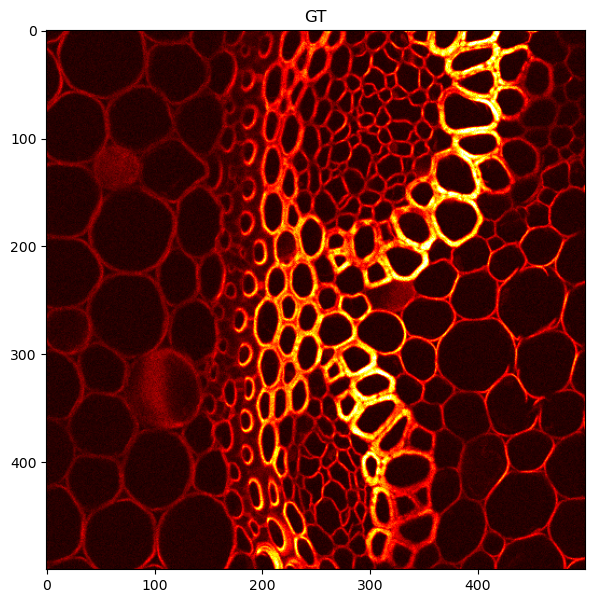

In [ ]:
dataTest = imread(r'testData.tif')[:1]     # to speed things up, we are only doing the first image
dataTestGT = imread(r'testDataGT.tif')[:1]
outputs = []
for inp, gt in zip(dataTest, dataTestGT):  
    inpT = torch.from_numpy(inp.astype(np.float32)).to(device)
    Psnr = np.log10(inpT.mean().item()+ 1e-50) *10
    Psnr = max(-40,Psnr)
    Psnr = torch.FloatTensor([Psnr]).to(device)
    Psnr_map = Psnr.unsqueeze(-1).expand(inpT.shape).type(torch.float32)
    model = model.to(device)
    # We have to apply softmax over pixels
    out = torch.exp(model(inpT[None,None,...], Psnr_map[None, None, ...].min()).detach().cpu())
    out = inp.sum() * out / out.sum()
    outputs.append(out.numpy()[0,0])
    
    print(gt.max(), gt.min(), gt.std(), np.percentile(gt,99.9), np.percentile(gt,50))
    
    inp = inp/inp.mean()
    out = out/out.mean()
    gt = gt/gt.mean()
    vmax = np.percentile(gt,99.9)
    
    plt.figure(figsize=(7,7))
    plt.imshow(inp[:500,:500],vmin = 0, vmax = vmax, cmap = "hot")
    plt.title('inp')
    plt.show()
    
    plt.figure(figsize=(7,7))
    plt.imshow(out[0,0][:500,:500],vmin = 0,vmax = vmax, cmap = "hot")
    plt.title('out')
    plt.show()
    
    plt.figure(figsize=(7,7))
    plt.imshow(gt[:500,:500],vmin = 0,vmax = vmax, cmap = "hot")
    plt.title('GT')

In [ ]:
PSNR(out[0,0][:500,:500].detach().cpu().numpy(), gt[:500,:500], out[0,0][:500,:500].max().detach().cpu().numpy())

23.601065443304154

173


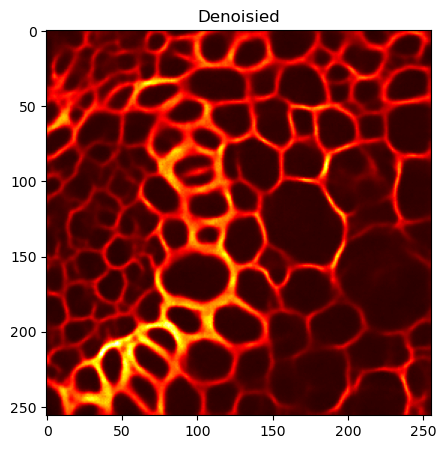

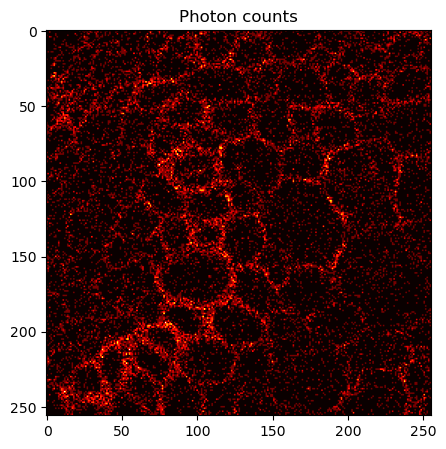

_______________________________________ 173
time (s): 2.117429733276367 time per image (s) 2.117429733276367


In [ ]:
import matplotlib.image as mpimg
import time
import numpy as np
from Inference import sample_image

# We are starting with an image containing zeros,
# i.e., sampling from scratch

# we just have 1 channel
channels = 1
# we can sample multiple images at the same time in a batch
batch_size = 1
# for best results this should correspond to training pach size
pixels_x = 256
pixels_y = 256

inp_img =  torch.zeros(batch_size ,channels, pixels_y, pixels_x).to(device)


for i in range(1):
    

    startTime = time.time()
    
    # sampling the image(s)
    #print(inp_img.shape)
    denoised, photons, stack, iterations = sample_imaging(inp_img,
                                                        model, 
                                                        beta = 0.05,
                                                        save_every_n = 10,
                                                        max_psnr = -5)

    
    # In case we do multiple images in a batch, we show all of them.
    for j in range(denoised.shape[0]):
            print(iterations)

            #print(denoised.shape)
            plt.figure(figsize = (5,5))
            plt.imshow(denoised[j,0], cmap='hot', vmin = 0,
                       vmax = np.percentile(denoised[j],99.99))
            plt.title('Denoisied')
            plt.show()
            
            plt.figure(figsize = (5,5))
            plt.imshow(photons[j,0], cmap='hot', vmin = 0,
                       vmax = np.percentile(photons[j],99.99))
            plt.title('Photon counts')
            plt.show()
            
            
    
    print('_______________________________________', iterations)
    
    endTime = time.time()
    elapsedTime = endTime - startTime
    print('time (s):', elapsedTime, 'time per image (s)', elapsedTime/denoised.shape[0])

0


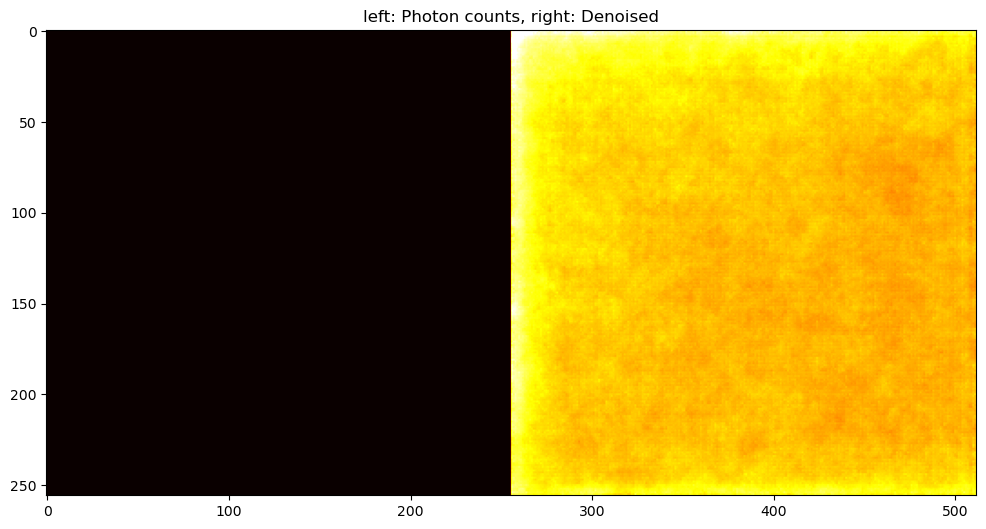

1


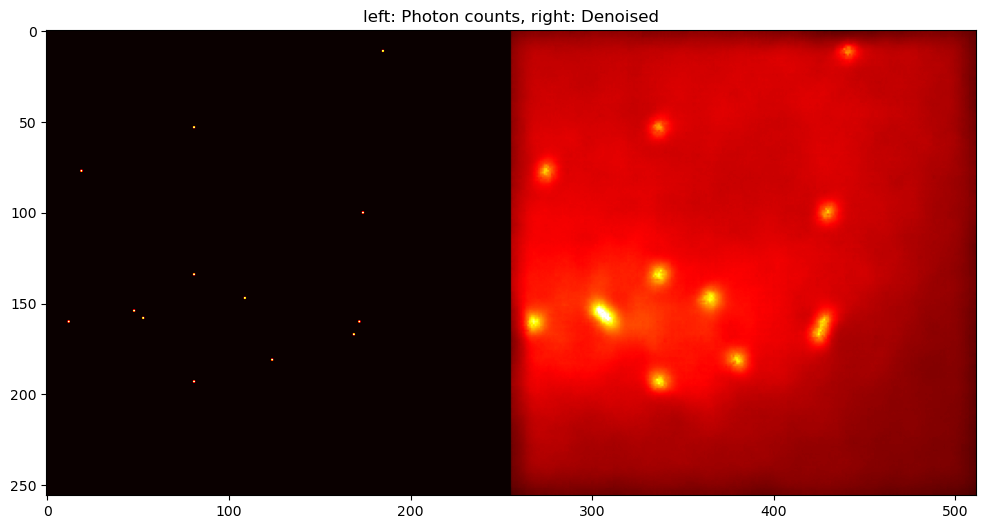

2


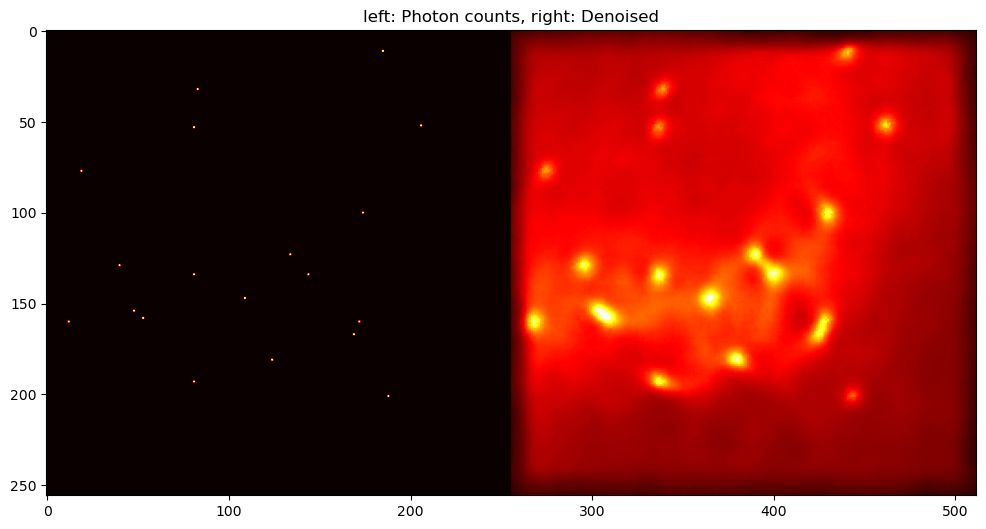

3


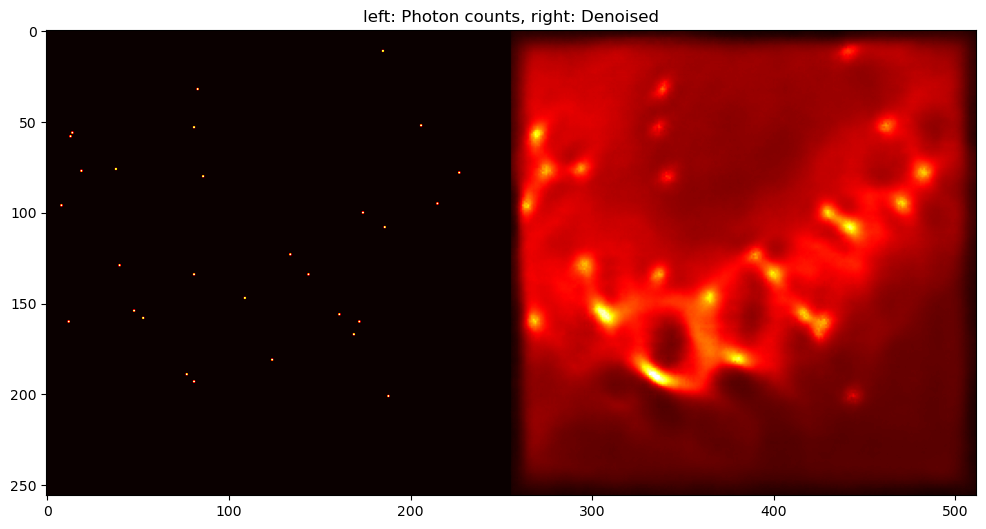

4


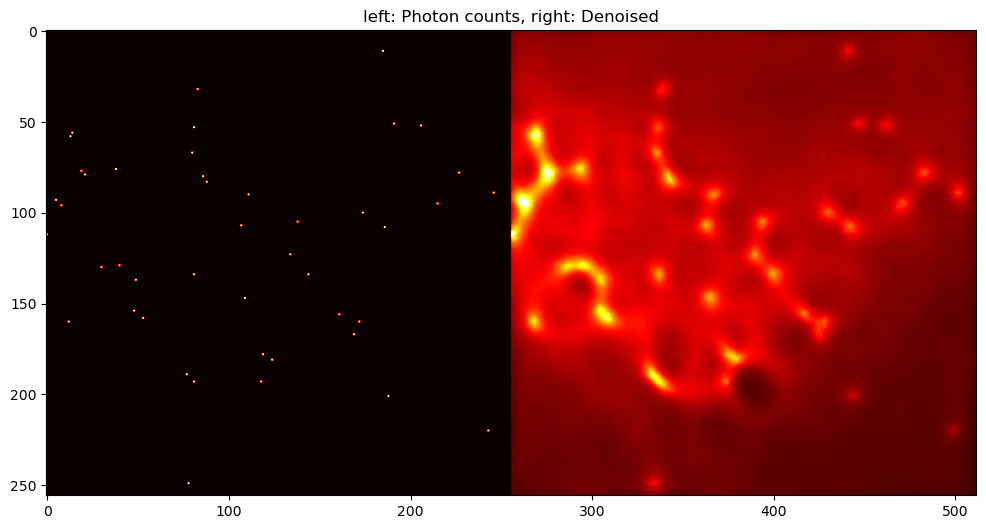

5


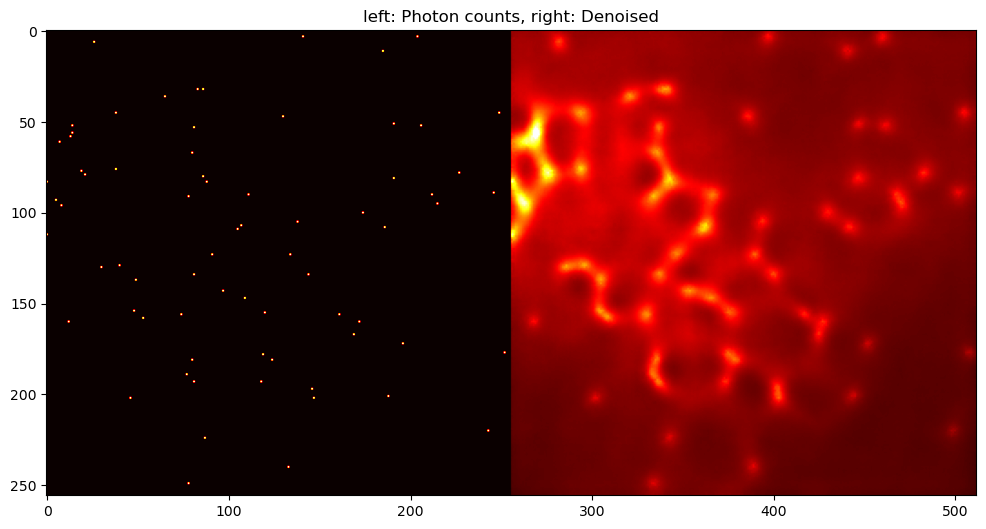

6


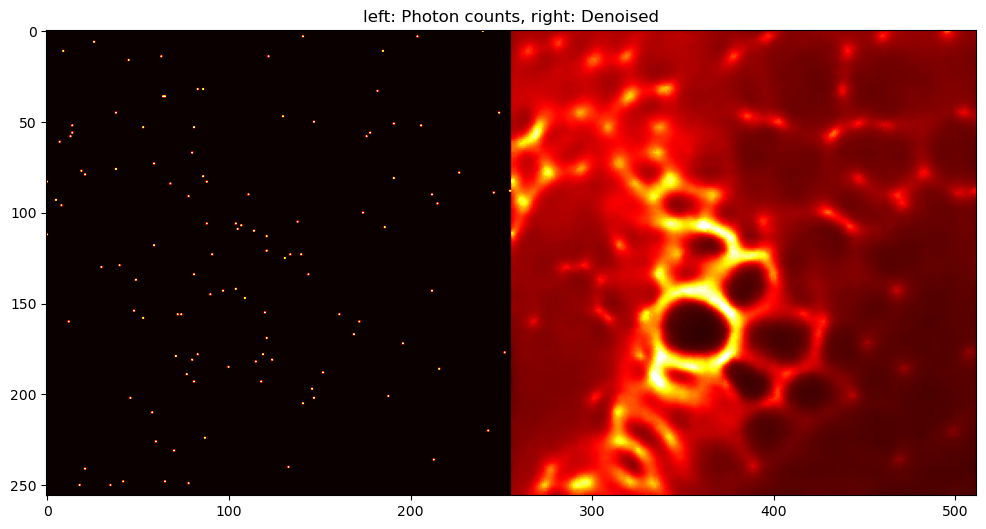

7


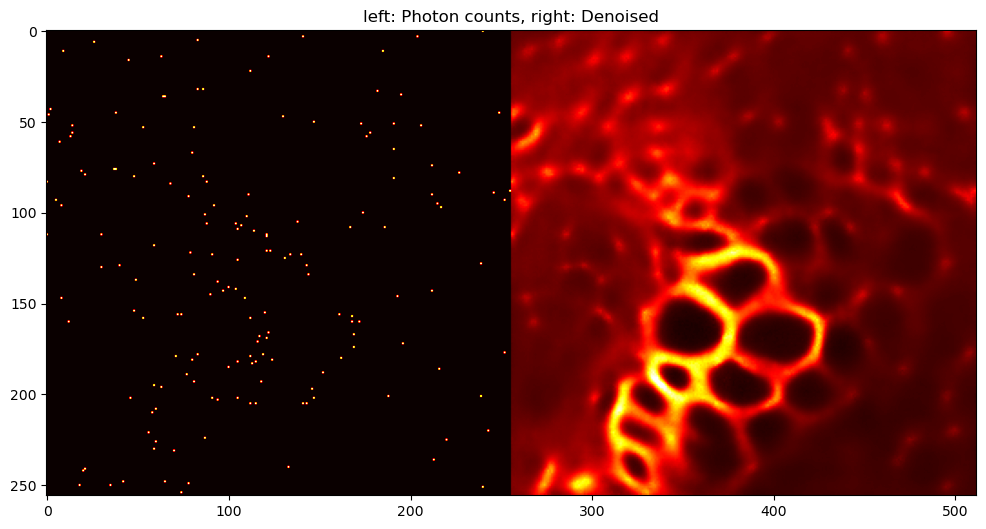

8


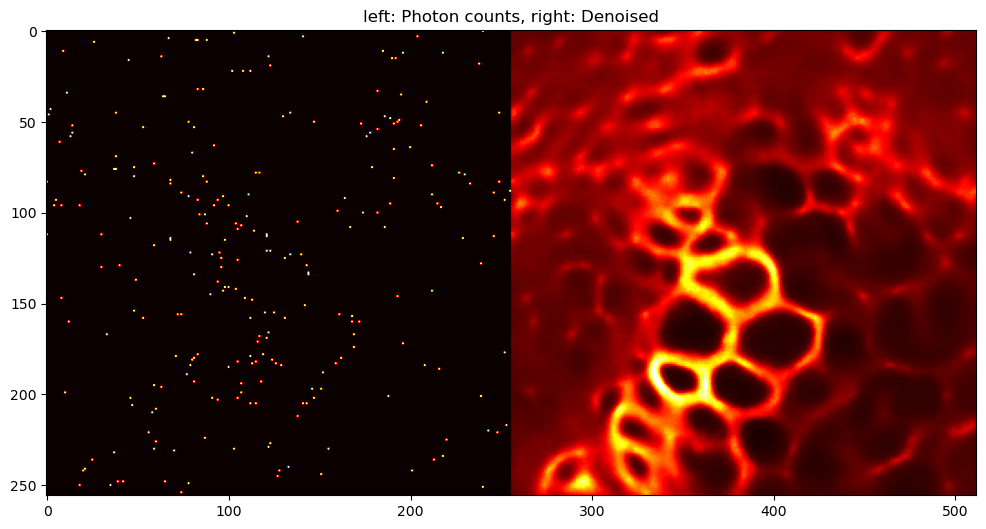

9


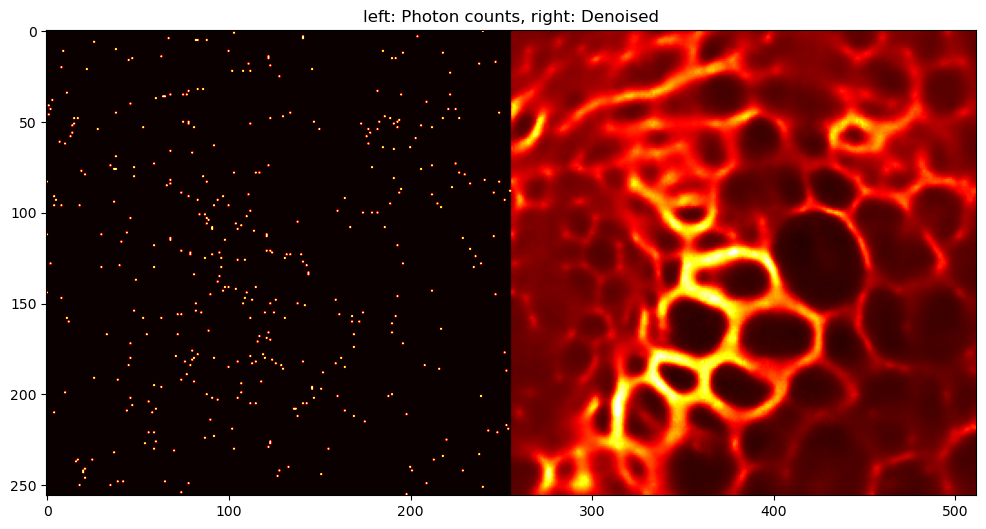

10


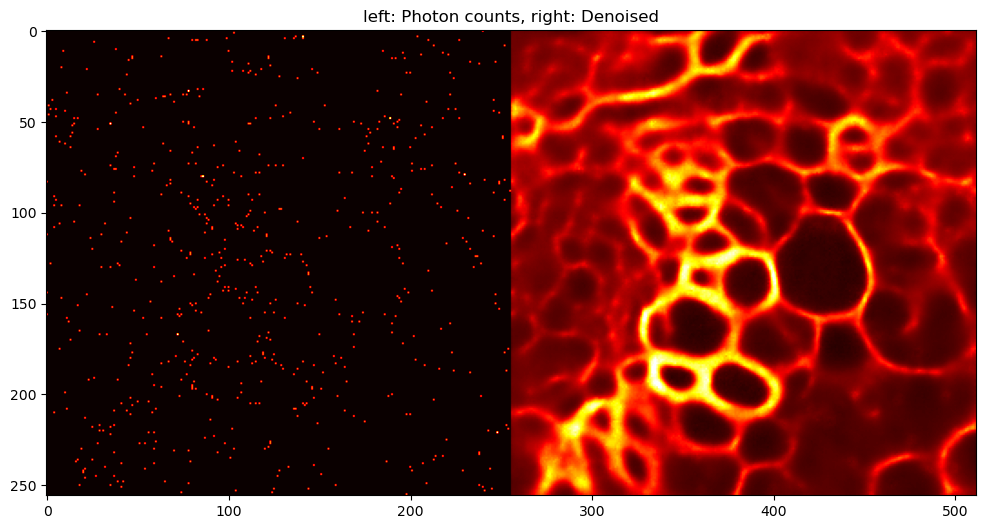

11


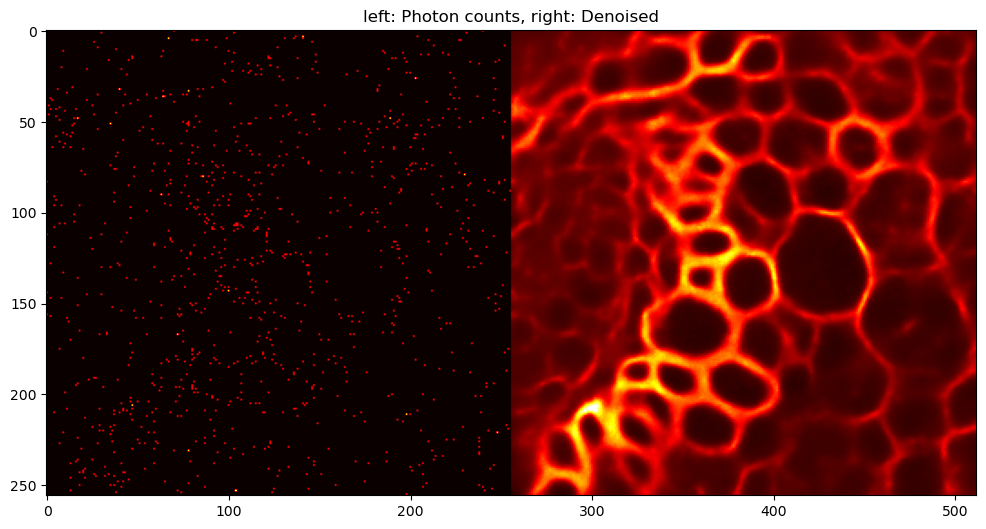

12


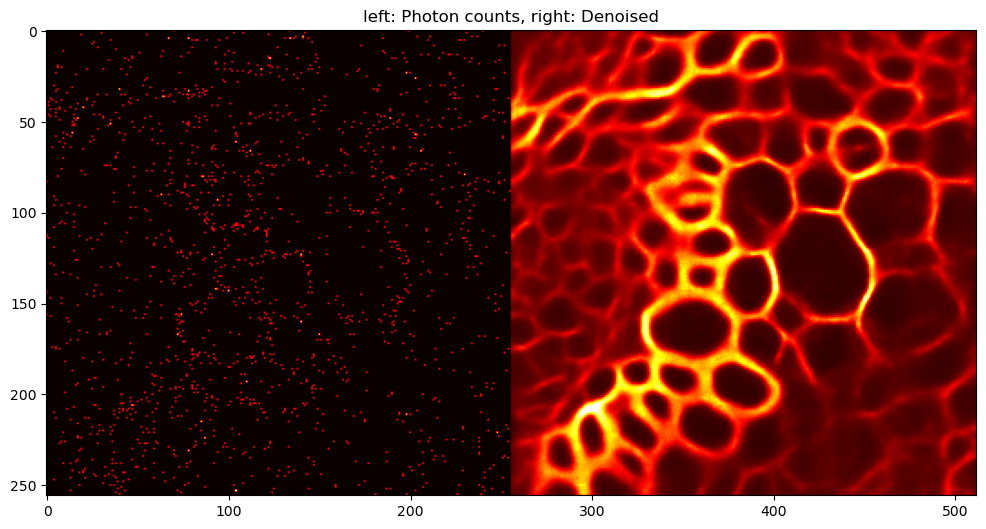

13


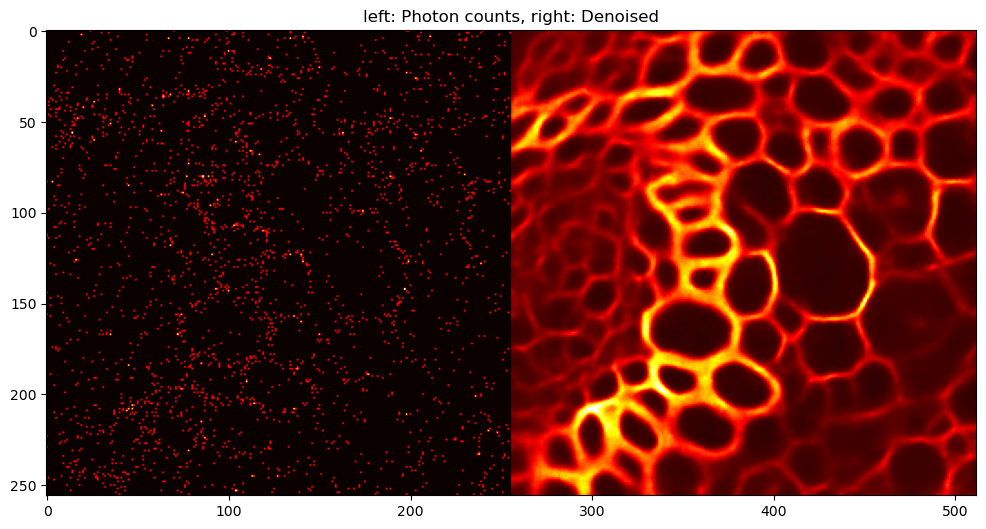

14


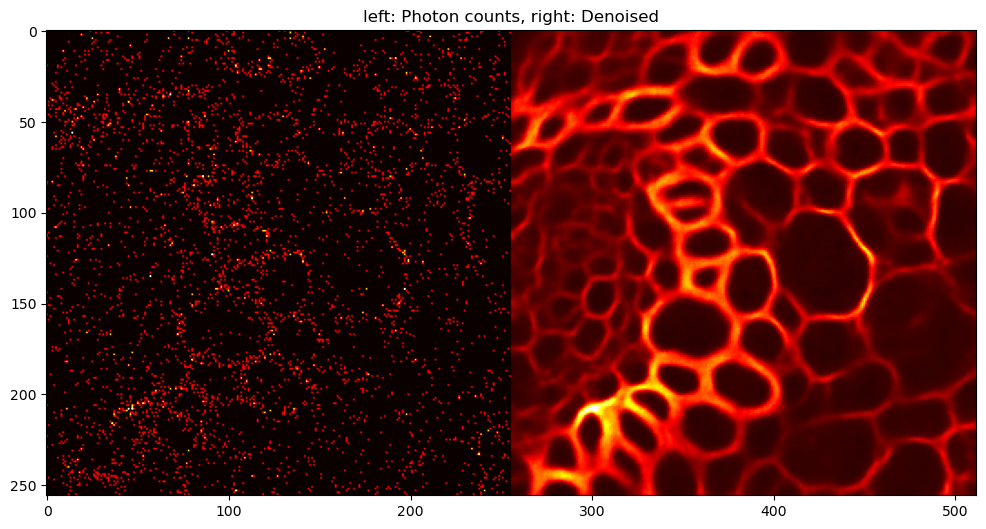

15


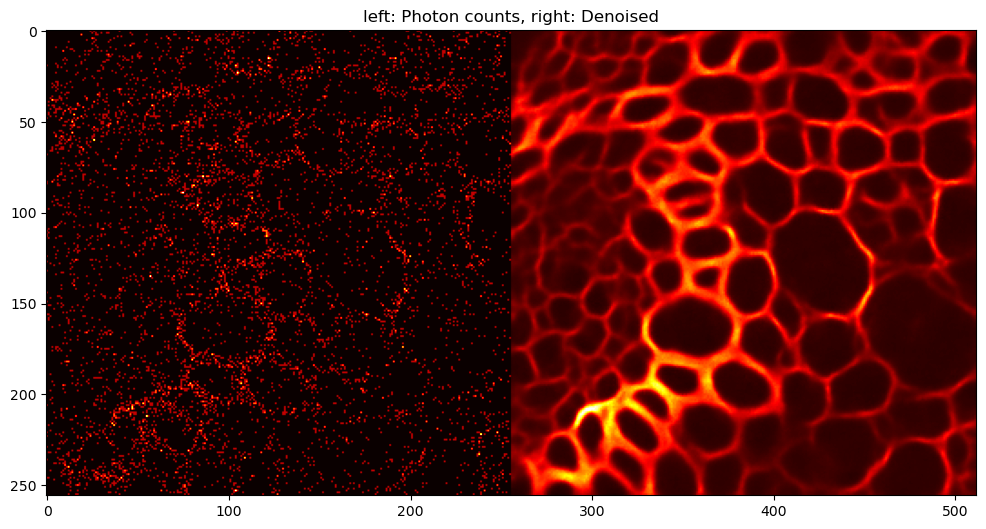

16


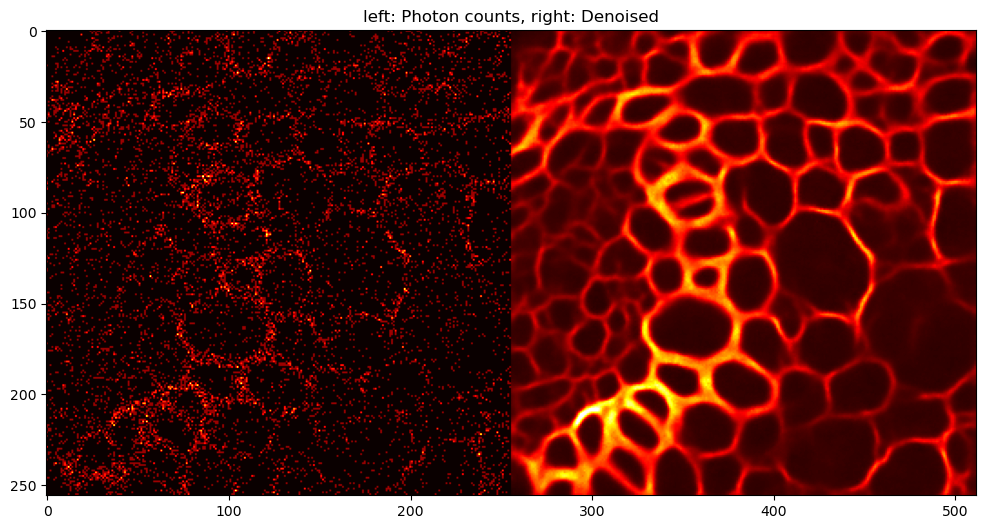

17


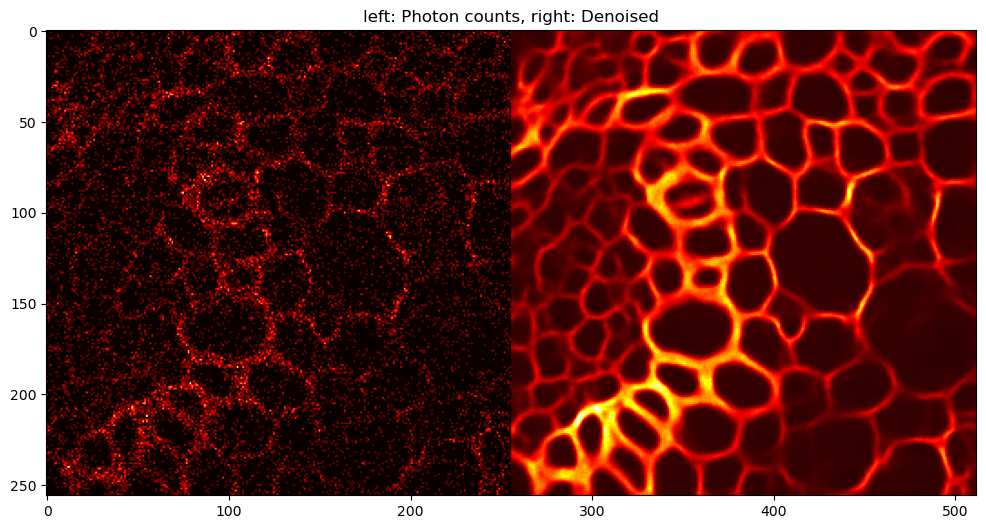

In [ ]:
stack[0].shape
for i in range(len(stack)):
    im = stack[i]
    print(i)
    plt.figure(figsize = (12,12))
    plt.imshow(im,cmap ='hot', vmax = 0.9)
    plt.title('left: Photon counts, right: Denoised')
    plt.show()

In [ ]:
# Define the Attention Unet Model

# Define the Hyperparameters of the Model:
channels = 28
initial_channels = 4
levels = 10
depth = 6
n_heads = 8
dim_k = 64
reduction_factor = 4
num_groups = 4
dropout_rate = 0.40
time_channels = 64
bottleneck_factor = 2
units = 32
bottleneck_units = 64
conv_type = "Residual_Block"
attn_type_list = [None, None, None, None, None, None, None]
merge_type = "add"
middle_attn_type = "VisionTransformer"
upsample_type = True
maxpsnr = -5.0
transpose = True
minpsnr = -40.0
num_timesteps = 1024
psnr_enabled = True
num_layers = 1
patch_size = 8
n_groups = 4
transformer_bottleneck = 32

# Define the Attention Network:
AttnUNet = AttentionUNet(
        initial_channels = initial_channels,
        channels = channels,
        levels=levels,
        depth=depth,
        n_heads = n_heads,
        dim_k = dim_k,
        dropout_rate = dropout_rate,
        time_channels = time_channels,
        bottleneck_factor = bottleneck_factor,
        units = units,
        bottleneck_units= bottleneck_units,
        conv_type = conv_type,
        attn_type_list = attn_type_list,
        merge_type = merge_type,
        maxpsnr = maxpsnr,
        minpsnr = minpsnr,
        num_timesteps = num_timesteps,
        reduction_factor = reduction_factor,
        num_groups = num_groups,
        middle_attn_type = middle_attn_type,
        upsample_type = upsample_type,
        psnr_enabled = psnr_enabled,
        n_groups =n_groups,
        num_layers = num_layers,
        patch_size = patch_size,
        transformer_bottleneck=transformer_bottleneck
        )

In [ ]:
AttnUNet = AttnUNet.to(device)
AttnUNet

AttentionUNet(
  (Image_Projection): LazyConv2d(0, 4, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (Temporal_Embedding): Temporal_Embedder(
    (Linear_1): Linear(in_features=4, out_features=16, bias=True)
    (Linear_2): Linear(in_features=16, out_features=16, bias=True)
  )
  (input_norm): GroupNorm(4, 4, eps=1e-05, affine=True)
  (input_Swish): SiLU()
  (Final_Upsample): Up_Block(
    (Conv_Block): Residual_Block(
      (time_embedding): Linear(in_features=16, out_features=4, bias=True)
      (conv1): Conv2d(4, 4, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (conv2): Conv2d(4, 4, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (conv3): Conv2d(4, 4, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (GroupNorm_1): GroupNorm(4, 4, eps=1e-05, affine=True)
      (GroupNorm_2): GroupNorm(4, 4, eps=1e-05, affine=True)
      (dropout): Dropout(p=0.4, inplace=False)
    )
    (Upsample): ConvTranspose2d(28, 4, kernel_size=(2, 2), stride

In [ ]:
AttnUNet.forward(img_input.to(device), psnr_map.to(device).min()).shape

torch.Size([32, 1, 256, 256])

In [ ]:
name = "AttentionUNet-256x256_PSNRVisionAttentionTrue"
CHECKPOINT_PATH = "./models/" 
Trainer = pl.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=maxepochs, 
                     callbacks=[ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_loss"),
                                LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience = 5)])
Trainer.fit(AttnUNet, Train_Loader, Validation_Loader)
Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
You are using a CUDA device ('NVIDIA GeForce RTX 4080 Laptop GPU') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
Missing logger folder: models\AttentionUNet-256x256_PSNRVisionAttentionTrue\lightning_logs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name               | Type              | Params
----------------------------------------------------------
0  | Image_Projection   | Conv2d            | 364   
1  | Temporal_Embedding | Temporal_Embedder | 352   
2  | input_norm         | GroupNorm         | 8     
3  | input_Swish        | SiLU              | 0     
4  | Final_Upsa

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

In [ ]:
model = AttentionUNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

In [ ]:
Trainer.test(model, Train_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    -0.2879357635974884    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.2879357635974884}]

In [ ]:
Trainer.test(model, Validation_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.20925037562847137    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.20925037562847137}]

332 0 44.3373404001294 272.0 17.0


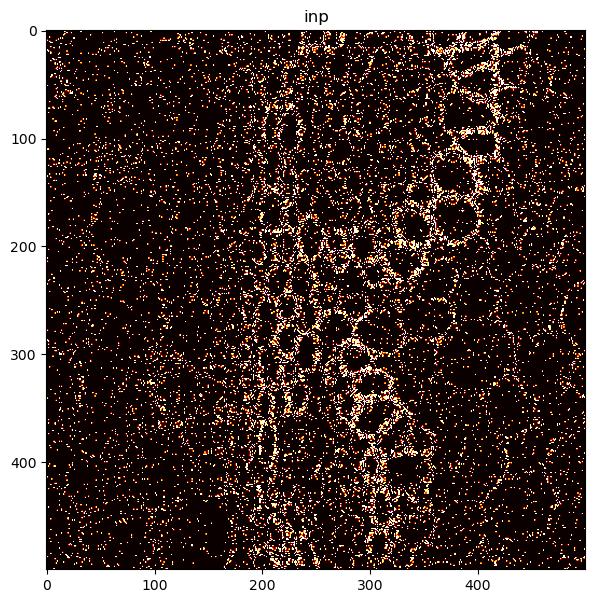

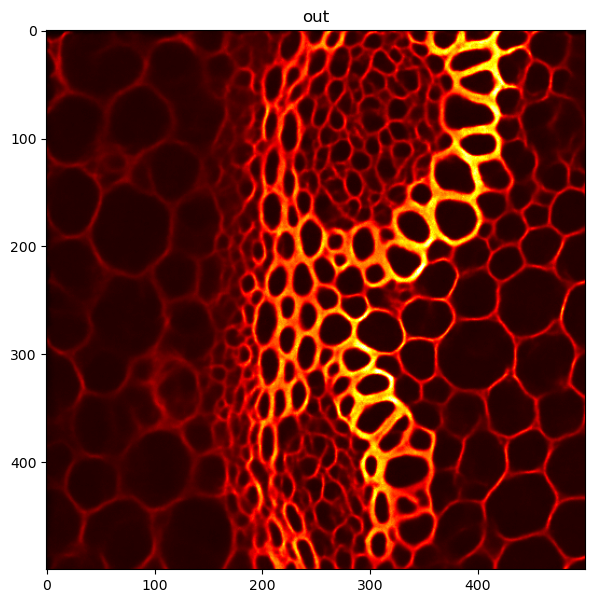

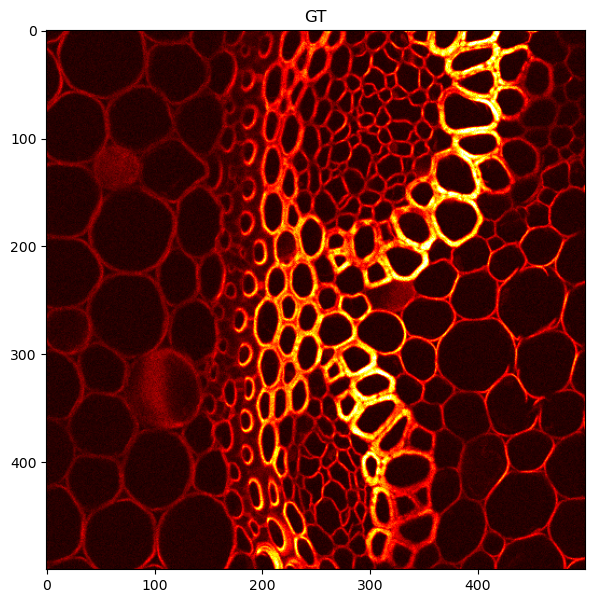

In [ ]:
dataTest = imread(r'testData.tif')[:1]     # to speed things up, we are only doing the first image
dataTestGT = imread(r'testDataGT.tif')[:1]
outputs = []
for inp, gt in zip(dataTest, dataTestGT):  
    inpT = torch.from_numpy(inp.astype(np.float32)).to(device)
    Psnr = np.log10(inpT.mean().item()+ 1e-50) *10
    Psnr = max(-40,Psnr)
    Psnr = torch.FloatTensor([Psnr]).to(device)
    Psnr_map = Psnr.unsqueeze(-1).expand(inpT.shape).type(torch.float32)
    model = model.to(device)
    # We have to apply softmax over pixels
    out = torch.exp(model(inpT[None,None,...], Psnr_map[None, None, ...].min()).detach().cpu())
    out = inp.sum() * out / out.sum()
    outputs.append(out.numpy()[0,0])
    
    print(gt.max(), gt.min(), gt.std(), np.percentile(gt,99.9), np.percentile(gt,50))
    
    inp = inp/inp.mean()
    out = out/out.mean()
    gt = gt/gt.mean()
    vmax = np.percentile(gt,99.9)
    
    plt.figure(figsize=(7,7))
    plt.imshow(inp[:500,:500],vmin = 0, vmax = vmax, cmap = "hot")
    plt.title('inp')
    plt.show()
    
    plt.figure(figsize=(7,7))
    plt.imshow(out[0,0][:500,:500],vmin = 0,vmax = vmax, cmap = "hot")
    plt.title('out')
    plt.show()
    
    plt.figure(figsize=(7,7))
    plt.imshow(gt[:500,:500],vmin = 0,vmax = vmax, cmap = "hot")
    plt.title('GT')

In [ ]:
PSNR(out[0,0][:500,:500].detach().cpu().numpy(), gt[:500,:500], out[0,0][:500,:500].max().detach().cpu().numpy())

24.243132229860706

168


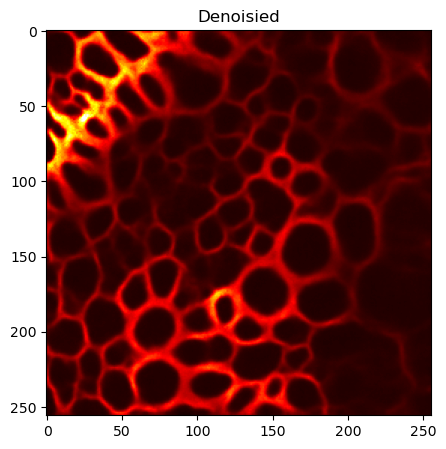

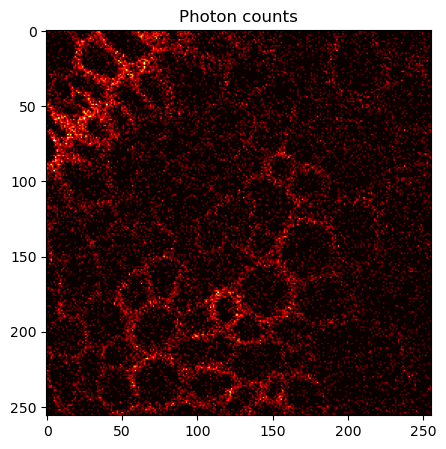

_______________________________________ 168
time (s): 2.0597124099731445 time per image (s) 2.0597124099731445


In [ ]:
import matplotlib.image as mpimg
import time
import numpy as np
from Inference import sample_image

# We are starting with an image containing zeros,
# i.e., sampling from scratch

# we just have 1 channel
channels = 1
# we can sample multiple images at the same time in a batch
batch_size = 1
# for best results this should correspond to training pach size
pixels_x = 256
pixels_y = 256

inp_img =  torch.zeros(batch_size ,channels, pixels_y, pixels_x).to(device)


for i in range(1):
    

    startTime = time.time()
    
    # sampling the image(s)
    #print(inp_img.shape)
    denoised, photons, stack, iterations = sample_imaging(inp_img,
                                                        model, 
                                                        beta = 0.05,
                                                        save_every_n = 10,
                                                        max_psnr = -5)

    
    # In case we do multiple images in a batch, we show all of them.
    for j in range(denoised.shape[0]):
            print(iterations)

            #print(denoised.shape)
            plt.figure(figsize = (5,5))
            plt.imshow(denoised[j,0], cmap='hot', vmin = 0,
                       vmax = np.percentile(denoised[j],99.99))
            plt.title('Denoisied')
            plt.show()
            
            plt.figure(figsize = (5,5))
            plt.imshow(photons[j,0], cmap='hot', vmin = 0,
                       vmax = np.percentile(photons[j],99.99))
            plt.title('Photon counts')
            plt.show()
            
            
    
    print('_______________________________________', iterations)
    
    endTime = time.time()
    elapsedTime = endTime - startTime
    print('time (s):', elapsedTime, 'time per image (s)', elapsedTime/denoised.shape[0])

0


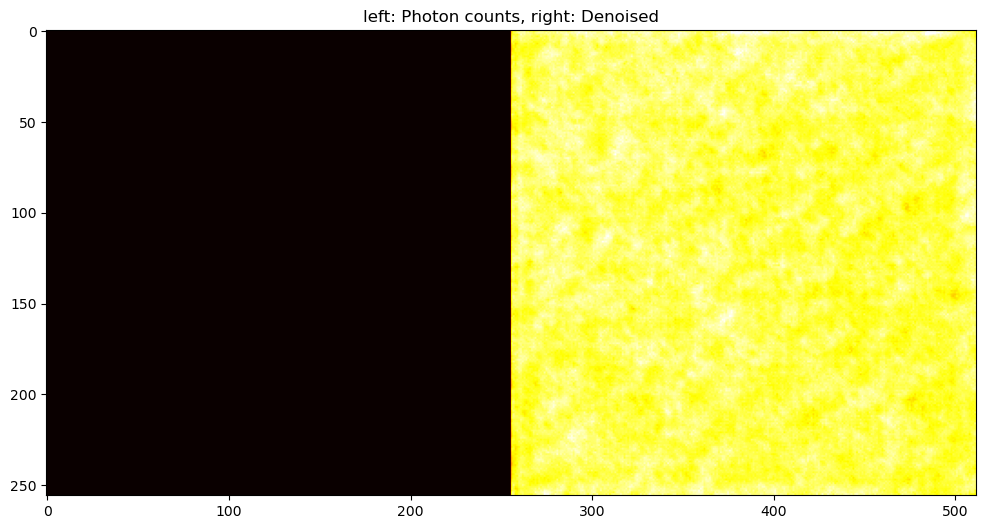

1


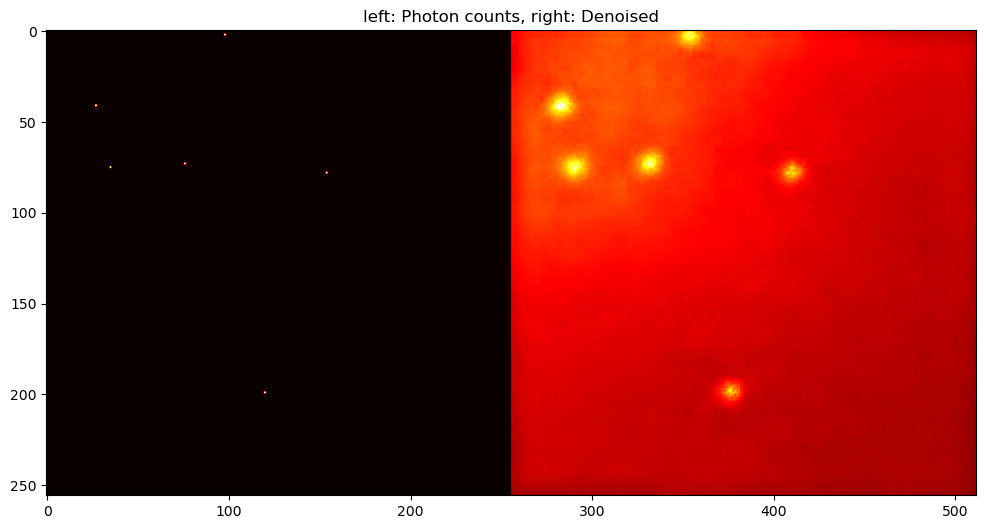

2


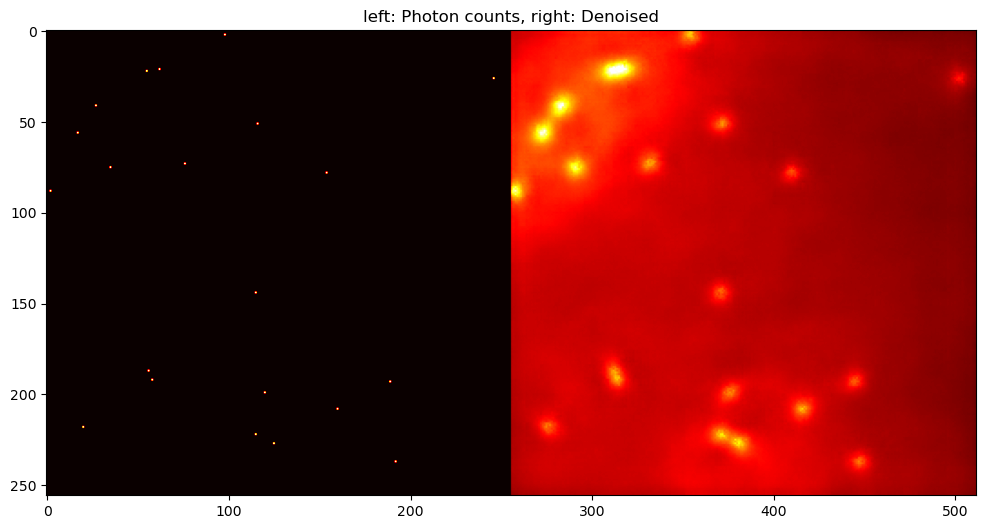

3


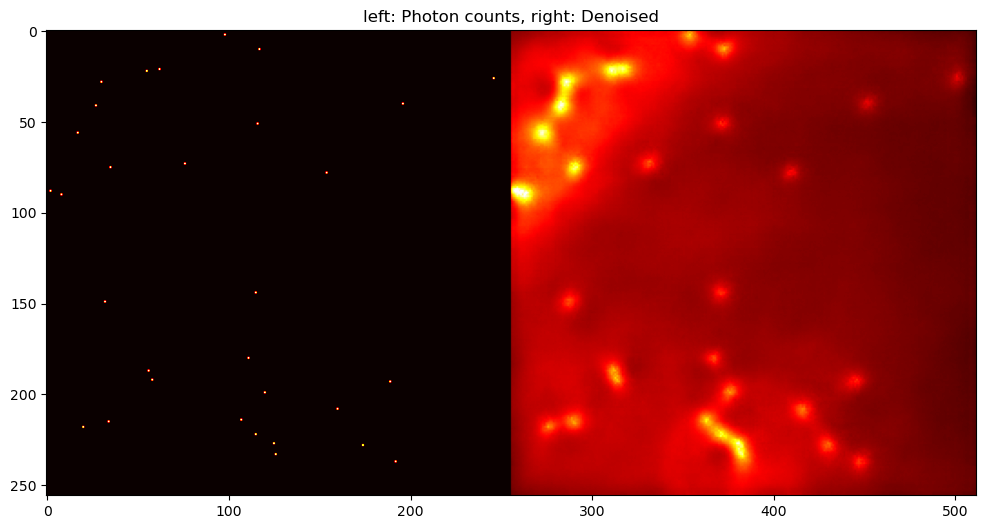

4


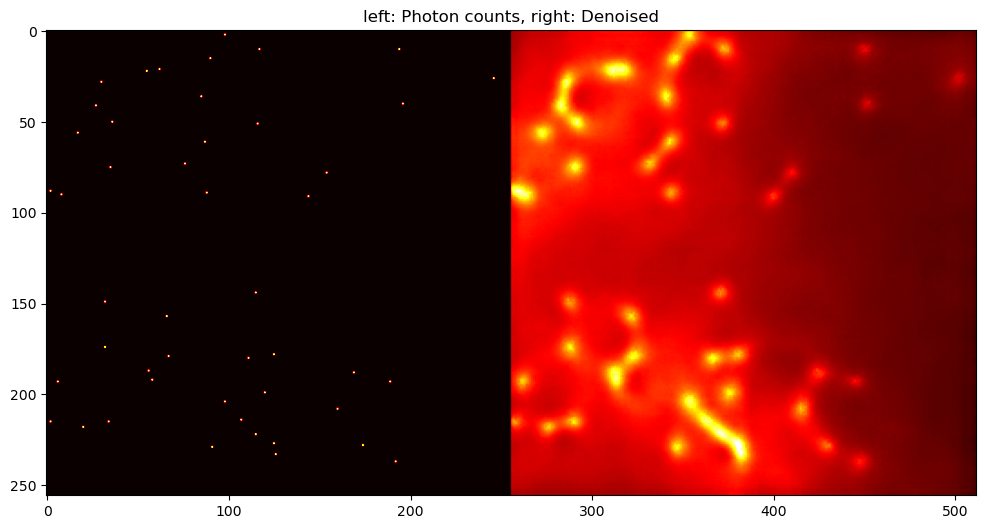

5


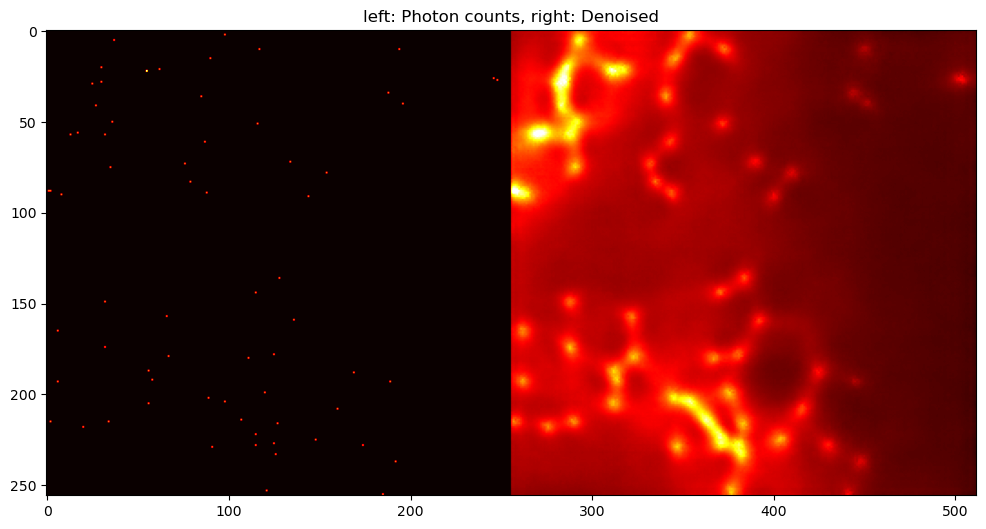

6


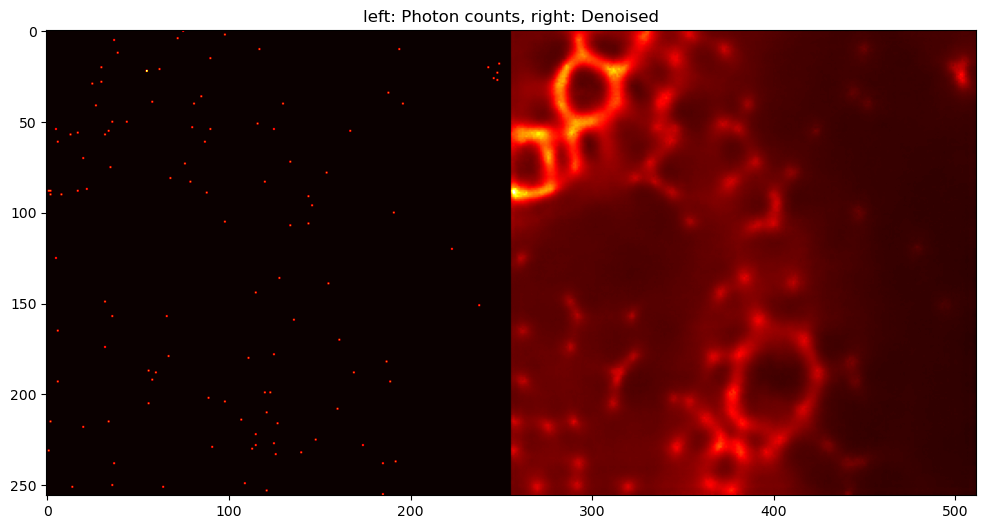

7


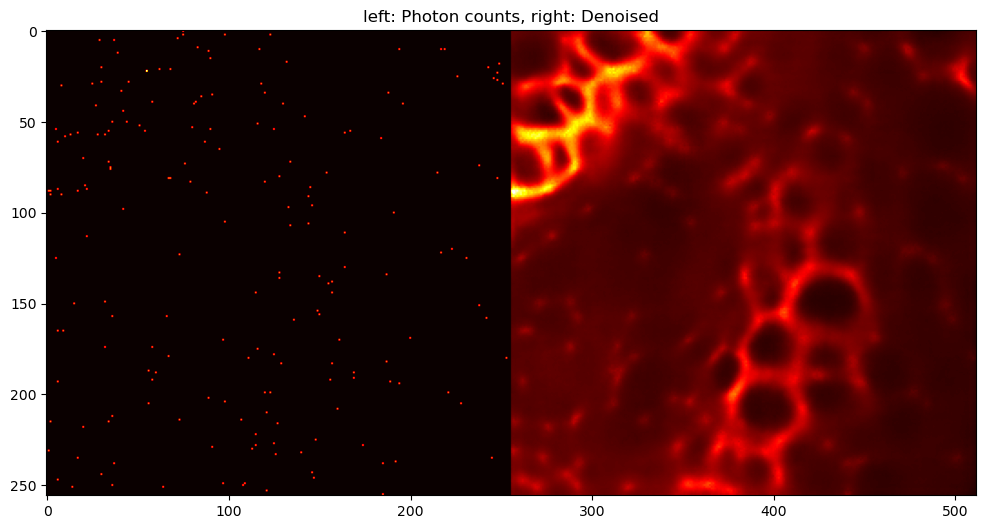

8


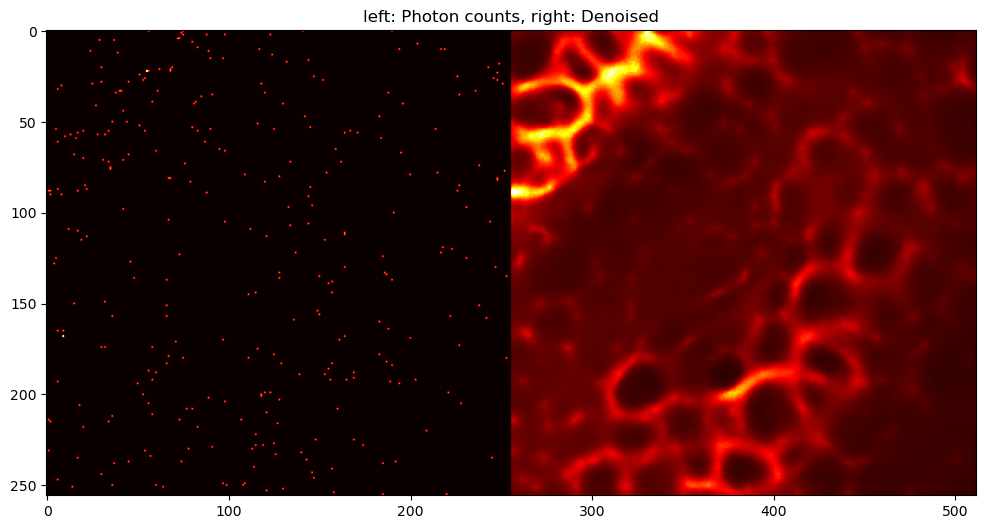

9


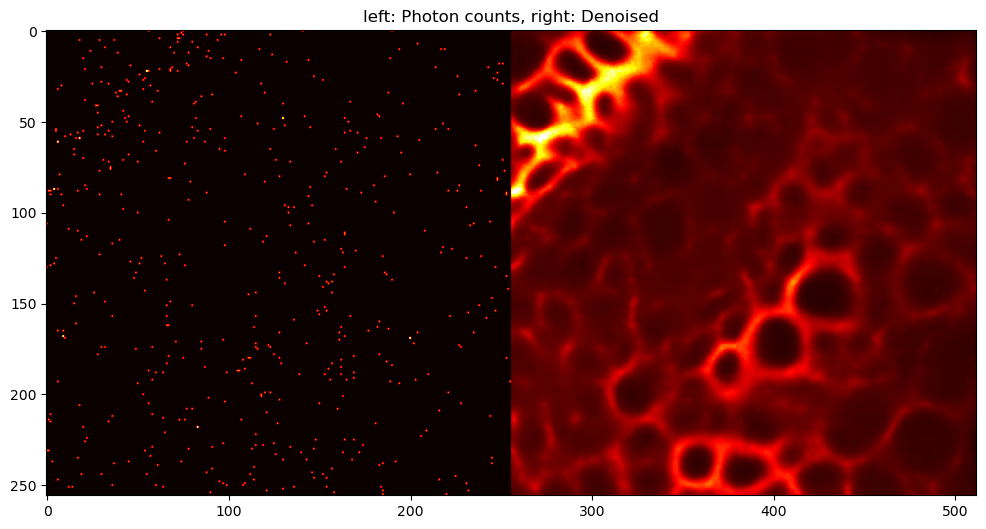

10


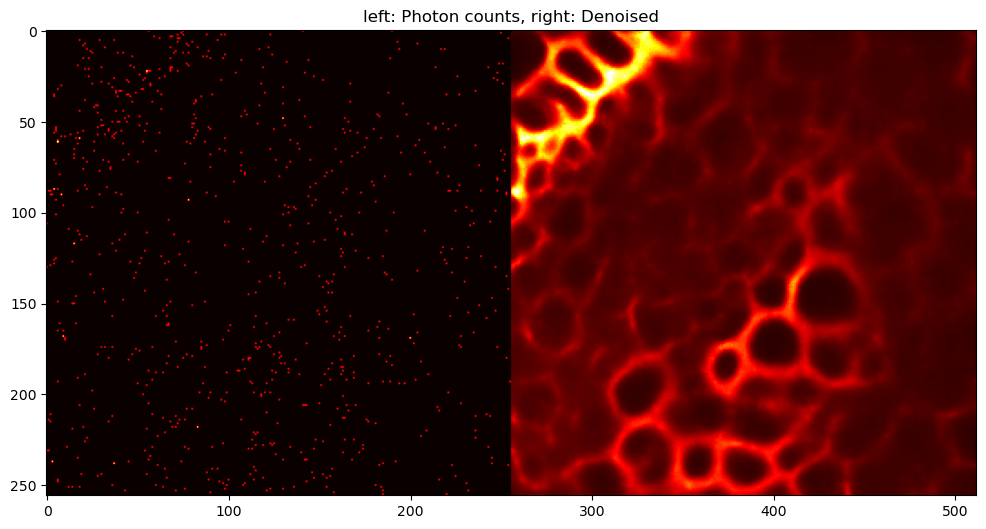

11


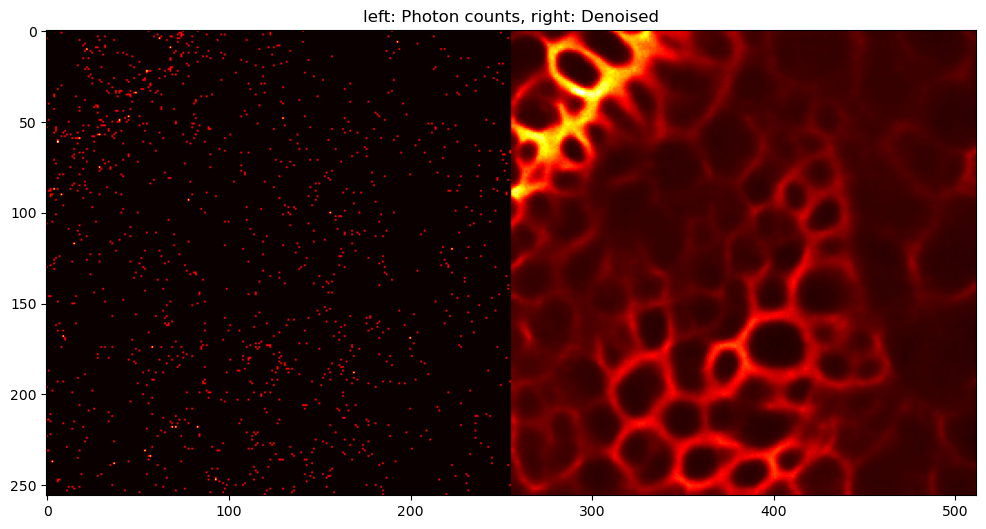

12


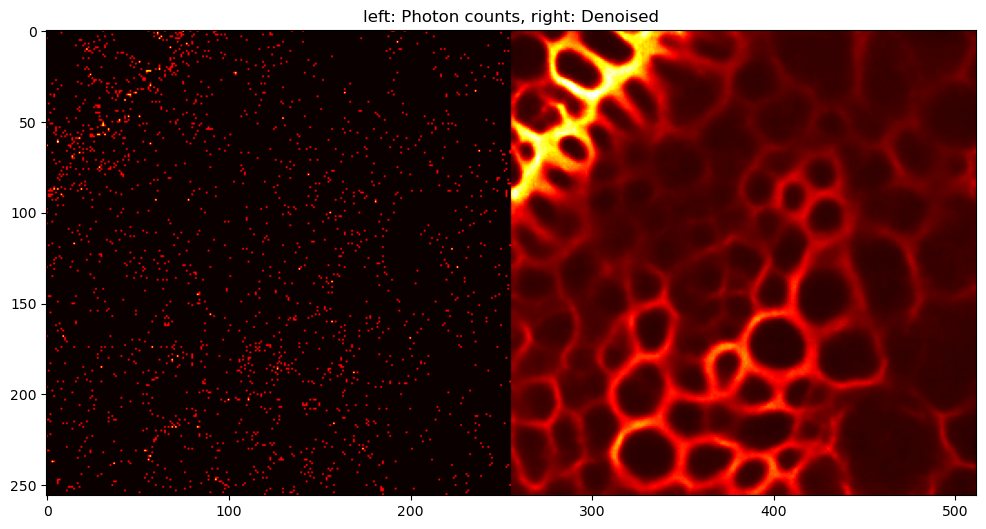

13


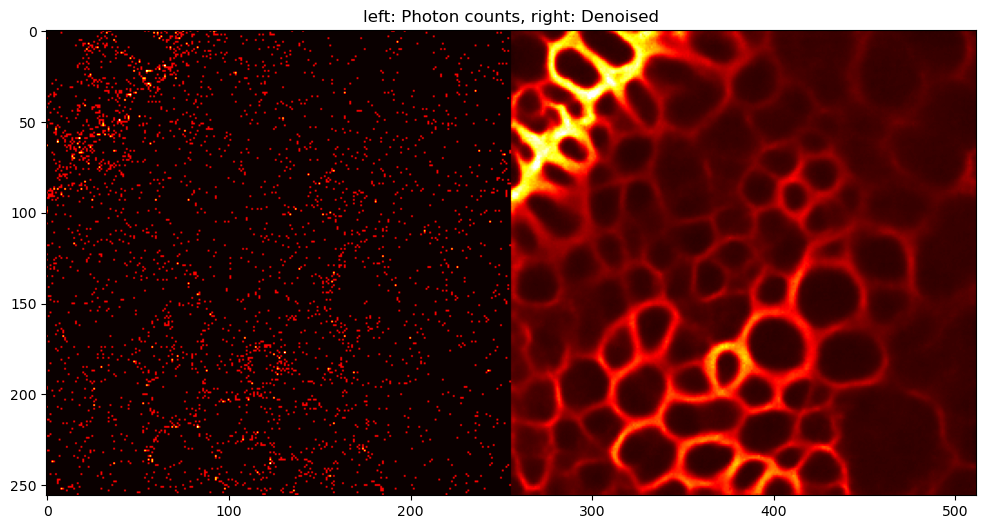

14


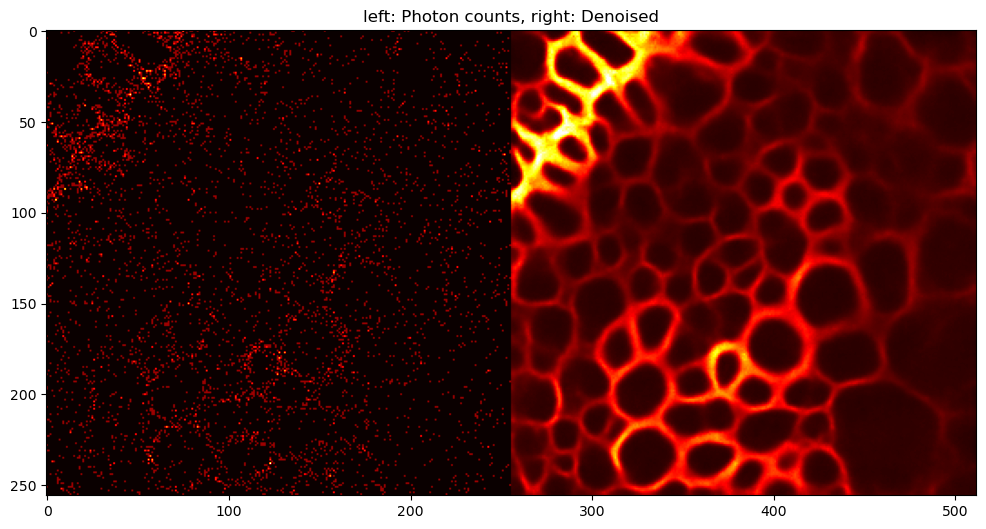

15


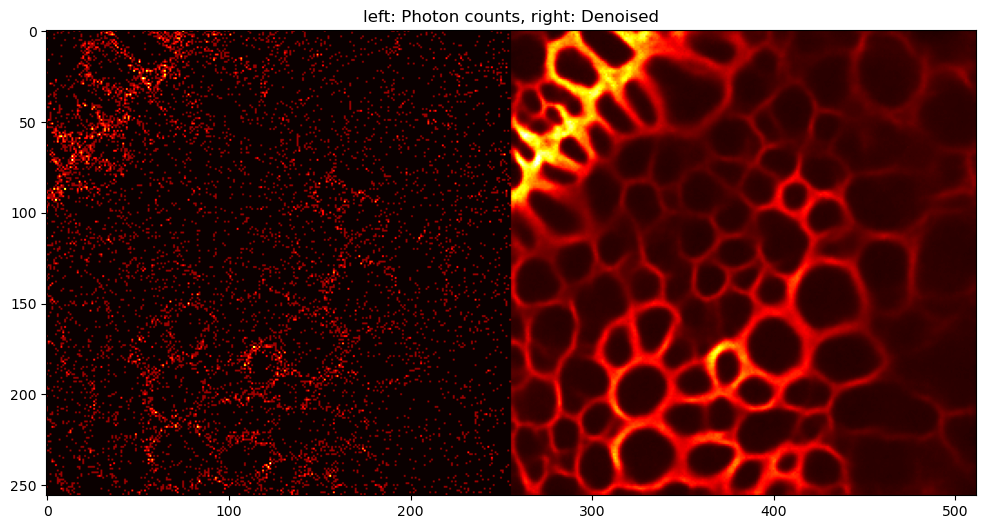

16


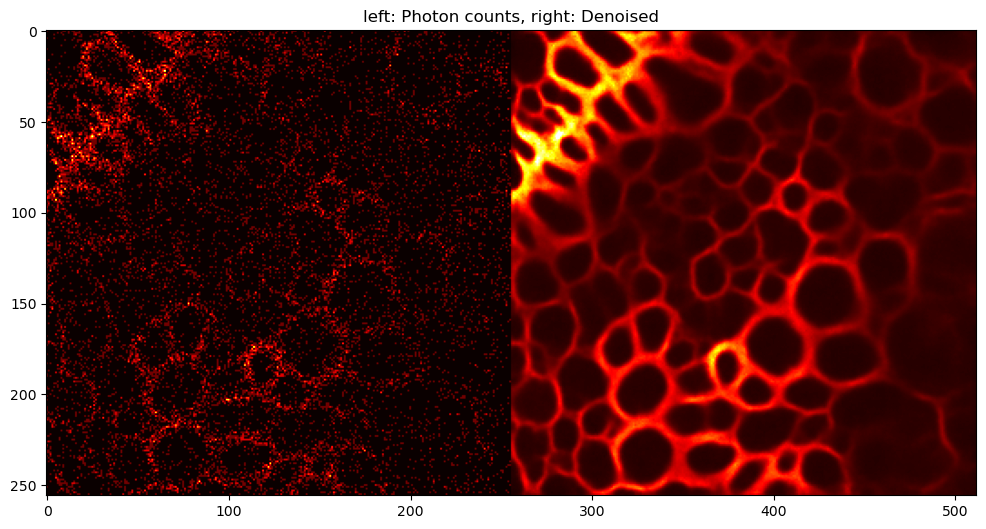

In [ ]:
stack[0].shape
for i in range(len(stack)):
    im = stack[i]
    print(i)
    plt.figure(figsize = (12,12))
    plt.imshow(im,cmap ='hot', vmax = 0.9)
    plt.title('left: Photon counts, right: Denoised')
    plt.show()

In [55]:
# Define the Attention Unet Model

# Define the Hyperparameters of the Model:
channels = 8
initial_channels = 4
levels = 10
depth = 6
n_heads = 16
dim_k = 64
reduction_factor = 4
num_groups = 4
dropout_rate = 0.40
time_channels = 64
bottleneck_factor = 2
units = 32
bottleneck_units = 64
conv_type = "ResidualDense_Block"
attn_type_list = [None, None, None, None, None, None, None]
merge_type = "add"
middle_attn_type = "VisionTransformer"
upsample_type = True
maxpsnr = -5.0
transpose = True
minpsnr = -40.0
num_timesteps = 1024
psnr_enabled = True
num_layers = 1
patch_size = 8
n_groups = 4
transformer_bottleneck = 64

# Define the Attention Network:
AttnUNet = AttentionUNet(
        initial_channels = initial_channels,
        channels = channels,
        levels=levels,
        depth=depth,
        n_heads = n_heads,
        dim_k = dim_k,
        dropout_rate = dropout_rate,
        time_channels = time_channels,
        bottleneck_factor = bottleneck_factor,
        units = units,
        bottleneck_units= bottleneck_units,
        conv_type = conv_type,
        attn_type_list = attn_type_list,
        merge_type = merge_type,
        maxpsnr = maxpsnr,
        minpsnr = minpsnr,
        num_timesteps = num_timesteps,
        reduction_factor = reduction_factor,
        num_groups = num_groups,
        middle_attn_type = middle_attn_type,
        upsample_type = upsample_type,
        psnr_enabled = psnr_enabled,
        n_groups =n_groups,
        num_layers = num_layers,
        patch_size = patch_size,
        transformer_bottleneck=transformer_bottleneck
        )


In [56]:
AttnUNet = AttnUNet.to(device)
AttnUNet

AttentionUNet(
  (Image_Projection): LazyConv2d(0, 4, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (Temporal_Embedding): Temporal_Embedder(
    (Linear_1): Linear(in_features=4, out_features=16, bias=True)
    (Linear_2): Linear(in_features=16, out_features=16, bias=True)
  )
  (input_norm): GroupNorm(4, 4, eps=1e-05, affine=True)
  (input_Swish): SiLU()
  (Final_Upsample): Up_Block(
    (Conv_Block): ResidualDense_Block(
      (time_embedding): Linear(in_features=16, out_features=12, bias=True)
      (conv1): Conv2d(4, 4, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (conv2): Conv2d(8, 4, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (conv3): Conv2d(12, 4, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (conv4): Conv2d(4, 4, kernel_size=(1, 1), stride=(1, 1))
      (conv5): Conv2d(16, 4, kernel_size=(1, 1), stride=(1, 1))
      (GroupNorm_1): GroupNorm(4, 4, eps=1e-05, affine=True)
      (GroupNorm_2): GroupNorm(4, 8, eps=1e-05, affine=True)
    

In [57]:
AttnUNet.forward(img_input.to(device), psnr_map.to(device).min()).shape

torch.Size([32, 1, 256, 256])

In [58]:
name = "AttentionUNet-256x256DenseTransformerNet"
CHECKPOINT_PATH = "./models/" 
Trainer = pl.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=maxepochs, 
                     callbacks=[ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_loss"),
                                LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience = 15)])
Trainer.fit(AttnUNet, Train_Loader, Validation_Loader)
Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name               | Type              | Params
----------------------------------------------------------
0  | Image_Projection   | Conv2d            | 364   
1  | Temporal_Embedding | Temporal_Embedder | 352   
2  | input_norm         | GroupNorm         | 8     
3  | input_Swish        | SiLU              | 0     
4  | Final_Upsample     | Up_Block          | 1.4 K 
5  | DownBlocks         | ModuleList        | 3.9 M 
6  | MiddleBlocks       | ModuleList        | 25.6 M
7  | UpBlocks           | ModuleList        | 1.5 M 
8  | output_norm        | GroupNorm         | 16    
9  | output_Swish       | SiLU              | 0     
10 | Output_Layer       | Conv2d            | 9     
----------------------------------------------------------
31.0 M    Trainable params
0         Non-trainable 

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=20` reached.


In [61]:
model = AttentionUNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

In [62]:
Trainer.test(model, Train_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    -0.2809946537017822    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.2809946537017822}]

In [64]:
Trainer.test(model, Validation_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.20264795422554016    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.20264795422554016}]

In [67]:
PSNR(out[0,0][:500,:500].detach().cpu().numpy(), gt[:500,:500], out[0,0][:500,:500].max().detach().cpu().numpy())

23.633544808505647

332 0 44.3373404001294 272.0 17.0


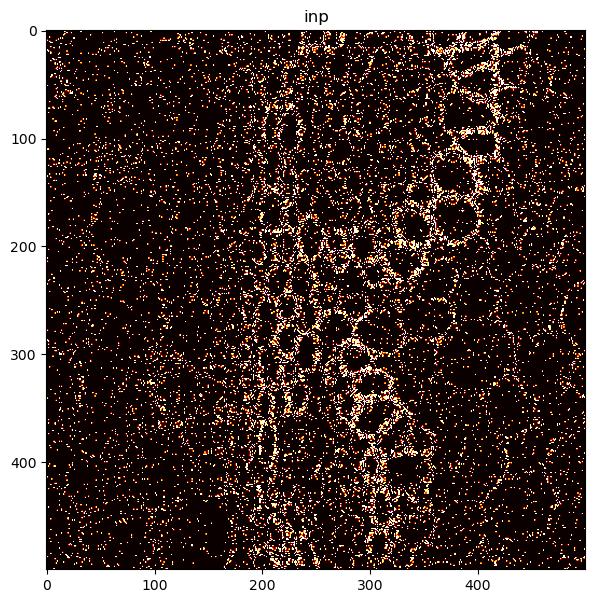

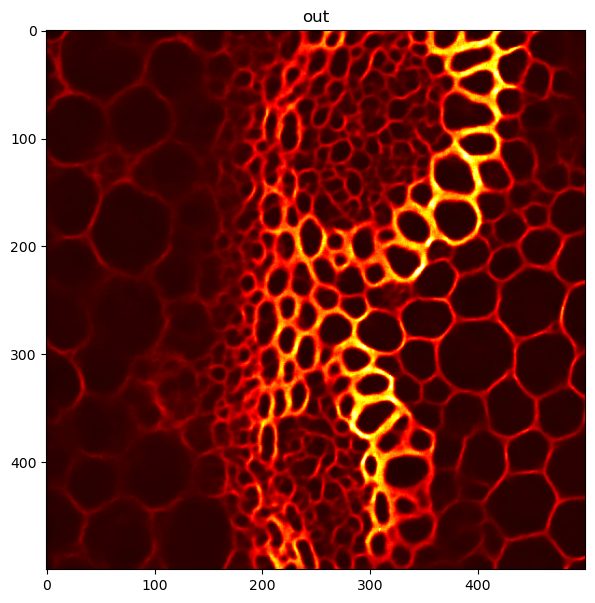

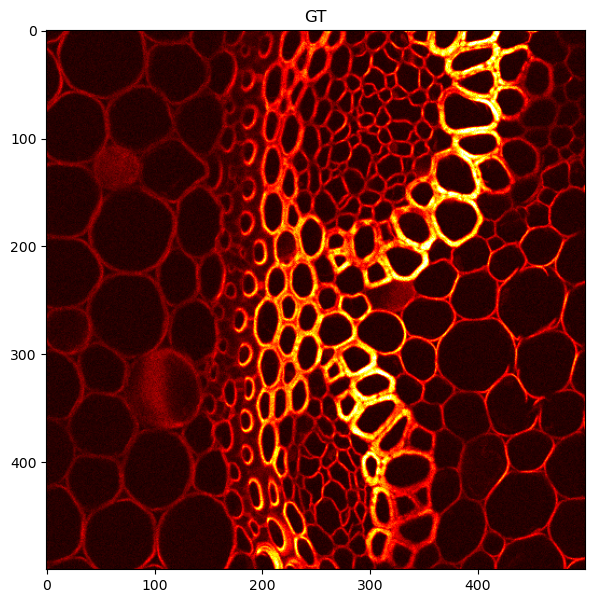

In [65]:
outputs = []
for inp, gt in zip(dataTest, dataTestGT):  
    inpT = torch.from_numpy(inp.astype(np.float32)).to(device)
    Psnr = np.log10(inpT.mean().item()+ 1e-50) *10
    Psnr = max(-40,Psnr)
    Psnr = torch.FloatTensor([Psnr]).to(device)
    Psnr_map = Psnr.unsqueeze(-1).expand(inpT.shape).type(torch.float32)
    model = model.to(device)
    # We have to apply softmax over pixels
    out = torch.exp(model(inpT[None,None,...], Psnr_map[None, None, ...].min()).detach().cpu())
    out = inp.sum() * out / out.sum()
    outputs.append(out.numpy()[0,0])
    
    print(gt.max(), gt.min(), gt.std(), np.percentile(gt,99.9), np.percentile(gt,50))
    
    inp = inp/inp.mean()
    out = out/out.mean()
    gt = gt/gt.mean()
    vmax = np.percentile(gt,99.9)
    
    plt.figure(figsize=(7,7))
    plt.imshow(inp[:500,:500],vmin = 0, vmax = vmax, cmap = "hot")
    plt.title('inp')
    plt.show()
    
    plt.figure(figsize=(7,7))
    plt.imshow(out[0,0][:500,:500],vmin = 0,vmax = vmax, cmap = "hot")
    plt.title('out')
    plt.show()
    
    plt.figure(figsize=(7,7))
    plt.imshow(gt[:500,:500],vmin = 0,vmax = vmax, cmap = "hot")
    plt.title('GT')

157


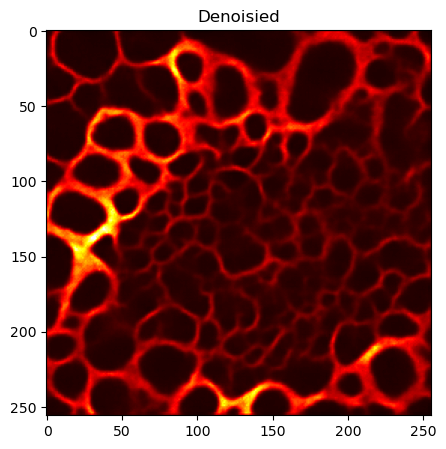

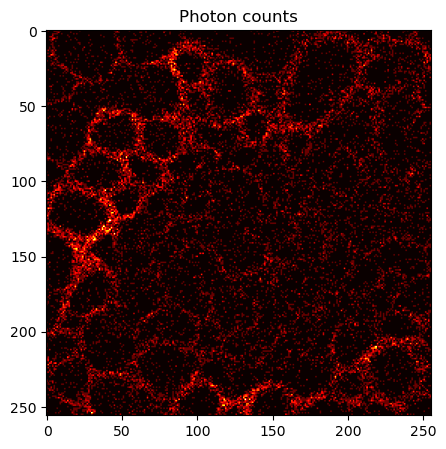

_______________________________________ 157
time (s): 2.875645875930786 time per image (s) 2.875645875930786


In [68]:
import matplotlib.image as mpimg
import time
import numpy as np
from Inference import sample_image

# We are starting with an image containing zeros,
# i.e., sampling from scratch

# we just have 1 channel
channels = 1
# we can sample multiple images at the same time in a batch
batch_size = 1
# for best results this should correspond to training pach size
pixels_x = 256
pixels_y = 256

inp_img =  torch.zeros(batch_size ,channels, pixels_y, pixels_x).to(device)


for i in range(1):
    

    startTime = time.time()
    
    # sampling the image(s)
    #print(inp_img.shape)
    denoised, photons, stack, iterations = sample_imaging(inp_img,
                                                        model, 
                                                        beta = 0.05,
                                                        save_every_n = 10,
                                                        max_psnr = -5)

    
    # In case we do multiple images in a batch, we show all of them.
    for j in range(denoised.shape[0]):
            print(iterations)

            #print(denoised.shape)
            plt.figure(figsize = (5,5))
            plt.imshow(denoised[j,0], cmap='hot', vmin = 0,
                       vmax = np.percentile(denoised[j],99.99))
            plt.title('Denoisied')
            plt.show()
            
            plt.figure(figsize = (5,5))
            plt.imshow(photons[j,0], cmap='hot', vmin = 0,
                       vmax = np.percentile(photons[j],99.99))
            plt.title('Photon counts')
            plt.show()
            
            
    
    print('_______________________________________', iterations)
    
    endTime = time.time()
    elapsedTime = endTime - startTime
    print('time (s):', elapsedTime, 'time per image (s)', elapsedTime/denoised.shape[0])

0


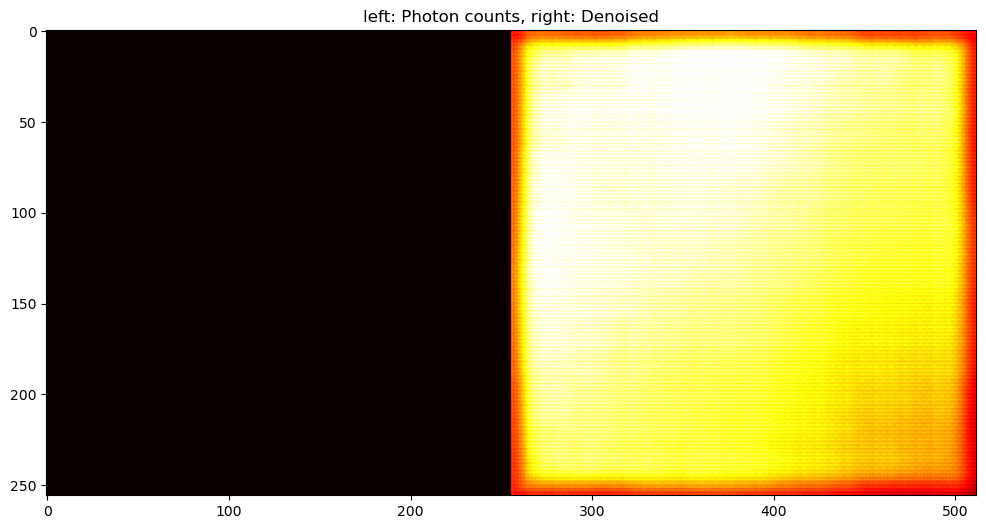

1


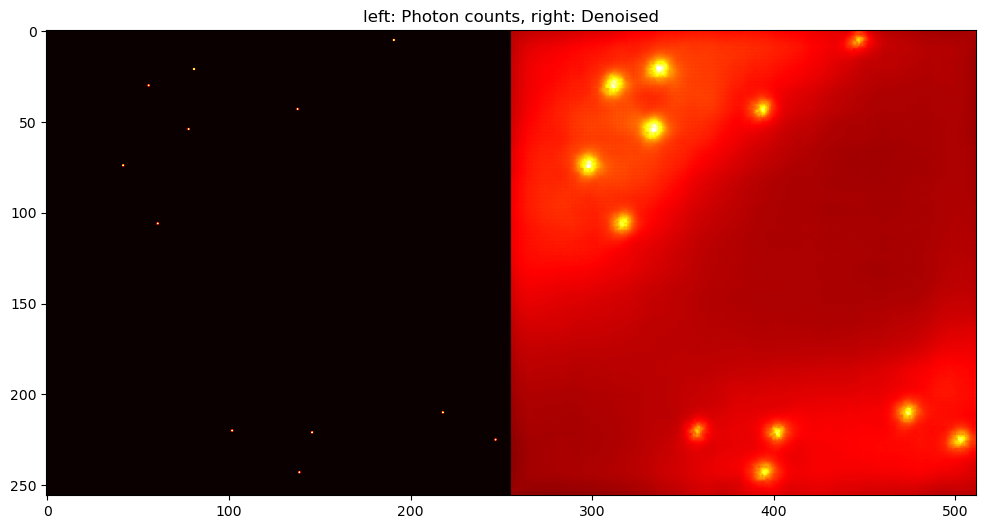

2


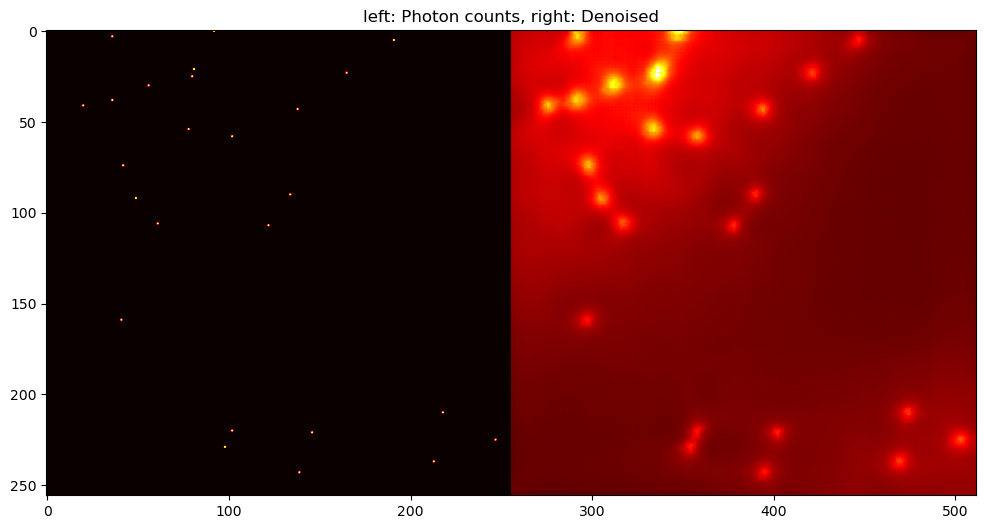

3


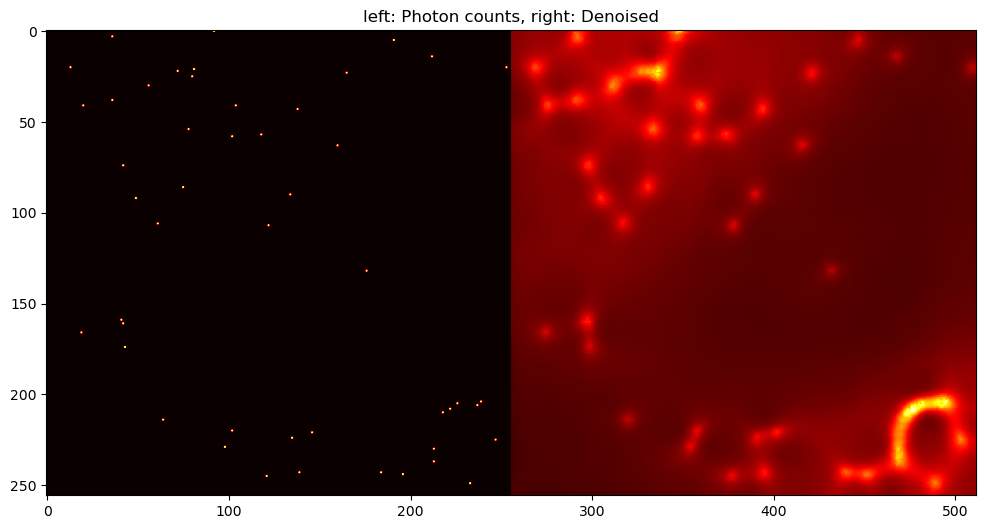

4


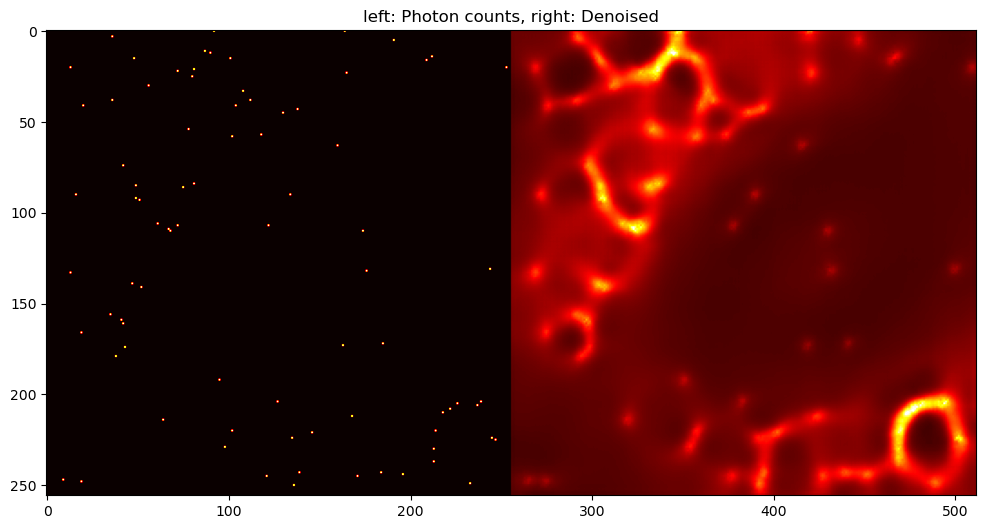

5


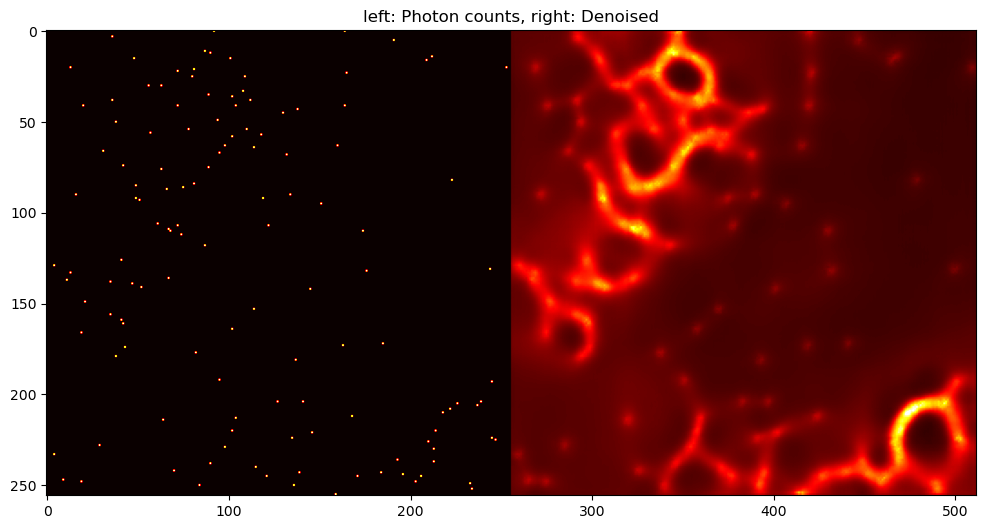

6


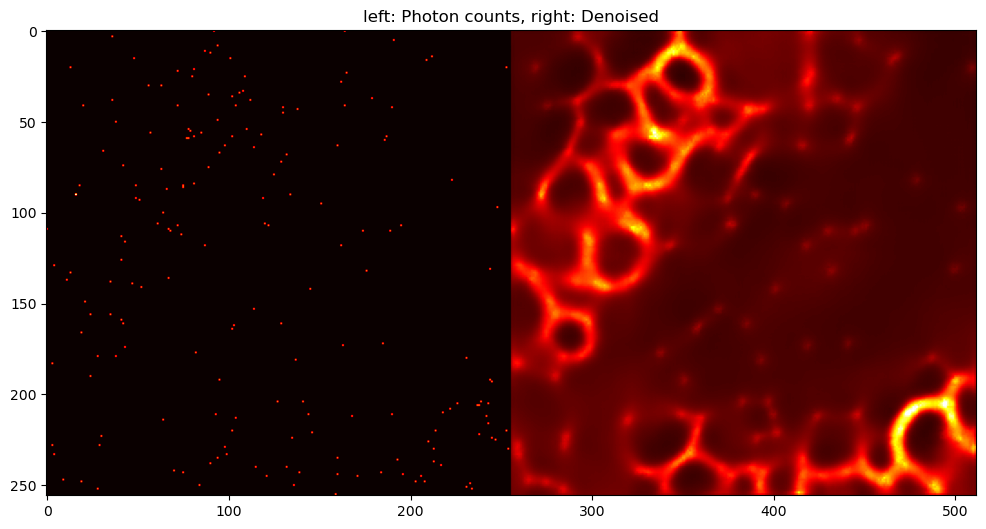

7


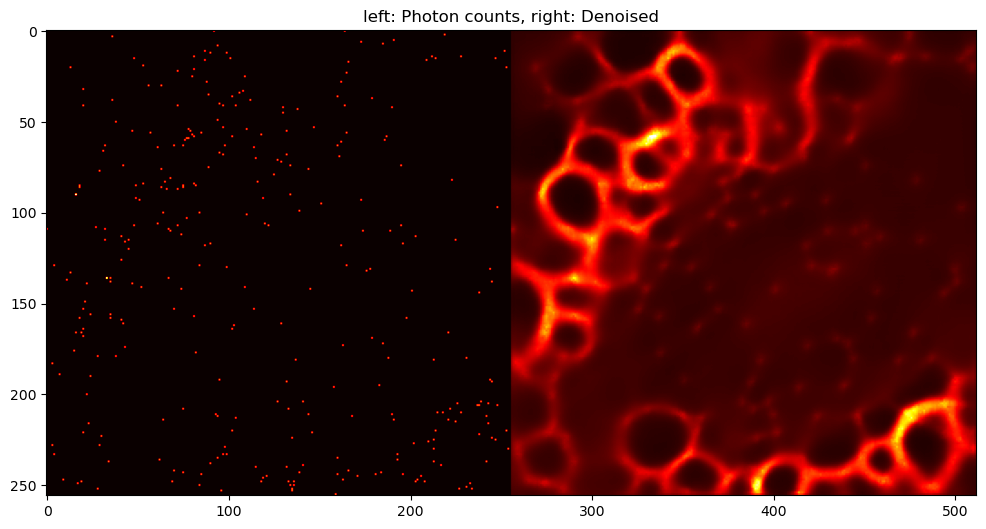

8


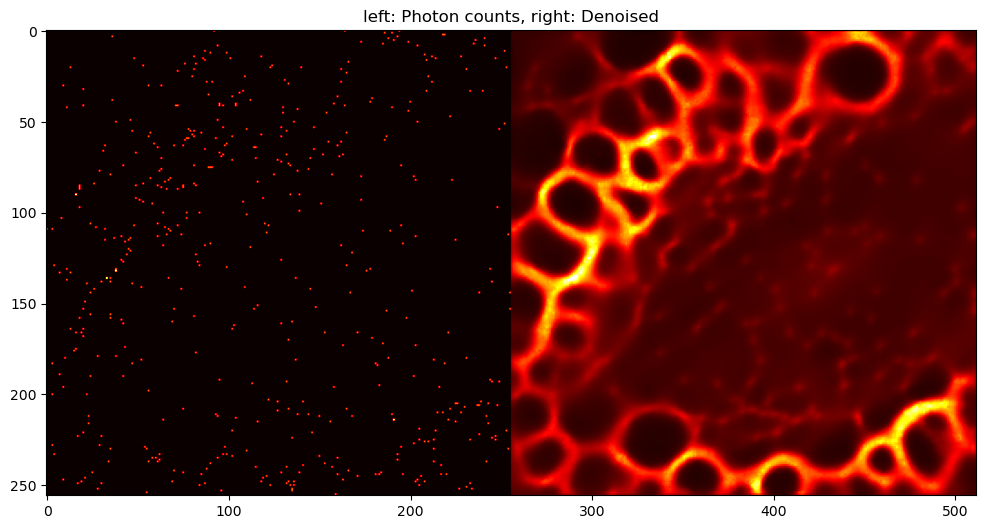

9


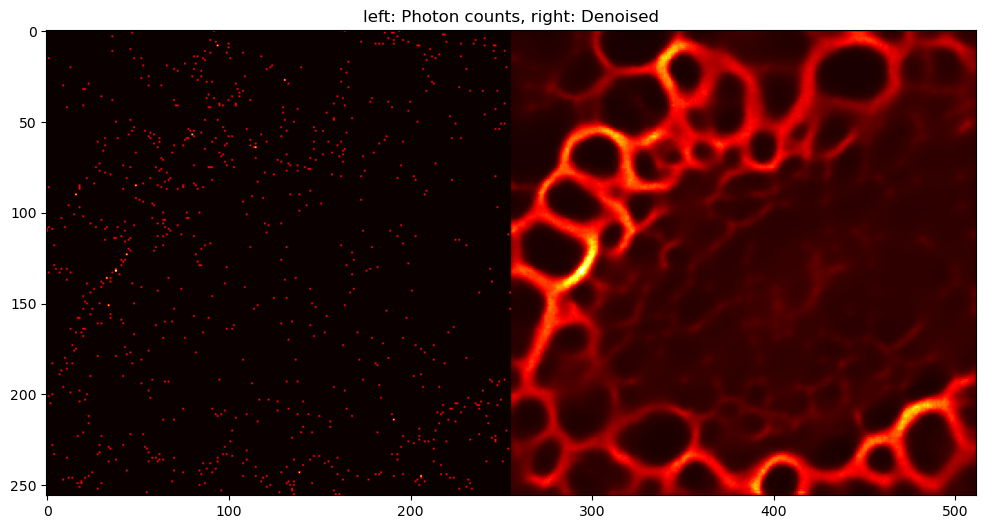

10


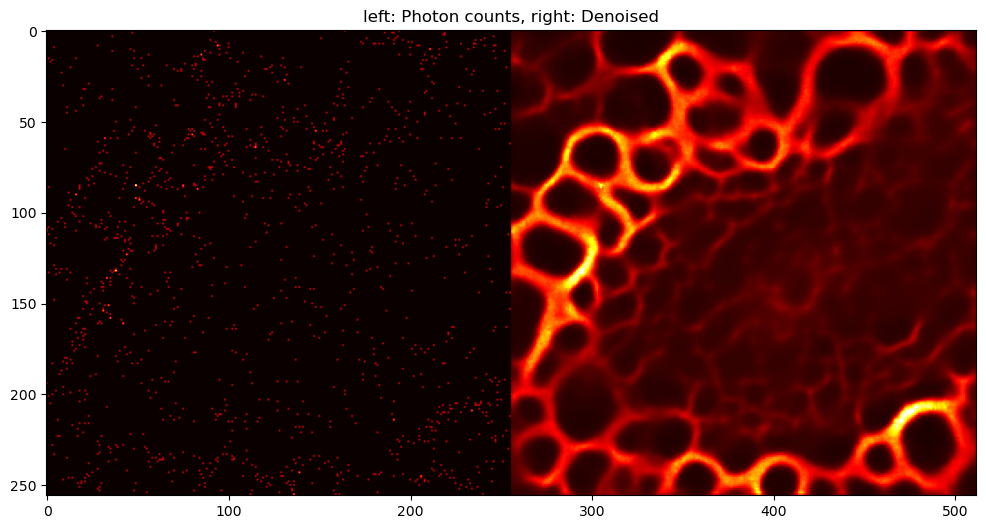

11


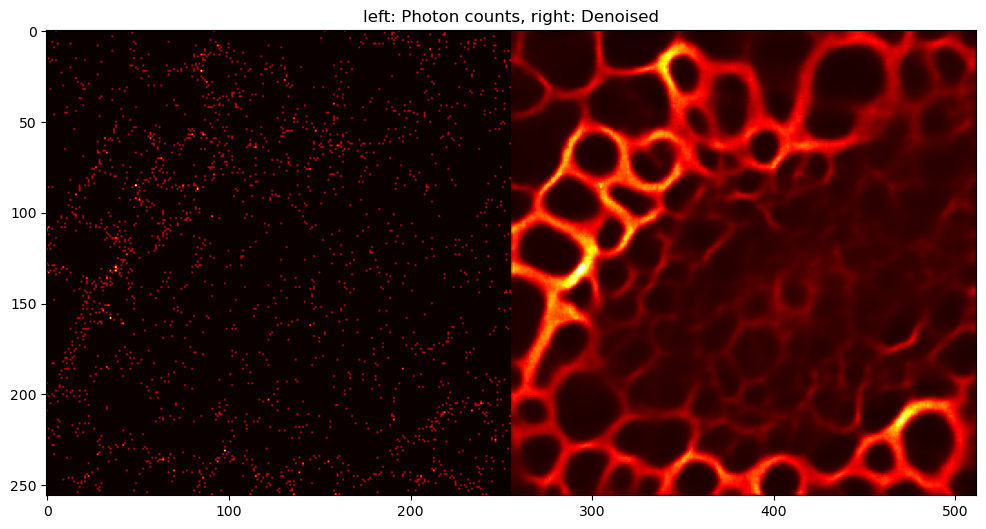

12


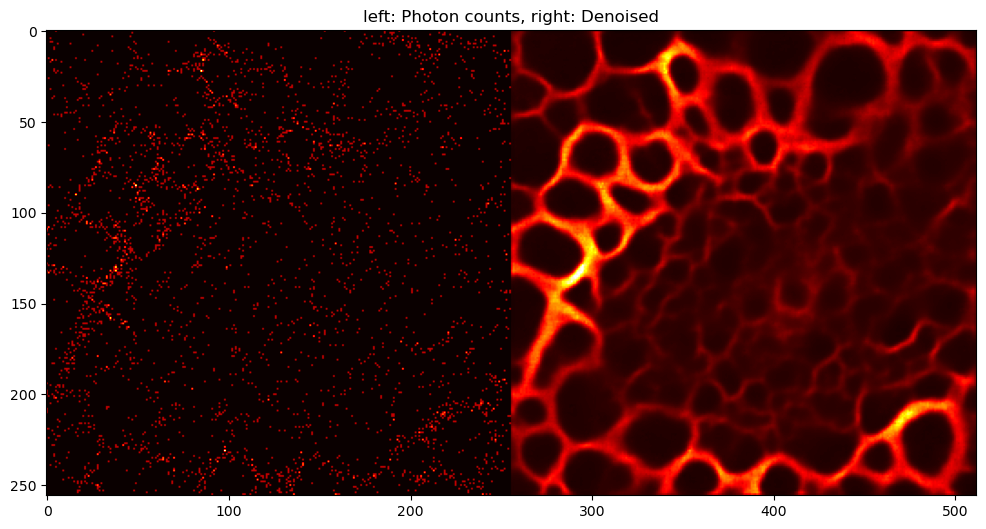

13


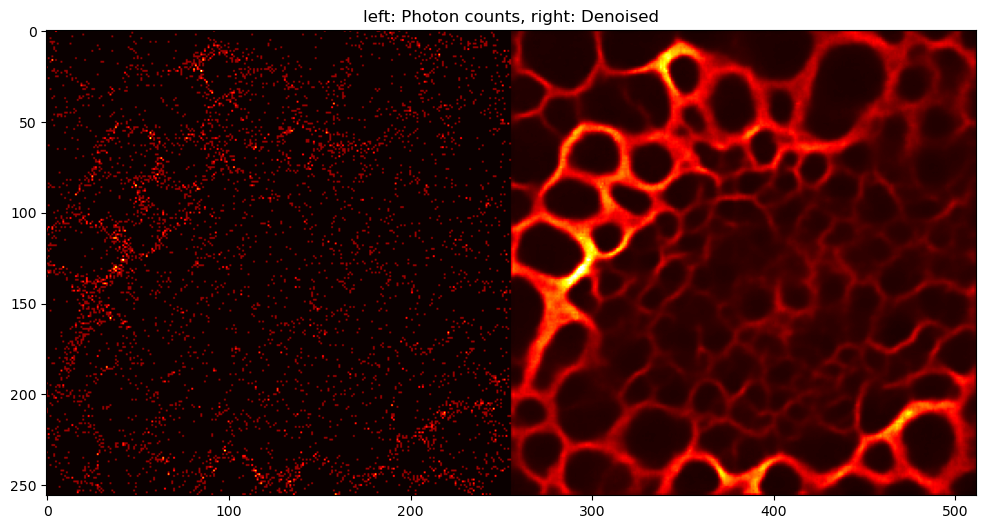

14


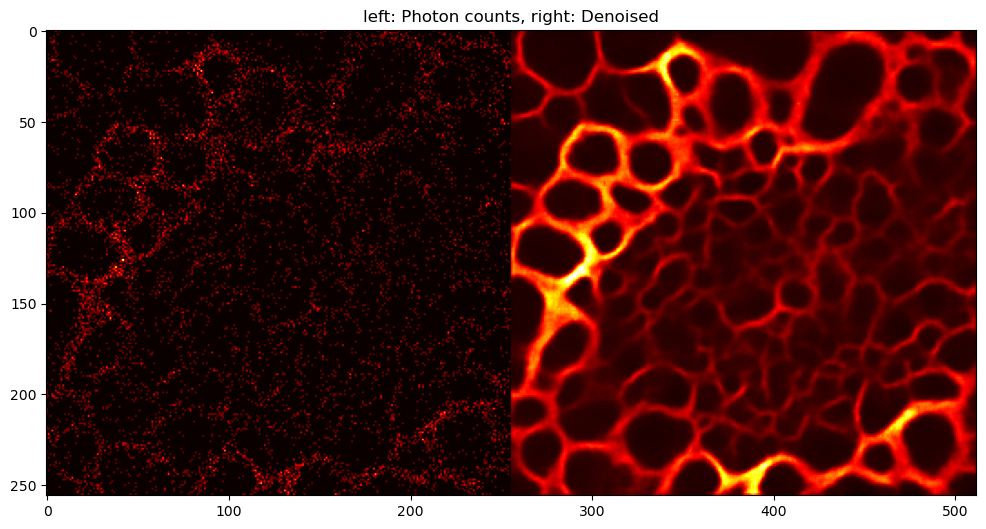

15


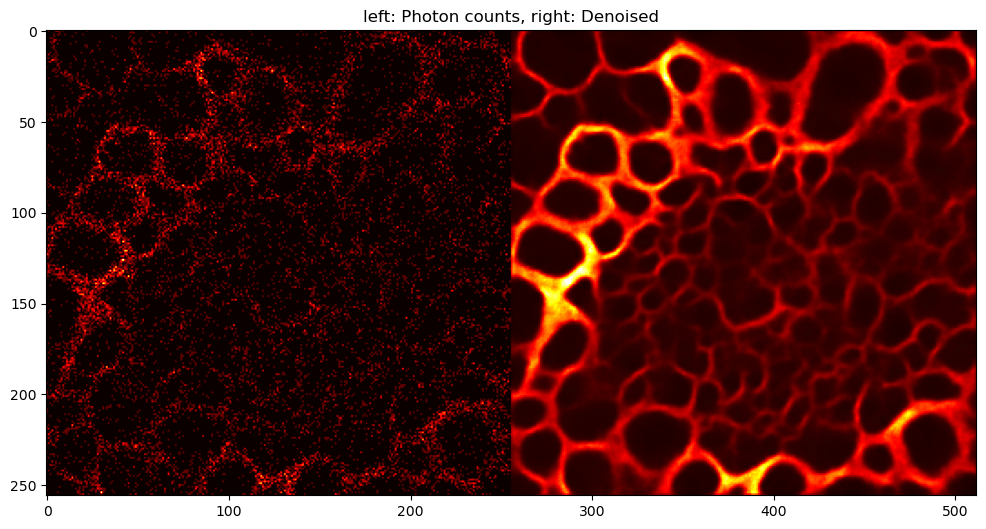

In [69]:
stack[0].shape
for i in range(len(stack)):
    im = stack[i]
    print(i)
    plt.figure(figsize = (12,12))
    plt.imshow(im,cmap ='hot', vmax = 0.9)
    plt.title('left: Photon counts, right: Denoised')
    plt.show()